# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

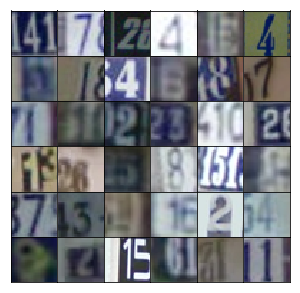

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), self.scaler(y)

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stack layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU. 

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x32
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, 0.5)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an errror without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very senstive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.0362... Generator Loss: 1.1972
Epoch 1/25... Discriminator Loss: 0.3108... Generator Loss: 2.8994
Epoch 1/25... Discriminator Loss: 0.2792... Generator Loss: 1.8139
Epoch 1/25... Discriminator Loss: 0.1485... Generator Loss: 2.7881
Epoch 1/25... Discriminator Loss: 0.1908... Generator Loss: 2.7875
Epoch 1/25... Discriminator Loss: 0.1169... Generator Loss: 2.9929
Epoch 1/25... Discriminator Loss: 0.2180... Generator Loss: 3.0495
Epoch 1/25... Discriminator Loss: 0.0962... Generator Loss: 3.4992
Epoch 1/25... Discriminator Loss: 0.1752... Generator Loss: 3.3276
Epoch 1/25... Discriminator Loss: 0.2128... Generator Loss: 3.2291


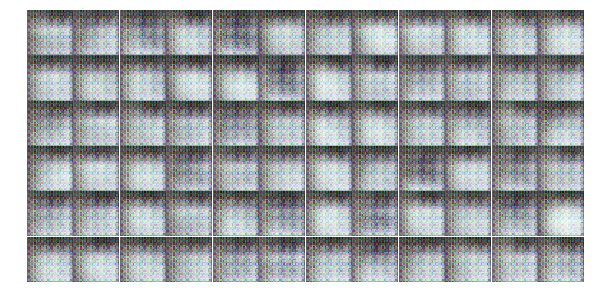

Epoch 1/25... Discriminator Loss: 1.2520... Generator Loss: 2.5031
Epoch 1/25... Discriminator Loss: 0.7062... Generator Loss: 1.2866
Epoch 1/25... Discriminator Loss: 0.5468... Generator Loss: 1.7109
Epoch 1/25... Discriminator Loss: 0.2785... Generator Loss: 2.7208
Epoch 1/25... Discriminator Loss: 0.8952... Generator Loss: 0.7372
Epoch 1/25... Discriminator Loss: 0.2953... Generator Loss: 2.5525
Epoch 1/25... Discriminator Loss: 0.2670... Generator Loss: 2.5096
Epoch 1/25... Discriminator Loss: 0.2723... Generator Loss: 3.4360
Epoch 1/25... Discriminator Loss: 0.3944... Generator Loss: 1.8932
Epoch 1/25... Discriminator Loss: 0.4590... Generator Loss: 1.3283


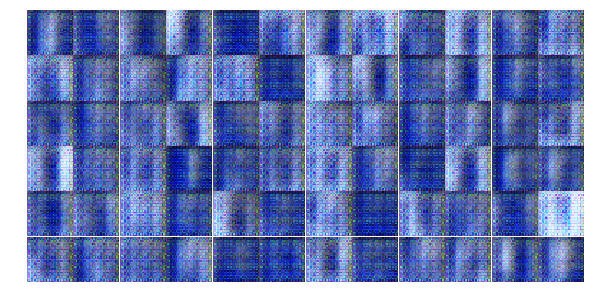

Epoch 1/25... Discriminator Loss: 1.7209... Generator Loss: 0.3271
Epoch 1/25... Discriminator Loss: 0.4185... Generator Loss: 1.7180
Epoch 1/25... Discriminator Loss: 0.5433... Generator Loss: 1.2075
Epoch 1/25... Discriminator Loss: 0.2065... Generator Loss: 2.7086
Epoch 1/25... Discriminator Loss: 0.6549... Generator Loss: 3.4592
Epoch 1/25... Discriminator Loss: 0.4669... Generator Loss: 1.4978
Epoch 1/25... Discriminator Loss: 0.2199... Generator Loss: 2.6991
Epoch 1/25... Discriminator Loss: 1.1469... Generator Loss: 0.6688
Epoch 1/25... Discriminator Loss: 0.6035... Generator Loss: 2.7562
Epoch 1/25... Discriminator Loss: 0.8488... Generator Loss: 1.8687


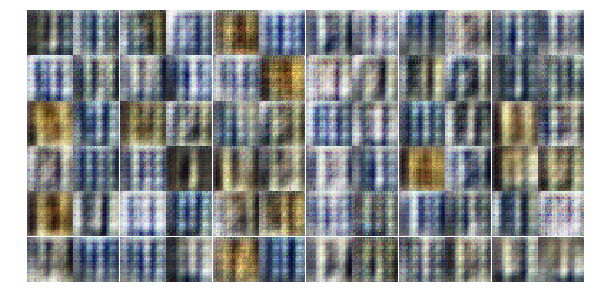

Epoch 1/25... Discriminator Loss: 1.1226... Generator Loss: 0.9331
Epoch 1/25... Discriminator Loss: 0.5667... Generator Loss: 1.5193
Epoch 1/25... Discriminator Loss: 0.3203... Generator Loss: 2.2702
Epoch 1/25... Discriminator Loss: 0.5962... Generator Loss: 1.3702
Epoch 1/25... Discriminator Loss: 0.7915... Generator Loss: 1.3232
Epoch 1/25... Discriminator Loss: 0.3174... Generator Loss: 2.2007
Epoch 1/25... Discriminator Loss: 0.4158... Generator Loss: 1.9960
Epoch 1/25... Discriminator Loss: 0.2783... Generator Loss: 2.1251
Epoch 1/25... Discriminator Loss: 0.4094... Generator Loss: 2.0039
Epoch 1/25... Discriminator Loss: 0.8542... Generator Loss: 1.1004


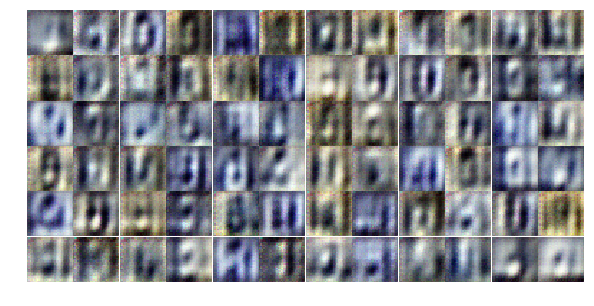

Epoch 1/25... Discriminator Loss: 0.4580... Generator Loss: 1.8623
Epoch 1/25... Discriminator Loss: 0.3210... Generator Loss: 1.9226
Epoch 1/25... Discriminator Loss: 0.3440... Generator Loss: 2.0910
Epoch 1/25... Discriminator Loss: 0.2123... Generator Loss: 3.0943
Epoch 1/25... Discriminator Loss: 0.3063... Generator Loss: 2.1940
Epoch 1/25... Discriminator Loss: 0.8963... Generator Loss: 4.0489
Epoch 1/25... Discriminator Loss: 0.6324... Generator Loss: 1.3955
Epoch 1/25... Discriminator Loss: 0.9592... Generator Loss: 0.8218
Epoch 1/25... Discriminator Loss: 0.3231... Generator Loss: 2.1606
Epoch 1/25... Discriminator Loss: 0.5133... Generator Loss: 1.9156


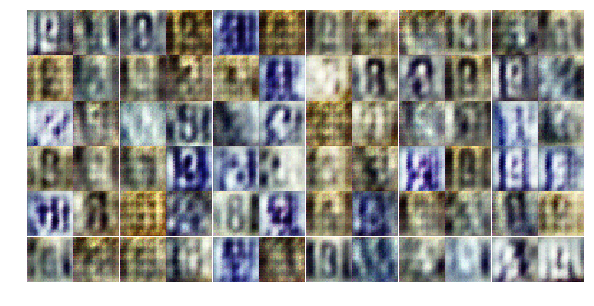

Epoch 1/25... Discriminator Loss: 0.8127... Generator Loss: 1.1871
Epoch 1/25... Discriminator Loss: 1.1914... Generator Loss: 0.7400
Epoch 1/25... Discriminator Loss: 0.6009... Generator Loss: 2.5134
Epoch 1/25... Discriminator Loss: 0.6187... Generator Loss: 1.1916
Epoch 1/25... Discriminator Loss: 0.5299... Generator Loss: 1.3308
Epoch 1/25... Discriminator Loss: 0.4675... Generator Loss: 1.3440
Epoch 1/25... Discriminator Loss: 0.4149... Generator Loss: 1.9651
Epoch 2/25... Discriminator Loss: 0.9058... Generator Loss: 1.1373
Epoch 2/25... Discriminator Loss: 0.2576... Generator Loss: 2.8731
Epoch 2/25... Discriminator Loss: 0.4266... Generator Loss: 2.3575


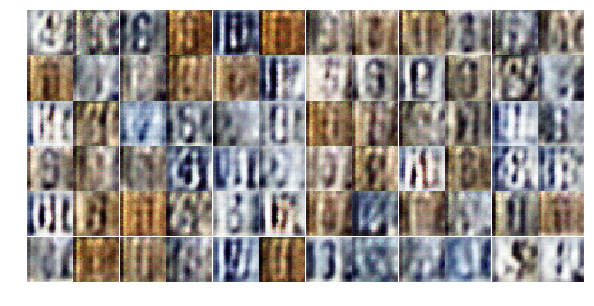

Epoch 2/25... Discriminator Loss: 0.1824... Generator Loss: 2.8610
Epoch 2/25... Discriminator Loss: 0.6344... Generator Loss: 2.6144
Epoch 2/25... Discriminator Loss: 1.3109... Generator Loss: 0.6439
Epoch 2/25... Discriminator Loss: 0.4982... Generator Loss: 2.2512
Epoch 2/25... Discriminator Loss: 1.6077... Generator Loss: 0.3415
Epoch 2/25... Discriminator Loss: 0.5629... Generator Loss: 1.5230
Epoch 2/25... Discriminator Loss: 1.4429... Generator Loss: 0.4527
Epoch 2/25... Discriminator Loss: 1.0235... Generator Loss: 0.9185
Epoch 2/25... Discriminator Loss: 0.7647... Generator Loss: 1.0599
Epoch 2/25... Discriminator Loss: 0.9028... Generator Loss: 0.8360


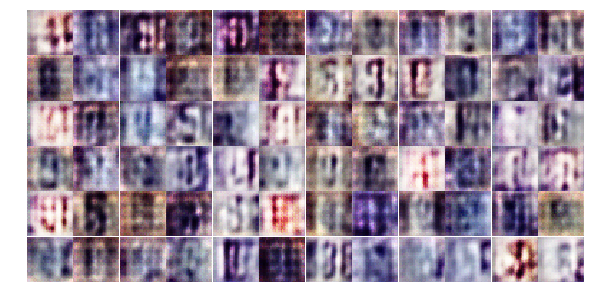

Epoch 2/25... Discriminator Loss: 1.0940... Generator Loss: 2.1373
Epoch 2/25... Discriminator Loss: 0.5323... Generator Loss: 2.1004
Epoch 2/25... Discriminator Loss: 1.2476... Generator Loss: 2.4853
Epoch 2/25... Discriminator Loss: 0.6543... Generator Loss: 1.3741
Epoch 2/25... Discriminator Loss: 1.2613... Generator Loss: 2.8453
Epoch 2/25... Discriminator Loss: 1.0601... Generator Loss: 0.7734
Epoch 2/25... Discriminator Loss: 0.6812... Generator Loss: 1.4024
Epoch 2/25... Discriminator Loss: 0.7103... Generator Loss: 1.6291
Epoch 2/25... Discriminator Loss: 0.5214... Generator Loss: 2.0178
Epoch 2/25... Discriminator Loss: 1.4618... Generator Loss: 0.4890


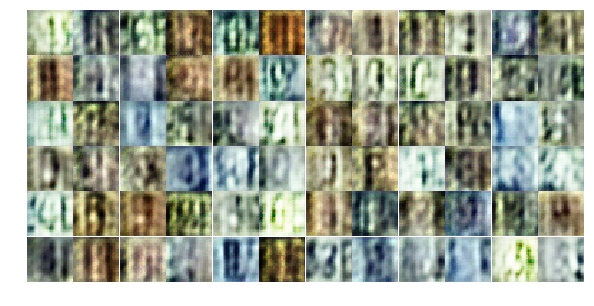

Epoch 2/25... Discriminator Loss: 0.6479... Generator Loss: 1.1448
Epoch 2/25... Discriminator Loss: 0.8114... Generator Loss: 1.6278
Epoch 2/25... Discriminator Loss: 0.6489... Generator Loss: 1.2166
Epoch 2/25... Discriminator Loss: 0.8948... Generator Loss: 0.8723
Epoch 2/25... Discriminator Loss: 1.0751... Generator Loss: 2.0652
Epoch 2/25... Discriminator Loss: 0.9900... Generator Loss: 0.9230
Epoch 2/25... Discriminator Loss: 0.7761... Generator Loss: 1.0358
Epoch 2/25... Discriminator Loss: 1.2192... Generator Loss: 2.1463
Epoch 2/25... Discriminator Loss: 1.0206... Generator Loss: 1.0196
Epoch 2/25... Discriminator Loss: 0.9268... Generator Loss: 0.9700


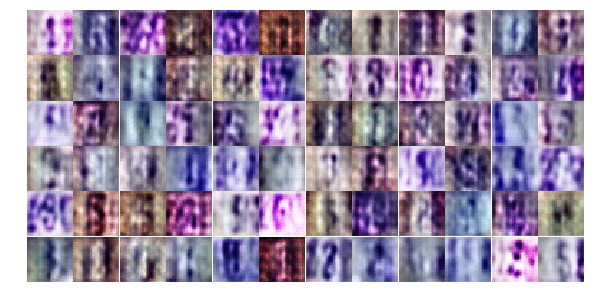

Epoch 2/25... Discriminator Loss: 1.7717... Generator Loss: 0.3290
Epoch 2/25... Discriminator Loss: 1.0667... Generator Loss: 1.1089
Epoch 2/25... Discriminator Loss: 0.9852... Generator Loss: 1.2500
Epoch 2/25... Discriminator Loss: 0.9880... Generator Loss: 0.9105
Epoch 2/25... Discriminator Loss: 0.8041... Generator Loss: 2.0392
Epoch 2/25... Discriminator Loss: 0.9011... Generator Loss: 1.5523
Epoch 2/25... Discriminator Loss: 1.2261... Generator Loss: 0.9248
Epoch 2/25... Discriminator Loss: 0.9934... Generator Loss: 1.5353
Epoch 2/25... Discriminator Loss: 0.8396... Generator Loss: 1.3946
Epoch 2/25... Discriminator Loss: 0.7595... Generator Loss: 1.3191


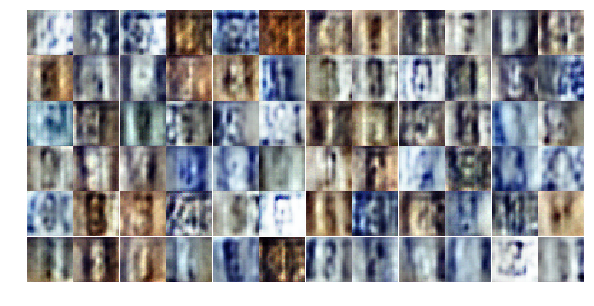

Epoch 2/25... Discriminator Loss: 0.8937... Generator Loss: 2.4344
Epoch 2/25... Discriminator Loss: 0.6147... Generator Loss: 1.9710
Epoch 2/25... Discriminator Loss: 0.9269... Generator Loss: 0.7947
Epoch 2/25... Discriminator Loss: 1.2452... Generator Loss: 0.6326
Epoch 2/25... Discriminator Loss: 0.9876... Generator Loss: 0.8692
Epoch 2/25... Discriminator Loss: 0.8178... Generator Loss: 1.1651
Epoch 2/25... Discriminator Loss: 0.8330... Generator Loss: 1.2286
Epoch 2/25... Discriminator Loss: 0.8461... Generator Loss: 1.0827
Epoch 2/25... Discriminator Loss: 0.7225... Generator Loss: 2.1211
Epoch 2/25... Discriminator Loss: 0.9407... Generator Loss: 0.7076


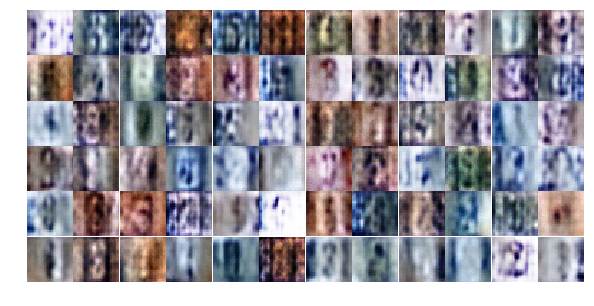

Epoch 2/25... Discriminator Loss: 0.4181... Generator Loss: 1.9881
Epoch 2/25... Discriminator Loss: 1.3080... Generator Loss: 0.7723
Epoch 2/25... Discriminator Loss: 0.8517... Generator Loss: 0.9244
Epoch 2/25... Discriminator Loss: 1.1588... Generator Loss: 0.7393
Epoch 3/25... Discriminator Loss: 0.2713... Generator Loss: 2.7977
Epoch 3/25... Discriminator Loss: 0.7201... Generator Loss: 1.0120
Epoch 3/25... Discriminator Loss: 0.5725... Generator Loss: 2.4811
Epoch 3/25... Discriminator Loss: 0.7140... Generator Loss: 0.9223
Epoch 3/25... Discriminator Loss: 0.5828... Generator Loss: 2.0336
Epoch 3/25... Discriminator Loss: 1.5931... Generator Loss: 0.4329


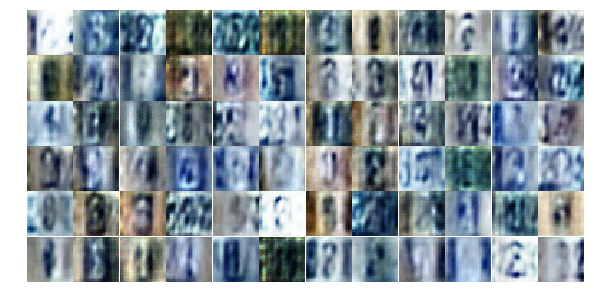

Epoch 3/25... Discriminator Loss: 0.5258... Generator Loss: 1.6335
Epoch 3/25... Discriminator Loss: 0.4142... Generator Loss: 1.6162
Epoch 3/25... Discriminator Loss: 0.8796... Generator Loss: 1.2236
Epoch 3/25... Discriminator Loss: 0.8999... Generator Loss: 0.9514
Epoch 3/25... Discriminator Loss: 0.7060... Generator Loss: 1.8453
Epoch 3/25... Discriminator Loss: 0.4738... Generator Loss: 1.7357
Epoch 3/25... Discriminator Loss: 0.4819... Generator Loss: 1.6692
Epoch 3/25... Discriminator Loss: 0.4834... Generator Loss: 1.5227
Epoch 3/25... Discriminator Loss: 0.3484... Generator Loss: 2.0472
Epoch 3/25... Discriminator Loss: 1.0711... Generator Loss: 1.1770


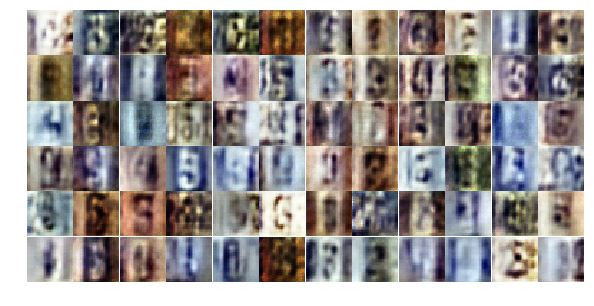

Epoch 3/25... Discriminator Loss: 0.4436... Generator Loss: 2.0899
Epoch 3/25... Discriminator Loss: 0.9497... Generator Loss: 0.7015
Epoch 3/25... Discriminator Loss: 0.7377... Generator Loss: 1.6825
Epoch 3/25... Discriminator Loss: 0.5287... Generator Loss: 1.5210
Epoch 3/25... Discriminator Loss: 0.5264... Generator Loss: 1.5381
Epoch 3/25... Discriminator Loss: 0.2623... Generator Loss: 2.7476
Epoch 3/25... Discriminator Loss: 0.2516... Generator Loss: 2.1360
Epoch 3/25... Discriminator Loss: 0.5041... Generator Loss: 1.3228
Epoch 3/25... Discriminator Loss: 0.5064... Generator Loss: 1.4173
Epoch 3/25... Discriminator Loss: 0.9380... Generator Loss: 0.7924


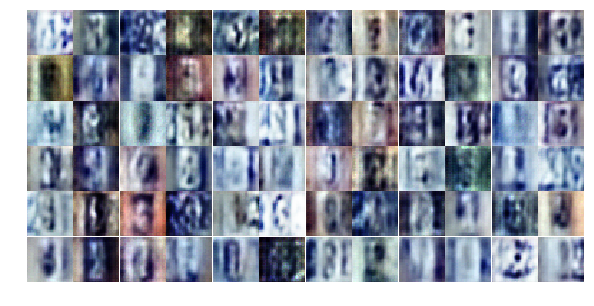

Epoch 3/25... Discriminator Loss: 0.9777... Generator Loss: 1.6114
Epoch 3/25... Discriminator Loss: 0.7883... Generator Loss: 1.5356
Epoch 3/25... Discriminator Loss: 1.1921... Generator Loss: 0.5323
Epoch 3/25... Discriminator Loss: 0.7315... Generator Loss: 1.2802
Epoch 3/25... Discriminator Loss: 0.3477... Generator Loss: 2.5796
Epoch 3/25... Discriminator Loss: 0.6718... Generator Loss: 1.0698
Epoch 3/25... Discriminator Loss: 0.7835... Generator Loss: 0.9222
Epoch 3/25... Discriminator Loss: 0.9756... Generator Loss: 0.7724
Epoch 3/25... Discriminator Loss: 0.4164... Generator Loss: 1.6910
Epoch 3/25... Discriminator Loss: 0.8154... Generator Loss: 3.7739


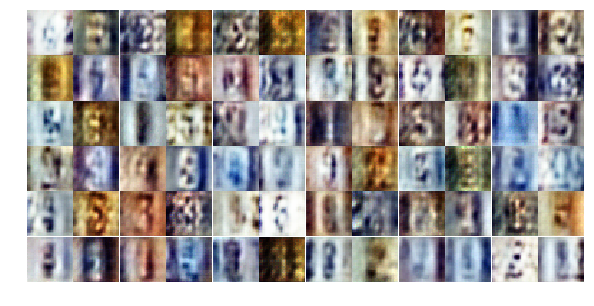

Epoch 3/25... Discriminator Loss: 0.8061... Generator Loss: 2.9116
Epoch 3/25... Discriminator Loss: 0.3463... Generator Loss: 2.8892
Epoch 3/25... Discriminator Loss: 0.4111... Generator Loss: 2.0878
Epoch 3/25... Discriminator Loss: 0.8817... Generator Loss: 0.8969
Epoch 3/25... Discriminator Loss: 0.3585... Generator Loss: 2.6258
Epoch 3/25... Discriminator Loss: 0.8534... Generator Loss: 3.1682
Epoch 3/25... Discriminator Loss: 1.0110... Generator Loss: 2.0607
Epoch 3/25... Discriminator Loss: 0.6469... Generator Loss: 1.1357
Epoch 3/25... Discriminator Loss: 0.5852... Generator Loss: 1.4074
Epoch 3/25... Discriminator Loss: 1.3954... Generator Loss: 0.4344


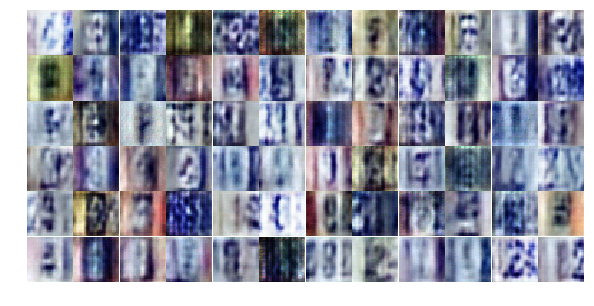

Epoch 3/25... Discriminator Loss: 0.9238... Generator Loss: 1.0282
Epoch 3/25... Discriminator Loss: 0.9077... Generator Loss: 2.2671
Epoch 3/25... Discriminator Loss: 0.5822... Generator Loss: 1.7065
Epoch 3/25... Discriminator Loss: 0.4235... Generator Loss: 1.5742
Epoch 3/25... Discriminator Loss: 0.5218... Generator Loss: 1.5785
Epoch 3/25... Discriminator Loss: 0.5490... Generator Loss: 2.2143
Epoch 3/25... Discriminator Loss: 0.5391... Generator Loss: 2.0311
Epoch 3/25... Discriminator Loss: 0.5537... Generator Loss: 2.7811
Epoch 3/25... Discriminator Loss: 0.4145... Generator Loss: 2.0711
Epoch 3/25... Discriminator Loss: 0.3103... Generator Loss: 2.2857


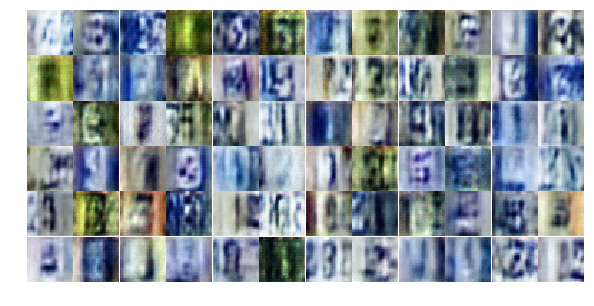

Epoch 3/25... Discriminator Loss: 0.9317... Generator Loss: 0.7331
Epoch 4/25... Discriminator Loss: 0.6366... Generator Loss: 1.3751
Epoch 4/25... Discriminator Loss: 1.0659... Generator Loss: 0.6192
Epoch 4/25... Discriminator Loss: 1.0362... Generator Loss: 0.6423
Epoch 4/25... Discriminator Loss: 0.3854... Generator Loss: 1.8576
Epoch 4/25... Discriminator Loss: 0.6125... Generator Loss: 1.2482
Epoch 4/25... Discriminator Loss: 1.2733... Generator Loss: 3.0663
Epoch 4/25... Discriminator Loss: 0.4872... Generator Loss: 1.7436
Epoch 4/25... Discriminator Loss: 0.4150... Generator Loss: 3.0958
Epoch 4/25... Discriminator Loss: 1.2087... Generator Loss: 0.5093


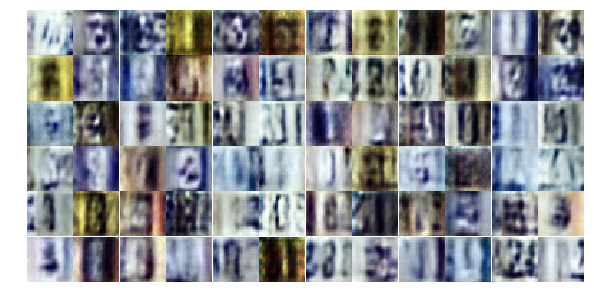

Epoch 4/25... Discriminator Loss: 0.5726... Generator Loss: 1.2078
Epoch 4/25... Discriminator Loss: 0.3945... Generator Loss: 1.7264
Epoch 4/25... Discriminator Loss: 0.7274... Generator Loss: 1.2136
Epoch 4/25... Discriminator Loss: 0.4163... Generator Loss: 2.4139
Epoch 4/25... Discriminator Loss: 0.9310... Generator Loss: 1.5511
Epoch 4/25... Discriminator Loss: 1.2924... Generator Loss: 0.4388
Epoch 4/25... Discriminator Loss: 0.8371... Generator Loss: 2.4967
Epoch 4/25... Discriminator Loss: 0.4466... Generator Loss: 1.3894
Epoch 4/25... Discriminator Loss: 0.7393... Generator Loss: 3.0525
Epoch 4/25... Discriminator Loss: 0.6325... Generator Loss: 1.0312


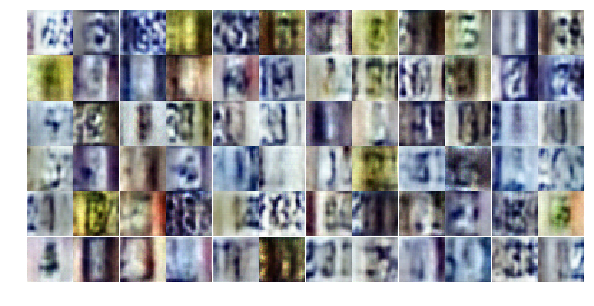

Epoch 4/25... Discriminator Loss: 0.3743... Generator Loss: 1.7940
Epoch 4/25... Discriminator Loss: 0.7802... Generator Loss: 2.8867
Epoch 4/25... Discriminator Loss: 0.5378... Generator Loss: 1.2651
Epoch 4/25... Discriminator Loss: 0.6230... Generator Loss: 1.0846
Epoch 4/25... Discriminator Loss: 0.3148... Generator Loss: 2.9489
Epoch 4/25... Discriminator Loss: 0.9310... Generator Loss: 4.1513
Epoch 4/25... Discriminator Loss: 2.2679... Generator Loss: 0.2245
Epoch 4/25... Discriminator Loss: 1.3580... Generator Loss: 0.4732
Epoch 4/25... Discriminator Loss: 0.4233... Generator Loss: 1.6913
Epoch 4/25... Discriminator Loss: 0.7295... Generator Loss: 1.0182


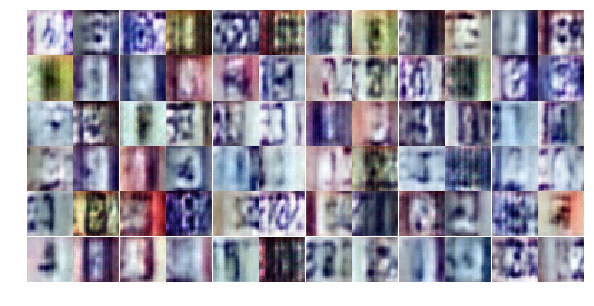

Epoch 4/25... Discriminator Loss: 0.4120... Generator Loss: 1.8402
Epoch 4/25... Discriminator Loss: 0.5803... Generator Loss: 1.3648
Epoch 4/25... Discriminator Loss: 0.5467... Generator Loss: 1.3506
Epoch 4/25... Discriminator Loss: 0.5013... Generator Loss: 1.3945
Epoch 4/25... Discriminator Loss: 0.4962... Generator Loss: 2.8232
Epoch 4/25... Discriminator Loss: 0.4776... Generator Loss: 1.3051
Epoch 4/25... Discriminator Loss: 0.7080... Generator Loss: 2.4158
Epoch 4/25... Discriminator Loss: 0.8889... Generator Loss: 0.7169
Epoch 4/25... Discriminator Loss: 0.3400... Generator Loss: 1.7214
Epoch 4/25... Discriminator Loss: 1.1526... Generator Loss: 0.5353


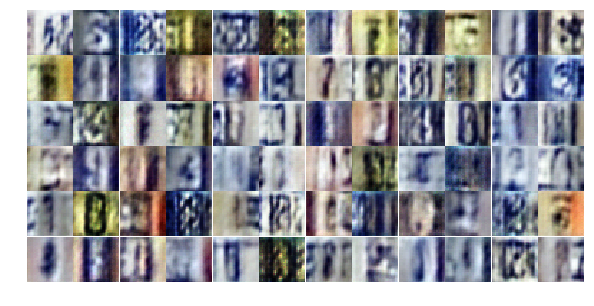

Epoch 4/25... Discriminator Loss: 0.4617... Generator Loss: 1.5892
Epoch 4/25... Discriminator Loss: 0.2047... Generator Loss: 2.6601
Epoch 4/25... Discriminator Loss: 0.3314... Generator Loss: 2.2126
Epoch 4/25... Discriminator Loss: 0.2700... Generator Loss: 1.8916
Epoch 4/25... Discriminator Loss: 0.8587... Generator Loss: 2.5264
Epoch 4/25... Discriminator Loss: 0.6654... Generator Loss: 1.0861
Epoch 4/25... Discriminator Loss: 0.7268... Generator Loss: 0.9648
Epoch 4/25... Discriminator Loss: 0.6236... Generator Loss: 1.4738
Epoch 4/25... Discriminator Loss: 0.3698... Generator Loss: 1.9488
Epoch 4/25... Discriminator Loss: 0.9894... Generator Loss: 0.6199


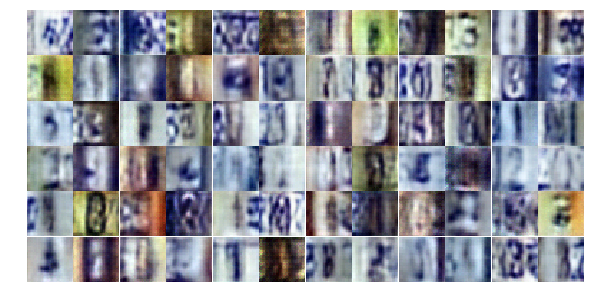

Epoch 4/25... Discriminator Loss: 0.7248... Generator Loss: 0.9386
Epoch 4/25... Discriminator Loss: 0.3375... Generator Loss: 1.5801
Epoch 4/25... Discriminator Loss: 0.2373... Generator Loss: 2.2783
Epoch 4/25... Discriminator Loss: 0.8525... Generator Loss: 2.8385
Epoch 4/25... Discriminator Loss: 0.6656... Generator Loss: 1.1134
Epoch 4/25... Discriminator Loss: 0.7049... Generator Loss: 0.8900
Epoch 4/25... Discriminator Loss: 0.8173... Generator Loss: 0.8232
Epoch 4/25... Discriminator Loss: 0.8763... Generator Loss: 0.7857
Epoch 4/25... Discriminator Loss: 0.4374... Generator Loss: 1.9895
Epoch 5/25... Discriminator Loss: 0.5403... Generator Loss: 1.1800


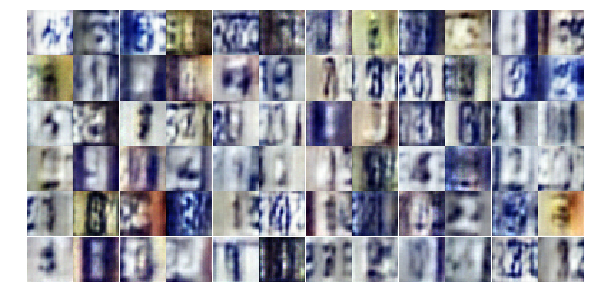

Epoch 5/25... Discriminator Loss: 0.8807... Generator Loss: 0.8995
Epoch 5/25... Discriminator Loss: 0.7187... Generator Loss: 1.1169
Epoch 5/25... Discriminator Loss: 0.4864... Generator Loss: 1.7316
Epoch 5/25... Discriminator Loss: 0.6193... Generator Loss: 0.9836
Epoch 5/25... Discriminator Loss: 0.4350... Generator Loss: 1.4178
Epoch 5/25... Discriminator Loss: 1.2397... Generator Loss: 0.5201
Epoch 5/25... Discriminator Loss: 0.6029... Generator Loss: 1.2305
Epoch 5/25... Discriminator Loss: 0.5858... Generator Loss: 1.3747
Epoch 5/25... Discriminator Loss: 0.4126... Generator Loss: 1.5816
Epoch 5/25... Discriminator Loss: 1.1472... Generator Loss: 0.5939


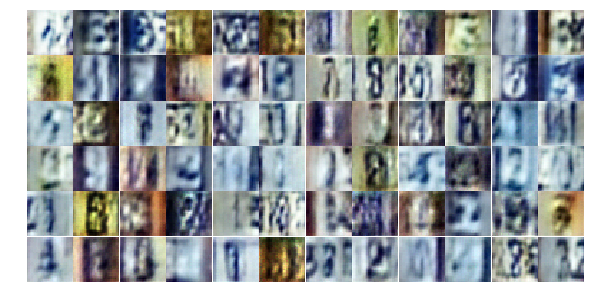

Epoch 5/25... Discriminator Loss: 0.7807... Generator Loss: 0.9319
Epoch 5/25... Discriminator Loss: 0.5169... Generator Loss: 1.3477
Epoch 5/25... Discriminator Loss: 0.3773... Generator Loss: 1.7119
Epoch 5/25... Discriminator Loss: 0.6333... Generator Loss: 1.0938
Epoch 5/25... Discriminator Loss: 1.3580... Generator Loss: 2.4653
Epoch 5/25... Discriminator Loss: 0.7318... Generator Loss: 1.0841
Epoch 5/25... Discriminator Loss: 0.7741... Generator Loss: 0.9090
Epoch 5/25... Discriminator Loss: 0.5384... Generator Loss: 1.3078
Epoch 5/25... Discriminator Loss: 0.4946... Generator Loss: 1.3795
Epoch 5/25... Discriminator Loss: 0.6103... Generator Loss: 1.1406


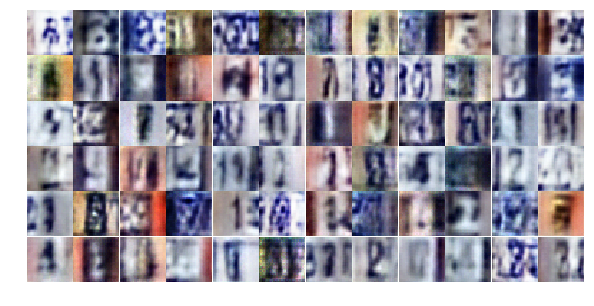

Epoch 5/25... Discriminator Loss: 0.4181... Generator Loss: 1.5486
Epoch 5/25... Discriminator Loss: 1.2498... Generator Loss: 0.4833
Epoch 5/25... Discriminator Loss: 0.4556... Generator Loss: 1.6865
Epoch 5/25... Discriminator Loss: 0.5954... Generator Loss: 1.1819
Epoch 5/25... Discriminator Loss: 0.3320... Generator Loss: 1.8414
Epoch 5/25... Discriminator Loss: 0.7512... Generator Loss: 0.9338
Epoch 5/25... Discriminator Loss: 0.9169... Generator Loss: 0.7642
Epoch 5/25... Discriminator Loss: 0.7747... Generator Loss: 1.3910
Epoch 5/25... Discriminator Loss: 0.7798... Generator Loss: 0.9904
Epoch 5/25... Discriminator Loss: 0.3984... Generator Loss: 1.5373


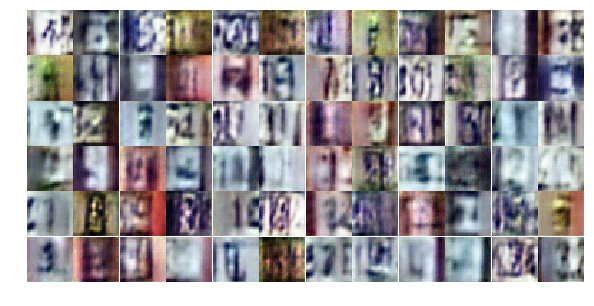

Epoch 5/25... Discriminator Loss: 1.1390... Generator Loss: 0.5255
Epoch 5/25... Discriminator Loss: 0.4773... Generator Loss: 1.6193
Epoch 5/25... Discriminator Loss: 0.6489... Generator Loss: 1.5823
Epoch 5/25... Discriminator Loss: 0.6122... Generator Loss: 1.1050
Epoch 5/25... Discriminator Loss: 0.5864... Generator Loss: 2.1628
Epoch 5/25... Discriminator Loss: 0.6637... Generator Loss: 1.0075
Epoch 5/25... Discriminator Loss: 0.6582... Generator Loss: 1.2252
Epoch 5/25... Discriminator Loss: 0.5117... Generator Loss: 1.2760
Epoch 5/25... Discriminator Loss: 0.6578... Generator Loss: 1.0122
Epoch 5/25... Discriminator Loss: 0.6340... Generator Loss: 1.0303


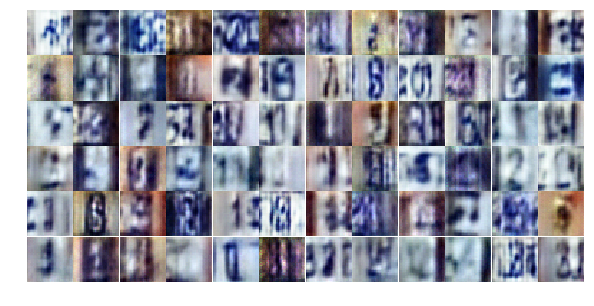

Epoch 5/25... Discriminator Loss: 0.4531... Generator Loss: 1.8749
Epoch 5/25... Discriminator Loss: 0.8893... Generator Loss: 0.7319
Epoch 5/25... Discriminator Loss: 0.7783... Generator Loss: 1.2239
Epoch 5/25... Discriminator Loss: 0.3852... Generator Loss: 1.7292
Epoch 5/25... Discriminator Loss: 1.0827... Generator Loss: 0.5915
Epoch 5/25... Discriminator Loss: 0.8615... Generator Loss: 2.9478
Epoch 5/25... Discriminator Loss: 1.0526... Generator Loss: 0.6251
Epoch 5/25... Discriminator Loss: 0.5908... Generator Loss: 1.5025
Epoch 5/25... Discriminator Loss: 0.5481... Generator Loss: 1.5996
Epoch 5/25... Discriminator Loss: 0.5323... Generator Loss: 1.9446


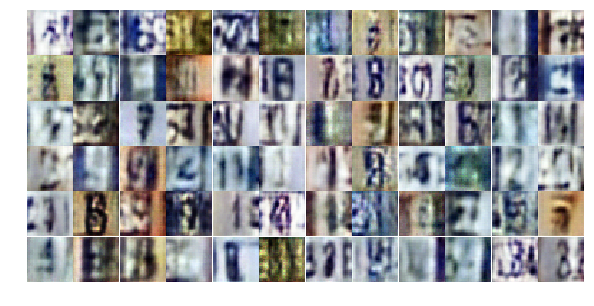

Epoch 5/25... Discriminator Loss: 0.5173... Generator Loss: 1.4662
Epoch 5/25... Discriminator Loss: 0.5449... Generator Loss: 1.7172
Epoch 5/25... Discriminator Loss: 0.6168... Generator Loss: 1.9209
Epoch 5/25... Discriminator Loss: 0.6209... Generator Loss: 1.0718
Epoch 5/25... Discriminator Loss: 0.5124... Generator Loss: 1.3902
Epoch 5/25... Discriminator Loss: 0.7203... Generator Loss: 2.2583
Epoch 6/25... Discriminator Loss: 0.9204... Generator Loss: 0.6529
Epoch 6/25... Discriminator Loss: 0.3276... Generator Loss: 1.6739
Epoch 6/25... Discriminator Loss: 0.3245... Generator Loss: 1.7959
Epoch 6/25... Discriminator Loss: 0.6318... Generator Loss: 1.2657


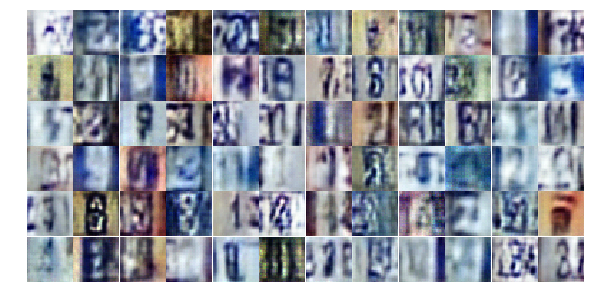

Epoch 6/25... Discriminator Loss: 0.8438... Generator Loss: 0.7800
Epoch 6/25... Discriminator Loss: 1.0347... Generator Loss: 0.5984
Epoch 6/25... Discriminator Loss: 0.4135... Generator Loss: 1.5512
Epoch 6/25... Discriminator Loss: 0.5213... Generator Loss: 1.6378
Epoch 6/25... Discriminator Loss: 0.8623... Generator Loss: 0.6992
Epoch 6/25... Discriminator Loss: 0.3856... Generator Loss: 1.5365
Epoch 6/25... Discriminator Loss: 0.4628... Generator Loss: 3.3564
Epoch 6/25... Discriminator Loss: 0.5175... Generator Loss: 2.3331
Epoch 6/25... Discriminator Loss: 0.5068... Generator Loss: 1.5835
Epoch 6/25... Discriminator Loss: 0.5572... Generator Loss: 2.0506


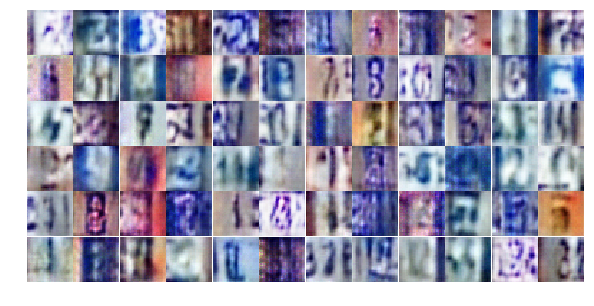

Epoch 6/25... Discriminator Loss: 1.7025... Generator Loss: 0.3673
Epoch 6/25... Discriminator Loss: 0.6679... Generator Loss: 1.3781
Epoch 6/25... Discriminator Loss: 1.2436... Generator Loss: 0.4717
Epoch 6/25... Discriminator Loss: 0.2663... Generator Loss: 2.0319
Epoch 6/25... Discriminator Loss: 0.5995... Generator Loss: 1.4457
Epoch 6/25... Discriminator Loss: 0.4218... Generator Loss: 1.8806
Epoch 6/25... Discriminator Loss: 0.5397... Generator Loss: 1.3700
Epoch 6/25... Discriminator Loss: 0.8470... Generator Loss: 0.7939
Epoch 6/25... Discriminator Loss: 0.6629... Generator Loss: 3.2610
Epoch 6/25... Discriminator Loss: 0.4898... Generator Loss: 1.4659


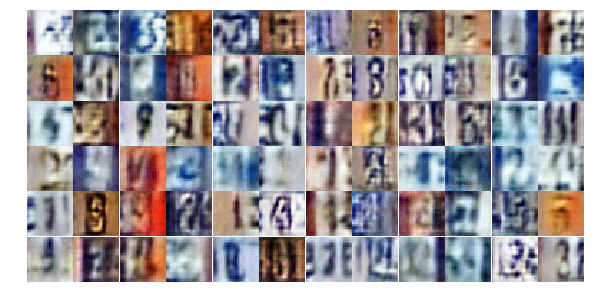

Epoch 6/25... Discriminator Loss: 0.7479... Generator Loss: 0.9275
Epoch 6/25... Discriminator Loss: 0.4258... Generator Loss: 1.8685
Epoch 6/25... Discriminator Loss: 0.8629... Generator Loss: 0.9087
Epoch 6/25... Discriminator Loss: 0.5052... Generator Loss: 1.1834
Epoch 6/25... Discriminator Loss: 0.4605... Generator Loss: 2.3740
Epoch 6/25... Discriminator Loss: 0.9959... Generator Loss: 1.1408
Epoch 6/25... Discriminator Loss: 0.5471... Generator Loss: 1.2703
Epoch 6/25... Discriminator Loss: 0.3711... Generator Loss: 1.6749
Epoch 6/25... Discriminator Loss: 0.4118... Generator Loss: 1.6528
Epoch 6/25... Discriminator Loss: 0.4982... Generator Loss: 1.8846


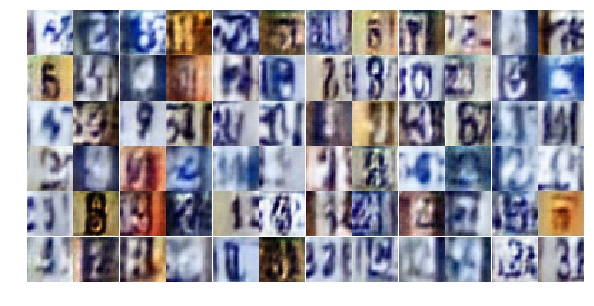

Epoch 6/25... Discriminator Loss: 0.6105... Generator Loss: 1.1012
Epoch 6/25... Discriminator Loss: 0.6834... Generator Loss: 0.9440
Epoch 6/25... Discriminator Loss: 0.9373... Generator Loss: 0.6942
Epoch 6/25... Discriminator Loss: 0.4783... Generator Loss: 1.2568
Epoch 6/25... Discriminator Loss: 0.4365... Generator Loss: 1.3826
Epoch 6/25... Discriminator Loss: 0.6051... Generator Loss: 1.1580
Epoch 6/25... Discriminator Loss: 0.3705... Generator Loss: 1.7235
Epoch 6/25... Discriminator Loss: 0.6004... Generator Loss: 2.6150
Epoch 6/25... Discriminator Loss: 0.5709... Generator Loss: 1.3049
Epoch 6/25... Discriminator Loss: 0.5481... Generator Loss: 1.1742


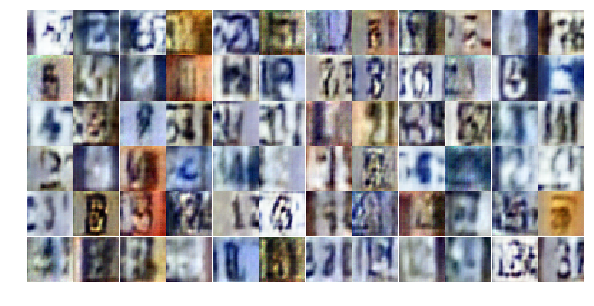

Epoch 6/25... Discriminator Loss: 0.8481... Generator Loss: 0.8569
Epoch 6/25... Discriminator Loss: 0.7181... Generator Loss: 1.4600
Epoch 6/25... Discriminator Loss: 0.6591... Generator Loss: 1.0362
Epoch 6/25... Discriminator Loss: 0.6508... Generator Loss: 1.9572
Epoch 6/25... Discriminator Loss: 0.4621... Generator Loss: 1.4113
Epoch 6/25... Discriminator Loss: 0.3805... Generator Loss: 1.6264
Epoch 6/25... Discriminator Loss: 0.6260... Generator Loss: 1.0169
Epoch 6/25... Discriminator Loss: 0.8363... Generator Loss: 0.8020
Epoch 6/25... Discriminator Loss: 1.1461... Generator Loss: 0.5813
Epoch 6/25... Discriminator Loss: 1.5874... Generator Loss: 0.3523


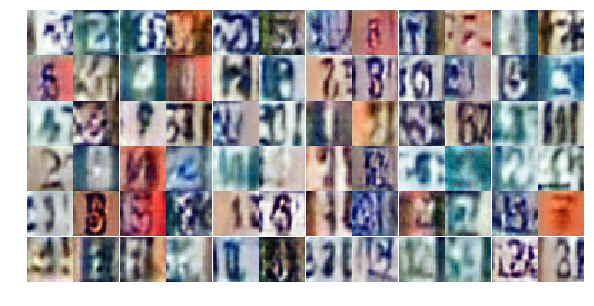

Epoch 6/25... Discriminator Loss: 0.4182... Generator Loss: 1.7531
Epoch 6/25... Discriminator Loss: 0.4393... Generator Loss: 2.9249
Epoch 6/25... Discriminator Loss: 1.0192... Generator Loss: 0.6848
Epoch 7/25... Discriminator Loss: 0.5723... Generator Loss: 1.4034
Epoch 7/25... Discriminator Loss: 0.8764... Generator Loss: 0.7447
Epoch 7/25... Discriminator Loss: 0.7115... Generator Loss: 1.1761
Epoch 7/25... Discriminator Loss: 0.4365... Generator Loss: 1.6404
Epoch 7/25... Discriminator Loss: 0.3919... Generator Loss: 1.7368
Epoch 7/25... Discriminator Loss: 0.4708... Generator Loss: 1.6635
Epoch 7/25... Discriminator Loss: 2.2942... Generator Loss: 0.1858


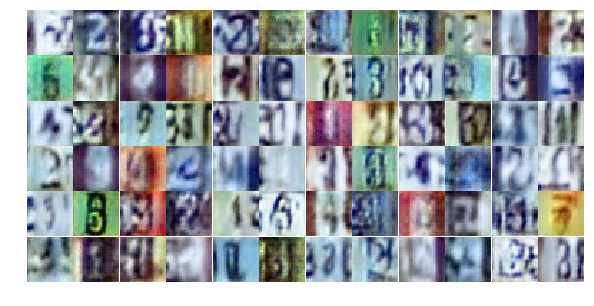

Epoch 7/25... Discriminator Loss: 1.0701... Generator Loss: 0.8525
Epoch 7/25... Discriminator Loss: 0.6772... Generator Loss: 1.1106
Epoch 7/25... Discriminator Loss: 0.6928... Generator Loss: 0.9961
Epoch 7/25... Discriminator Loss: 0.7150... Generator Loss: 1.4713
Epoch 7/25... Discriminator Loss: 0.5326... Generator Loss: 1.3268
Epoch 7/25... Discriminator Loss: 0.4656... Generator Loss: 1.5082
Epoch 7/25... Discriminator Loss: 0.8897... Generator Loss: 2.3179
Epoch 7/25... Discriminator Loss: 0.9002... Generator Loss: 2.5581
Epoch 7/25... Discriminator Loss: 0.6225... Generator Loss: 2.6654
Epoch 7/25... Discriminator Loss: 0.6508... Generator Loss: 1.0338


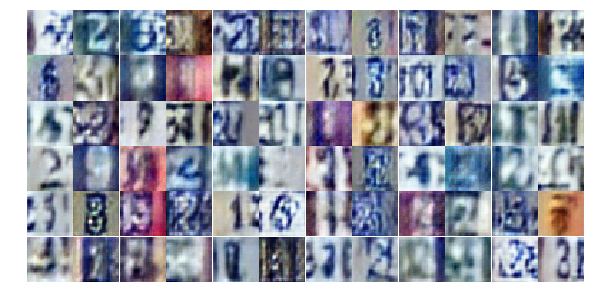

Epoch 7/25... Discriminator Loss: 0.4902... Generator Loss: 1.5469
Epoch 7/25... Discriminator Loss: 0.4331... Generator Loss: 1.5524
Epoch 7/25... Discriminator Loss: 0.7958... Generator Loss: 0.8802
Epoch 7/25... Discriminator Loss: 0.6998... Generator Loss: 1.7806
Epoch 7/25... Discriminator Loss: 0.5072... Generator Loss: 1.4459
Epoch 7/25... Discriminator Loss: 0.4886... Generator Loss: 1.7012
Epoch 7/25... Discriminator Loss: 0.6068... Generator Loss: 1.2099
Epoch 7/25... Discriminator Loss: 1.1410... Generator Loss: 0.5337
Epoch 7/25... Discriminator Loss: 0.4463... Generator Loss: 1.5972
Epoch 7/25... Discriminator Loss: 0.3892... Generator Loss: 2.2364


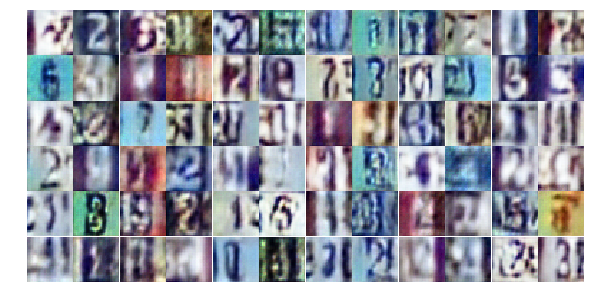

Epoch 7/25... Discriminator Loss: 1.1104... Generator Loss: 0.6375
Epoch 7/25... Discriminator Loss: 0.4953... Generator Loss: 1.4738
Epoch 7/25... Discriminator Loss: 0.8255... Generator Loss: 0.7748
Epoch 7/25... Discriminator Loss: 0.9006... Generator Loss: 0.7267
Epoch 7/25... Discriminator Loss: 0.8103... Generator Loss: 0.8378
Epoch 7/25... Discriminator Loss: 0.6591... Generator Loss: 1.1540
Epoch 7/25... Discriminator Loss: 0.5582... Generator Loss: 1.1170
Epoch 7/25... Discriminator Loss: 1.2577... Generator Loss: 0.4642
Epoch 7/25... Discriminator Loss: 1.5737... Generator Loss: 0.3044
Epoch 7/25... Discriminator Loss: 0.5142... Generator Loss: 1.5020


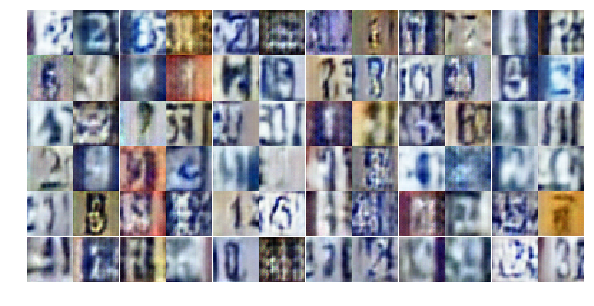

Epoch 7/25... Discriminator Loss: 1.5117... Generator Loss: 0.3504
Epoch 7/25... Discriminator Loss: 0.6084... Generator Loss: 2.6466
Epoch 7/25... Discriminator Loss: 0.3956... Generator Loss: 1.5196
Epoch 7/25... Discriminator Loss: 0.5995... Generator Loss: 1.1237
Epoch 7/25... Discriminator Loss: 0.8441... Generator Loss: 2.9790
Epoch 7/25... Discriminator Loss: 0.4533... Generator Loss: 1.5856
Epoch 7/25... Discriminator Loss: 0.4836... Generator Loss: 1.2951
Epoch 7/25... Discriminator Loss: 0.9611... Generator Loss: 1.3787
Epoch 7/25... Discriminator Loss: 0.3982... Generator Loss: 3.7000
Epoch 7/25... Discriminator Loss: 1.0074... Generator Loss: 0.6652


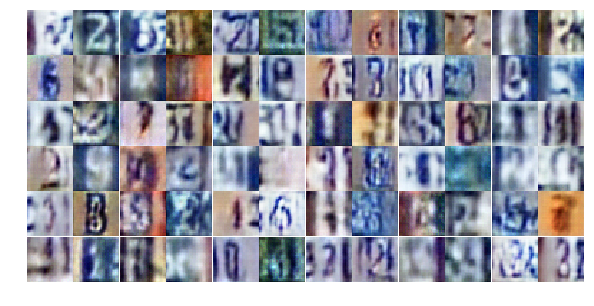

Epoch 7/25... Discriminator Loss: 0.4552... Generator Loss: 1.2930
Epoch 7/25... Discriminator Loss: 0.6110... Generator Loss: 1.1026
Epoch 7/25... Discriminator Loss: 0.6227... Generator Loss: 1.3672
Epoch 7/25... Discriminator Loss: 0.3588... Generator Loss: 1.7224
Epoch 7/25... Discriminator Loss: 0.4494... Generator Loss: 1.8099
Epoch 7/25... Discriminator Loss: 1.2183... Generator Loss: 0.6349
Epoch 7/25... Discriminator Loss: 0.8214... Generator Loss: 0.7476
Epoch 7/25... Discriminator Loss: 0.9089... Generator Loss: 0.8227
Epoch 7/25... Discriminator Loss: 0.7302... Generator Loss: 1.1835
Epoch 7/25... Discriminator Loss: 0.9750... Generator Loss: 0.7002


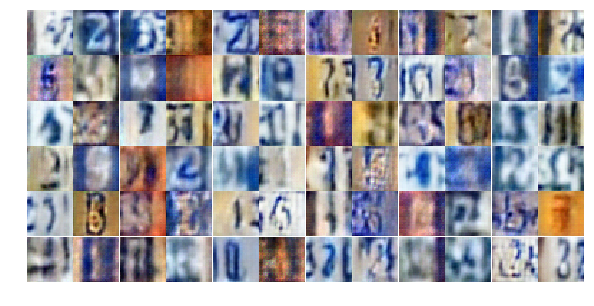

Epoch 7/25... Discriminator Loss: 0.8073... Generator Loss: 0.8953
Epoch 8/25... Discriminator Loss: 0.8945... Generator Loss: 0.7728
Epoch 8/25... Discriminator Loss: 0.8000... Generator Loss: 0.7923
Epoch 8/25... Discriminator Loss: 0.6350... Generator Loss: 1.8422
Epoch 8/25... Discriminator Loss: 0.7208... Generator Loss: 1.0547
Epoch 8/25... Discriminator Loss: 0.8828... Generator Loss: 0.7373
Epoch 8/25... Discriminator Loss: 0.8105... Generator Loss: 0.8958
Epoch 8/25... Discriminator Loss: 0.5848... Generator Loss: 2.5203
Epoch 8/25... Discriminator Loss: 0.7439... Generator Loss: 1.0166
Epoch 8/25... Discriminator Loss: 0.5730... Generator Loss: 1.2745


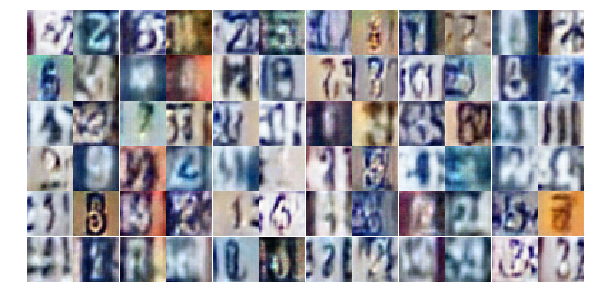

Epoch 8/25... Discriminator Loss: 0.3263... Generator Loss: 2.3264
Epoch 8/25... Discriminator Loss: 0.3794... Generator Loss: 1.7703
Epoch 8/25... Discriminator Loss: 0.5718... Generator Loss: 1.5717
Epoch 8/25... Discriminator Loss: 0.3599... Generator Loss: 1.8290
Epoch 8/25... Discriminator Loss: 0.6880... Generator Loss: 0.9380
Epoch 8/25... Discriminator Loss: 0.5691... Generator Loss: 1.9069
Epoch 8/25... Discriminator Loss: 0.7045... Generator Loss: 0.9355
Epoch 8/25... Discriminator Loss: 1.0420... Generator Loss: 2.9450
Epoch 8/25... Discriminator Loss: 0.5832... Generator Loss: 1.1822
Epoch 8/25... Discriminator Loss: 1.4995... Generator Loss: 0.3547


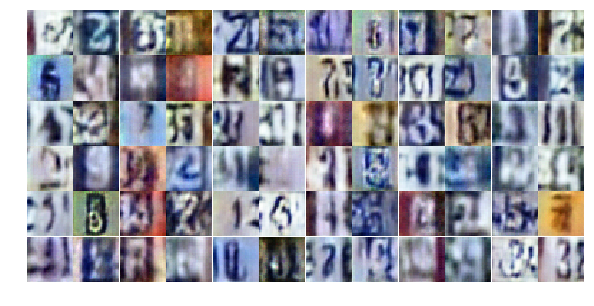

Epoch 8/25... Discriminator Loss: 0.3777... Generator Loss: 2.0093
Epoch 8/25... Discriminator Loss: 0.7291... Generator Loss: 1.0321
Epoch 8/25... Discriminator Loss: 0.6116... Generator Loss: 1.0705
Epoch 8/25... Discriminator Loss: 0.9662... Generator Loss: 0.6485
Epoch 8/25... Discriminator Loss: 0.3885... Generator Loss: 2.1508
Epoch 8/25... Discriminator Loss: 1.2587... Generator Loss: 3.3209
Epoch 8/25... Discriminator Loss: 0.7055... Generator Loss: 2.0462
Epoch 8/25... Discriminator Loss: 0.3967... Generator Loss: 1.9901
Epoch 8/25... Discriminator Loss: 0.5661... Generator Loss: 1.5812
Epoch 8/25... Discriminator Loss: 0.5252... Generator Loss: 1.2890


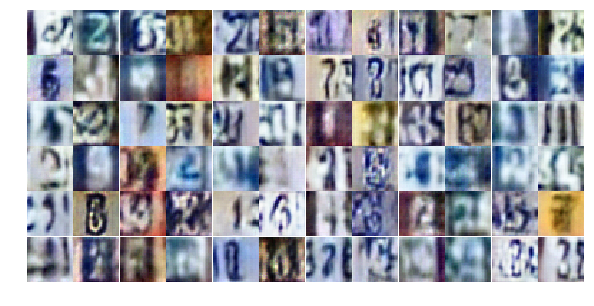

Epoch 8/25... Discriminator Loss: 0.7714... Generator Loss: 0.8502
Epoch 8/25... Discriminator Loss: 1.1017... Generator Loss: 0.6146
Epoch 8/25... Discriminator Loss: 0.4416... Generator Loss: 1.7542
Epoch 8/25... Discriminator Loss: 0.4962... Generator Loss: 1.2918
Epoch 8/25... Discriminator Loss: 0.5710... Generator Loss: 1.0609
Epoch 8/25... Discriminator Loss: 0.2899... Generator Loss: 1.9382
Epoch 8/25... Discriminator Loss: 0.5912... Generator Loss: 1.1500
Epoch 8/25... Discriminator Loss: 0.6301... Generator Loss: 1.0956
Epoch 8/25... Discriminator Loss: 0.5429... Generator Loss: 1.3744
Epoch 8/25... Discriminator Loss: 0.5625... Generator Loss: 1.7085


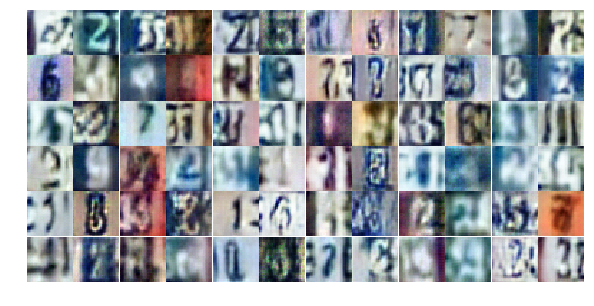

Epoch 8/25... Discriminator Loss: 0.4169... Generator Loss: 1.4677
Epoch 8/25... Discriminator Loss: 1.0719... Generator Loss: 0.6073
Epoch 8/25... Discriminator Loss: 0.6520... Generator Loss: 1.0376
Epoch 8/25... Discriminator Loss: 1.0254... Generator Loss: 0.6725
Epoch 8/25... Discriminator Loss: 0.5111... Generator Loss: 1.9390
Epoch 8/25... Discriminator Loss: 3.2893... Generator Loss: 5.2503
Epoch 8/25... Discriminator Loss: 0.7495... Generator Loss: 1.6288
Epoch 8/25... Discriminator Loss: 0.5057... Generator Loss: 1.5314
Epoch 8/25... Discriminator Loss: 0.7401... Generator Loss: 1.2285
Epoch 8/25... Discriminator Loss: 0.8218... Generator Loss: 0.8097


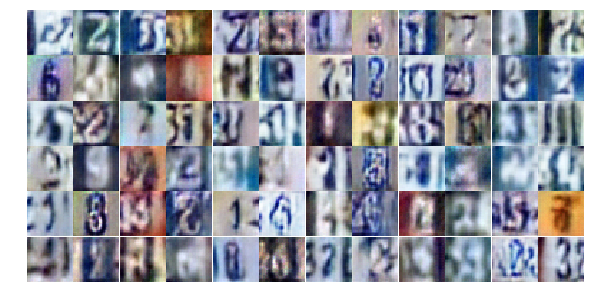

Epoch 8/25... Discriminator Loss: 0.4757... Generator Loss: 1.4487
Epoch 8/25... Discriminator Loss: 0.3677... Generator Loss: 2.0209
Epoch 8/25... Discriminator Loss: 0.4421... Generator Loss: 2.2110
Epoch 8/25... Discriminator Loss: 1.0804... Generator Loss: 0.5812
Epoch 8/25... Discriminator Loss: 0.3627... Generator Loss: 1.9103
Epoch 8/25... Discriminator Loss: 1.1167... Generator Loss: 0.5452
Epoch 8/25... Discriminator Loss: 0.5506... Generator Loss: 1.2269
Epoch 8/25... Discriminator Loss: 0.6078... Generator Loss: 1.8237
Epoch 9/25... Discriminator Loss: 0.6584... Generator Loss: 1.4928
Epoch 9/25... Discriminator Loss: 0.7040... Generator Loss: 0.9178


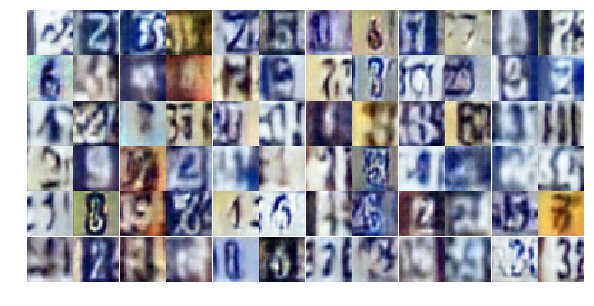

Epoch 9/25... Discriminator Loss: 0.4377... Generator Loss: 1.4353
Epoch 9/25... Discriminator Loss: 0.5592... Generator Loss: 1.5703
Epoch 9/25... Discriminator Loss: 0.9614... Generator Loss: 0.6129
Epoch 9/25... Discriminator Loss: 0.3798... Generator Loss: 2.3212
Epoch 9/25... Discriminator Loss: 1.8112... Generator Loss: 0.2726
Epoch 9/25... Discriminator Loss: 0.9156... Generator Loss: 1.6481
Epoch 9/25... Discriminator Loss: 0.7292... Generator Loss: 1.2143
Epoch 9/25... Discriminator Loss: 0.5404... Generator Loss: 1.3344
Epoch 9/25... Discriminator Loss: 0.8405... Generator Loss: 0.7929
Epoch 9/25... Discriminator Loss: 0.5596... Generator Loss: 1.6982


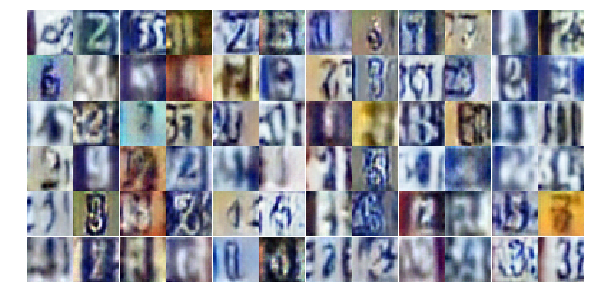

Epoch 9/25... Discriminator Loss: 0.9024... Generator Loss: 0.7608
Epoch 9/25... Discriminator Loss: 1.1454... Generator Loss: 0.5283
Epoch 9/25... Discriminator Loss: 0.5180... Generator Loss: 1.3292
Epoch 9/25... Discriminator Loss: 0.6522... Generator Loss: 1.2098
Epoch 9/25... Discriminator Loss: 0.6728... Generator Loss: 0.9511
Epoch 9/25... Discriminator Loss: 0.6435... Generator Loss: 1.0687
Epoch 9/25... Discriminator Loss: 0.7281... Generator Loss: 0.9699
Epoch 9/25... Discriminator Loss: 0.4665... Generator Loss: 1.4168
Epoch 9/25... Discriminator Loss: 0.9223... Generator Loss: 0.6899
Epoch 9/25... Discriminator Loss: 0.8152... Generator Loss: 0.7847


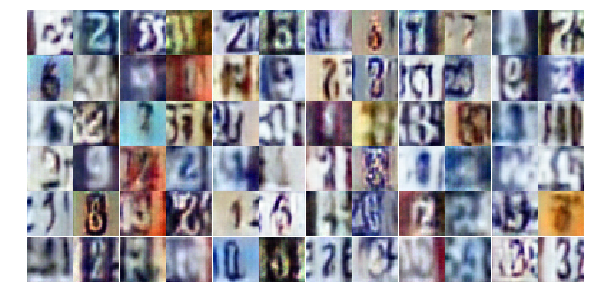

Epoch 9/25... Discriminator Loss: 0.9334... Generator Loss: 0.7304
Epoch 9/25... Discriminator Loss: 0.6313... Generator Loss: 1.1147
Epoch 9/25... Discriminator Loss: 0.4942... Generator Loss: 1.9103
Epoch 9/25... Discriminator Loss: 0.5329... Generator Loss: 1.2236
Epoch 9/25... Discriminator Loss: 0.4732... Generator Loss: 1.8894
Epoch 9/25... Discriminator Loss: 0.3351... Generator Loss: 1.8032
Epoch 9/25... Discriminator Loss: 1.2056... Generator Loss: 0.4650
Epoch 9/25... Discriminator Loss: 0.4384... Generator Loss: 2.2732
Epoch 9/25... Discriminator Loss: 0.4669... Generator Loss: 1.3885
Epoch 9/25... Discriminator Loss: 0.7551... Generator Loss: 0.8442


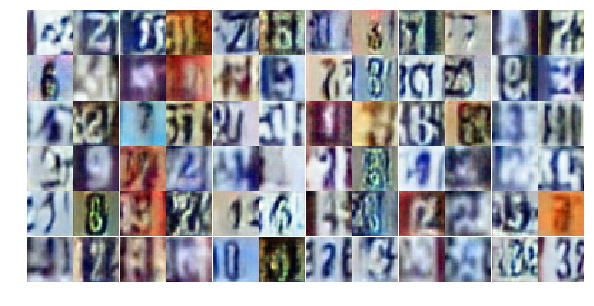

Epoch 9/25... Discriminator Loss: 0.5283... Generator Loss: 1.2614
Epoch 9/25... Discriminator Loss: 0.4322... Generator Loss: 1.4010
Epoch 9/25... Discriminator Loss: 0.6667... Generator Loss: 1.0928
Epoch 9/25... Discriminator Loss: 0.5681... Generator Loss: 1.2664
Epoch 9/25... Discriminator Loss: 0.6448... Generator Loss: 2.3858
Epoch 9/25... Discriminator Loss: 0.6185... Generator Loss: 1.2288
Epoch 9/25... Discriminator Loss: 0.5288... Generator Loss: 1.5821
Epoch 9/25... Discriminator Loss: 0.3993... Generator Loss: 1.6655
Epoch 9/25... Discriminator Loss: 0.9368... Generator Loss: 0.7044
Epoch 9/25... Discriminator Loss: 0.5313... Generator Loss: 1.3528


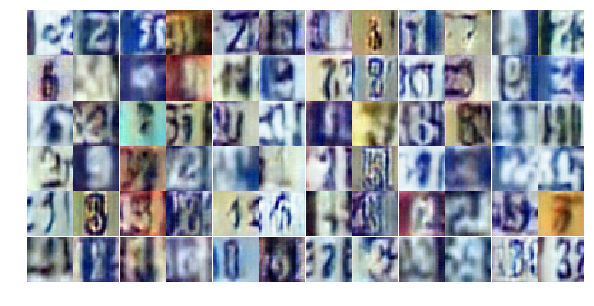

Epoch 9/25... Discriminator Loss: 0.4783... Generator Loss: 1.6644
Epoch 9/25... Discriminator Loss: 0.5178... Generator Loss: 1.3274
Epoch 9/25... Discriminator Loss: 0.7874... Generator Loss: 0.8606
Epoch 9/25... Discriminator Loss: 0.6133... Generator Loss: 1.2514
Epoch 9/25... Discriminator Loss: 0.3859... Generator Loss: 2.4267
Epoch 9/25... Discriminator Loss: 1.2703... Generator Loss: 0.4867
Epoch 9/25... Discriminator Loss: 0.8308... Generator Loss: 0.9039
Epoch 9/25... Discriminator Loss: 1.0632... Generator Loss: 0.5588
Epoch 9/25... Discriminator Loss: 0.3836... Generator Loss: 1.7183
Epoch 9/25... Discriminator Loss: 0.5310... Generator Loss: 2.5756


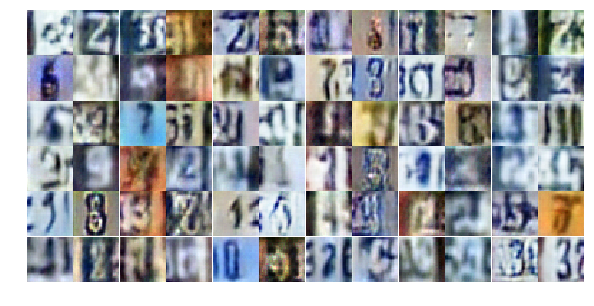

Epoch 9/25... Discriminator Loss: 1.4096... Generator Loss: 0.3692
Epoch 9/25... Discriminator Loss: 0.9427... Generator Loss: 3.9888
Epoch 9/25... Discriminator Loss: 0.6698... Generator Loss: 0.9946
Epoch 9/25... Discriminator Loss: 1.3683... Generator Loss: 0.4331
Epoch 9/25... Discriminator Loss: 0.8439... Generator Loss: 0.7730
Epoch 10/25... Discriminator Loss: 0.5555... Generator Loss: 1.1444
Epoch 10/25... Discriminator Loss: 0.4937... Generator Loss: 1.4293
Epoch 10/25... Discriminator Loss: 0.6753... Generator Loss: 0.9724
Epoch 10/25... Discriminator Loss: 1.6012... Generator Loss: 0.3346
Epoch 10/25... Discriminator Loss: 1.1000... Generator Loss: 1.5611


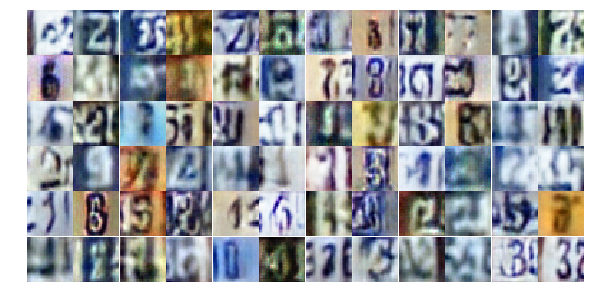

Epoch 10/25... Discriminator Loss: 1.4221... Generator Loss: 0.3908
Epoch 10/25... Discriminator Loss: 0.7512... Generator Loss: 0.8926
Epoch 10/25... Discriminator Loss: 0.5004... Generator Loss: 1.4508
Epoch 10/25... Discriminator Loss: 0.5327... Generator Loss: 1.7036
Epoch 10/25... Discriminator Loss: 0.5627... Generator Loss: 1.2080
Epoch 10/25... Discriminator Loss: 0.5856... Generator Loss: 1.2587
Epoch 10/25... Discriminator Loss: 0.6526... Generator Loss: 1.0007
Epoch 10/25... Discriminator Loss: 0.8438... Generator Loss: 0.7645
Epoch 10/25... Discriminator Loss: 1.4781... Generator Loss: 0.3720
Epoch 10/25... Discriminator Loss: 0.5491... Generator Loss: 1.3643


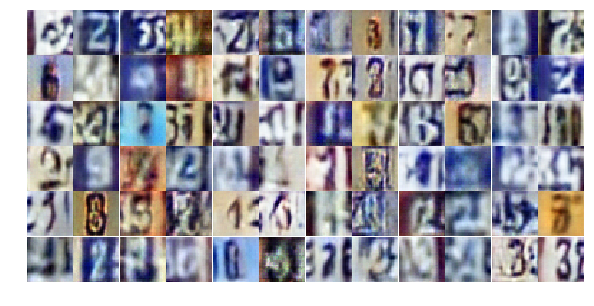

Epoch 10/25... Discriminator Loss: 0.5811... Generator Loss: 1.3341
Epoch 10/25... Discriminator Loss: 0.8875... Generator Loss: 0.7342
Epoch 10/25... Discriminator Loss: 0.7905... Generator Loss: 0.8012
Epoch 10/25... Discriminator Loss: 1.3799... Generator Loss: 0.4200
Epoch 10/25... Discriminator Loss: 0.4708... Generator Loss: 1.4513
Epoch 10/25... Discriminator Loss: 0.4686... Generator Loss: 1.3145
Epoch 10/25... Discriminator Loss: 0.8162... Generator Loss: 0.8060
Epoch 10/25... Discriminator Loss: 0.3491... Generator Loss: 2.7395
Epoch 10/25... Discriminator Loss: 0.5577... Generator Loss: 1.1955
Epoch 10/25... Discriminator Loss: 0.3584... Generator Loss: 2.7598


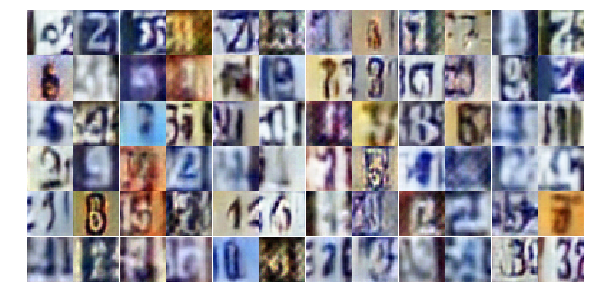

Epoch 10/25... Discriminator Loss: 1.0696... Generator Loss: 0.5522
Epoch 10/25... Discriminator Loss: 1.5579... Generator Loss: 0.3539
Epoch 10/25... Discriminator Loss: 0.4906... Generator Loss: 1.2419
Epoch 10/25... Discriminator Loss: 0.5734... Generator Loss: 1.4603
Epoch 10/25... Discriminator Loss: 1.2534... Generator Loss: 0.4682
Epoch 10/25... Discriminator Loss: 0.6539... Generator Loss: 1.0731
Epoch 10/25... Discriminator Loss: 0.4604... Generator Loss: 1.3044
Epoch 10/25... Discriminator Loss: 0.6363... Generator Loss: 1.1994
Epoch 10/25... Discriminator Loss: 0.5103... Generator Loss: 1.2289
Epoch 10/25... Discriminator Loss: 0.9106... Generator Loss: 0.7322


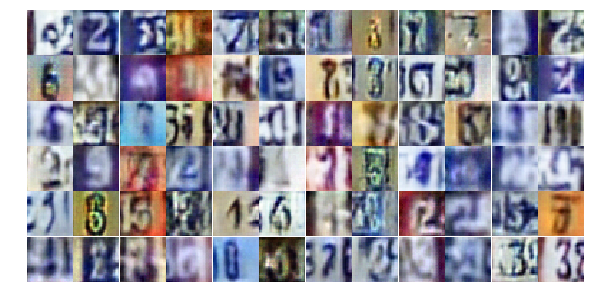

Epoch 10/25... Discriminator Loss: 0.5983... Generator Loss: 1.7078
Epoch 10/25... Discriminator Loss: 1.0463... Generator Loss: 0.5890
Epoch 10/25... Discriminator Loss: 0.4256... Generator Loss: 2.3932
Epoch 10/25... Discriminator Loss: 0.6862... Generator Loss: 1.1496
Epoch 10/25... Discriminator Loss: 0.6462... Generator Loss: 1.1922
Epoch 10/25... Discriminator Loss: 0.5644... Generator Loss: 1.2421
Epoch 10/25... Discriminator Loss: 0.5927... Generator Loss: 1.0886
Epoch 10/25... Discriminator Loss: 0.6365... Generator Loss: 1.0595
Epoch 10/25... Discriminator Loss: 0.5718... Generator Loss: 1.0713
Epoch 10/25... Discriminator Loss: 0.7269... Generator Loss: 0.9120


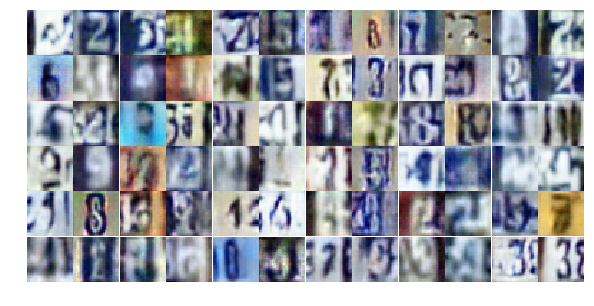

Epoch 10/25... Discriminator Loss: 0.7321... Generator Loss: 0.8942
Epoch 10/25... Discriminator Loss: 1.1377... Generator Loss: 0.6158
Epoch 10/25... Discriminator Loss: 0.7046... Generator Loss: 0.9827
Epoch 10/25... Discriminator Loss: 0.7931... Generator Loss: 0.8001
Epoch 10/25... Discriminator Loss: 0.4170... Generator Loss: 1.8614
Epoch 10/25... Discriminator Loss: 0.9907... Generator Loss: 0.6022
Epoch 10/25... Discriminator Loss: 0.5333... Generator Loss: 1.4201
Epoch 10/25... Discriminator Loss: 0.5717... Generator Loss: 2.6380
Epoch 10/25... Discriminator Loss: 0.3182... Generator Loss: 1.8753
Epoch 10/25... Discriminator Loss: 0.6558... Generator Loss: 1.0229


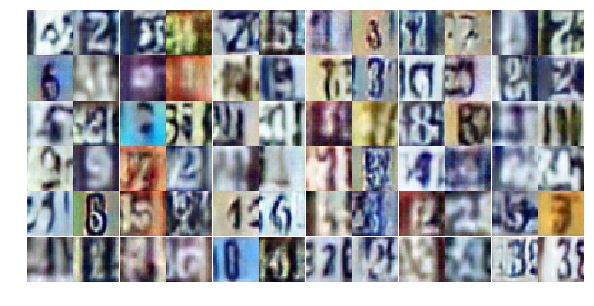

Epoch 10/25... Discriminator Loss: 1.0651... Generator Loss: 0.5787
Epoch 10/25... Discriminator Loss: 0.5052... Generator Loss: 1.4364
Epoch 10/25... Discriminator Loss: 0.6434... Generator Loss: 1.0445
Epoch 11/25... Discriminator Loss: 1.2787... Generator Loss: 0.5322
Epoch 11/25... Discriminator Loss: 0.6003... Generator Loss: 1.2129
Epoch 11/25... Discriminator Loss: 1.3857... Generator Loss: 0.3989
Epoch 11/25... Discriminator Loss: 0.7807... Generator Loss: 0.8209
Epoch 11/25... Discriminator Loss: 0.5552... Generator Loss: 1.5505
Epoch 11/25... Discriminator Loss: 1.6671... Generator Loss: 0.3057
Epoch 11/25... Discriminator Loss: 0.5863... Generator Loss: 1.2770


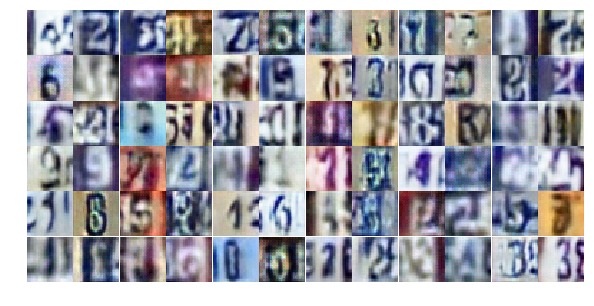

Epoch 11/25... Discriminator Loss: 0.3982... Generator Loss: 1.5069
Epoch 11/25... Discriminator Loss: 0.5019... Generator Loss: 1.2689
Epoch 11/25... Discriminator Loss: 0.3938... Generator Loss: 1.5714
Epoch 11/25... Discriminator Loss: 0.7056... Generator Loss: 0.9469
Epoch 11/25... Discriminator Loss: 0.6807... Generator Loss: 1.2561
Epoch 11/25... Discriminator Loss: 0.3459... Generator Loss: 1.8967
Epoch 11/25... Discriminator Loss: 0.5099... Generator Loss: 1.6266
Epoch 11/25... Discriminator Loss: 0.3061... Generator Loss: 2.3447
Epoch 11/25... Discriminator Loss: 1.4382... Generator Loss: 0.3691
Epoch 11/25... Discriminator Loss: 1.5780... Generator Loss: 0.3139


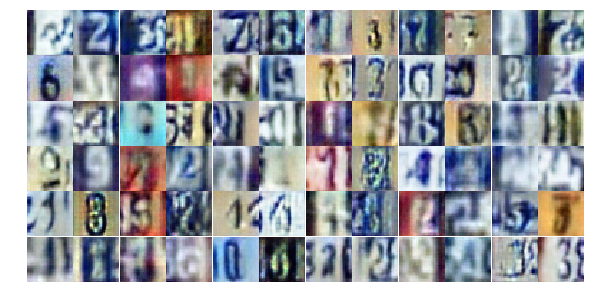

Epoch 11/25... Discriminator Loss: 0.8219... Generator Loss: 0.7825
Epoch 11/25... Discriminator Loss: 0.5182... Generator Loss: 1.5367
Epoch 11/25... Discriminator Loss: 0.8333... Generator Loss: 0.8012
Epoch 11/25... Discriminator Loss: 0.6518... Generator Loss: 1.0197
Epoch 11/25... Discriminator Loss: 0.3261... Generator Loss: 1.8294
Epoch 11/25... Discriminator Loss: 0.4095... Generator Loss: 1.5980
Epoch 11/25... Discriminator Loss: 0.4260... Generator Loss: 1.6690
Epoch 11/25... Discriminator Loss: 1.0869... Generator Loss: 0.5720
Epoch 11/25... Discriminator Loss: 0.4017... Generator Loss: 2.3232
Epoch 11/25... Discriminator Loss: 0.5873... Generator Loss: 1.1623


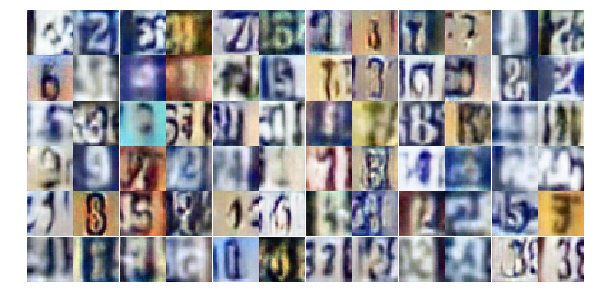

Epoch 11/25... Discriminator Loss: 0.8788... Generator Loss: 0.6955
Epoch 11/25... Discriminator Loss: 0.5991... Generator Loss: 1.2428
Epoch 11/25... Discriminator Loss: 0.6434... Generator Loss: 1.5494
Epoch 11/25... Discriminator Loss: 0.9081... Generator Loss: 4.4472
Epoch 11/25... Discriminator Loss: 0.6857... Generator Loss: 1.9157
Epoch 11/25... Discriminator Loss: 1.0017... Generator Loss: 0.6566
Epoch 11/25... Discriminator Loss: 1.4898... Generator Loss: 0.4013
Epoch 11/25... Discriminator Loss: 0.6883... Generator Loss: 1.1226
Epoch 11/25... Discriminator Loss: 0.5910... Generator Loss: 1.1468
Epoch 11/25... Discriminator Loss: 0.9453... Generator Loss: 0.7502


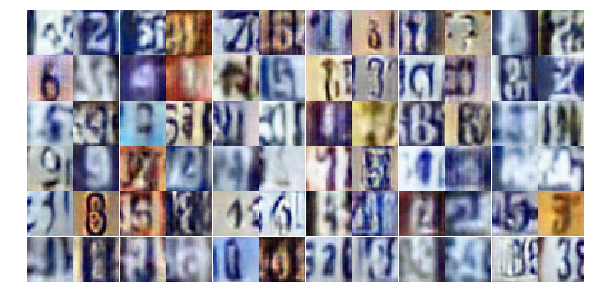

Epoch 11/25... Discriminator Loss: 0.5486... Generator Loss: 1.3305
Epoch 11/25... Discriminator Loss: 0.4423... Generator Loss: 1.4922
Epoch 11/25... Discriminator Loss: 0.5388... Generator Loss: 1.4290
Epoch 11/25... Discriminator Loss: 0.6702... Generator Loss: 1.0471
Epoch 11/25... Discriminator Loss: 0.7814... Generator Loss: 0.7839
Epoch 11/25... Discriminator Loss: 0.4613... Generator Loss: 1.4543
Epoch 11/25... Discriminator Loss: 0.4270... Generator Loss: 1.7548
Epoch 11/25... Discriminator Loss: 0.5834... Generator Loss: 1.9253
Epoch 11/25... Discriminator Loss: 1.7714... Generator Loss: 0.2520
Epoch 11/25... Discriminator Loss: 0.3986... Generator Loss: 1.8068


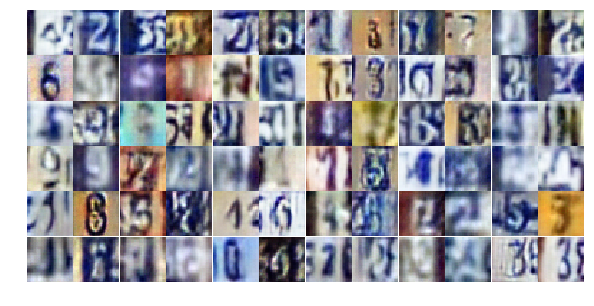

Epoch 11/25... Discriminator Loss: 0.8542... Generator Loss: 0.8160
Epoch 11/25... Discriminator Loss: 0.2817... Generator Loss: 1.8927
Epoch 11/25... Discriminator Loss: 0.4751... Generator Loss: 1.4838
Epoch 11/25... Discriminator Loss: 0.4920... Generator Loss: 1.1933
Epoch 11/25... Discriminator Loss: 1.3011... Generator Loss: 0.6088
Epoch 11/25... Discriminator Loss: 0.6042... Generator Loss: 1.0507
Epoch 11/25... Discriminator Loss: 0.8640... Generator Loss: 0.8160
Epoch 11/25... Discriminator Loss: 0.6067... Generator Loss: 1.2428
Epoch 11/25... Discriminator Loss: 0.7024... Generator Loss: 1.0609
Epoch 11/25... Discriminator Loss: 0.6569... Generator Loss: 1.0263


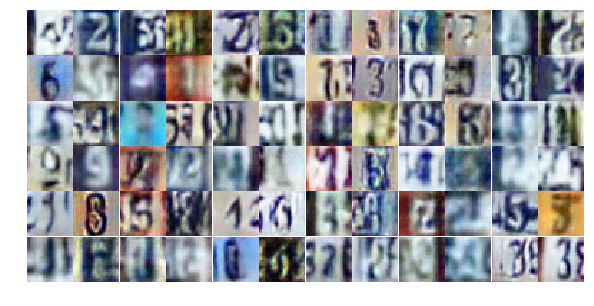

Epoch 12/25... Discriminator Loss: 0.6972... Generator Loss: 1.0053
Epoch 12/25... Discriminator Loss: 0.5382... Generator Loss: 1.8967
Epoch 12/25... Discriminator Loss: 0.8986... Generator Loss: 0.6884
Epoch 12/25... Discriminator Loss: 0.5015... Generator Loss: 1.4775
Epoch 12/25... Discriminator Loss: 0.3886... Generator Loss: 1.4593
Epoch 12/25... Discriminator Loss: 1.1611... Generator Loss: 0.5172
Epoch 12/25... Discriminator Loss: 0.8306... Generator Loss: 2.0792
Epoch 12/25... Discriminator Loss: 0.6529... Generator Loss: 1.0305
Epoch 12/25... Discriminator Loss: 0.6261... Generator Loss: 1.2352
Epoch 12/25... Discriminator Loss: 1.4088... Generator Loss: 0.4046


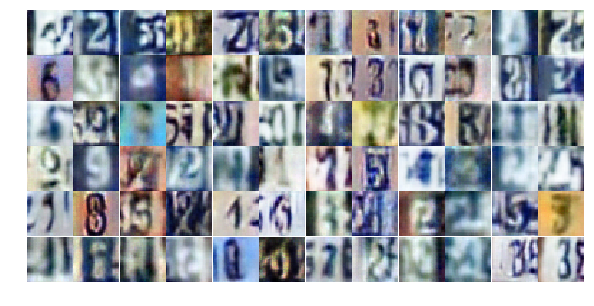

Epoch 12/25... Discriminator Loss: 0.5178... Generator Loss: 1.2557
Epoch 12/25... Discriminator Loss: 0.7164... Generator Loss: 0.9648
Epoch 12/25... Discriminator Loss: 0.4530... Generator Loss: 1.8897
Epoch 12/25... Discriminator Loss: 0.5577... Generator Loss: 1.3812
Epoch 12/25... Discriminator Loss: 0.4666... Generator Loss: 1.8557
Epoch 12/25... Discriminator Loss: 0.7342... Generator Loss: 0.9859
Epoch 12/25... Discriminator Loss: 1.8407... Generator Loss: 0.2732
Epoch 12/25... Discriminator Loss: 0.6395... Generator Loss: 3.0070
Epoch 12/25... Discriminator Loss: 0.6345... Generator Loss: 1.6448
Epoch 12/25... Discriminator Loss: 0.8432... Generator Loss: 0.8947


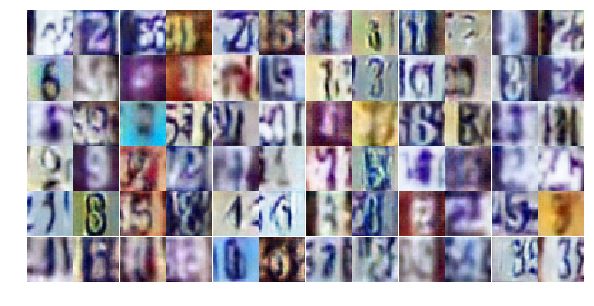

Epoch 12/25... Discriminator Loss: 0.4454... Generator Loss: 1.4910
Epoch 12/25... Discriminator Loss: 0.4281... Generator Loss: 1.7644
Epoch 12/25... Discriminator Loss: 0.6313... Generator Loss: 1.0249
Epoch 12/25... Discriminator Loss: 0.4882... Generator Loss: 1.4214
Epoch 12/25... Discriminator Loss: 0.3904... Generator Loss: 1.7156
Epoch 12/25... Discriminator Loss: 0.4379... Generator Loss: 1.4767
Epoch 12/25... Discriminator Loss: 0.5809... Generator Loss: 1.2536
Epoch 12/25... Discriminator Loss: 0.3898... Generator Loss: 1.5320
Epoch 12/25... Discriminator Loss: 0.4634... Generator Loss: 1.3959
Epoch 12/25... Discriminator Loss: 0.4929... Generator Loss: 1.3518


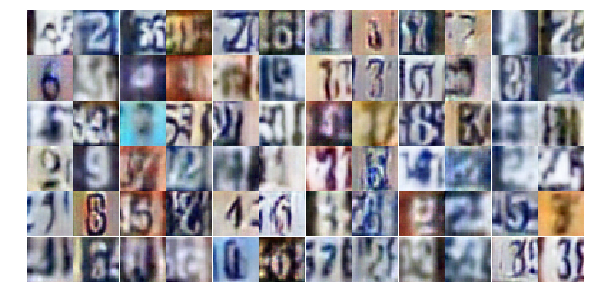

Epoch 12/25... Discriminator Loss: 0.6433... Generator Loss: 0.9529
Epoch 12/25... Discriminator Loss: 1.0838... Generator Loss: 0.5822
Epoch 12/25... Discriminator Loss: 0.5584... Generator Loss: 1.1642
Epoch 12/25... Discriminator Loss: 1.6362... Generator Loss: 0.3163
Epoch 12/25... Discriminator Loss: 0.7288... Generator Loss: 1.5221
Epoch 12/25... Discriminator Loss: 0.8949... Generator Loss: 0.7361
Epoch 12/25... Discriminator Loss: 1.2286... Generator Loss: 0.5534
Epoch 12/25... Discriminator Loss: 0.8920... Generator Loss: 0.7867
Epoch 12/25... Discriminator Loss: 0.4155... Generator Loss: 1.6039
Epoch 12/25... Discriminator Loss: 0.2090... Generator Loss: 2.1953


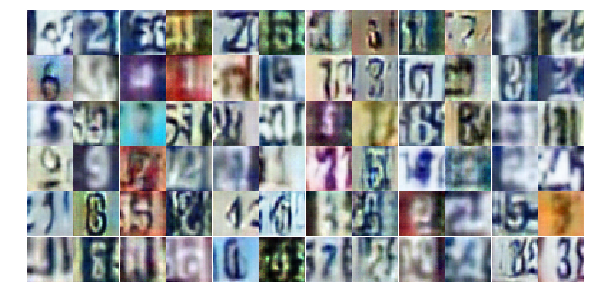

Epoch 12/25... Discriminator Loss: 0.5102... Generator Loss: 1.4066
Epoch 12/25... Discriminator Loss: 0.4373... Generator Loss: 1.3119
Epoch 12/25... Discriminator Loss: 0.4493... Generator Loss: 1.3461
Epoch 12/25... Discriminator Loss: 0.5963... Generator Loss: 1.3999
Epoch 12/25... Discriminator Loss: 1.7212... Generator Loss: 0.3302
Epoch 12/25... Discriminator Loss: 1.3527... Generator Loss: 0.4331
Epoch 12/25... Discriminator Loss: 0.5093... Generator Loss: 1.2735
Epoch 12/25... Discriminator Loss: 0.8133... Generator Loss: 0.8131
Epoch 12/25... Discriminator Loss: 0.4390... Generator Loss: 1.6220
Epoch 12/25... Discriminator Loss: 0.5434... Generator Loss: 1.2559


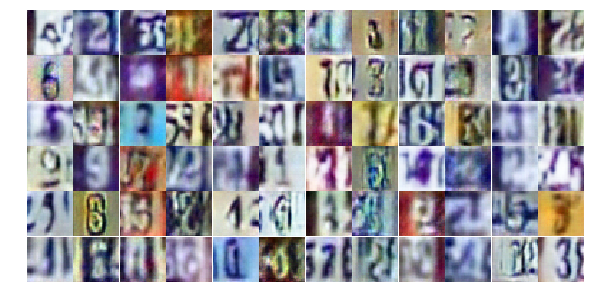

Epoch 12/25... Discriminator Loss: 0.9247... Generator Loss: 0.7032
Epoch 12/25... Discriminator Loss: 0.8241... Generator Loss: 0.8491
Epoch 12/25... Discriminator Loss: 0.5198... Generator Loss: 1.5420
Epoch 12/25... Discriminator Loss: 0.7952... Generator Loss: 0.9233
Epoch 12/25... Discriminator Loss: 0.4662... Generator Loss: 1.4195
Epoch 12/25... Discriminator Loss: 0.5470... Generator Loss: 1.6361
Epoch 12/25... Discriminator Loss: 0.7501... Generator Loss: 0.9343
Epoch 13/25... Discriminator Loss: 0.6042... Generator Loss: 1.1516
Epoch 13/25... Discriminator Loss: 0.4513... Generator Loss: 1.7572
Epoch 13/25... Discriminator Loss: 0.8851... Generator Loss: 0.7622


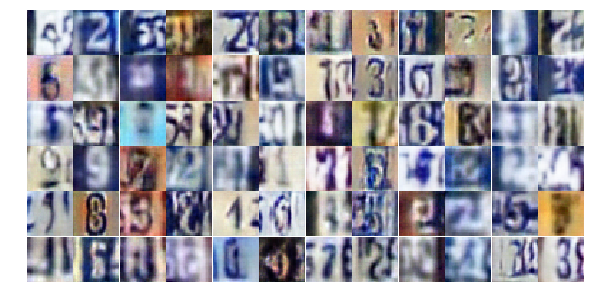

Epoch 13/25... Discriminator Loss: 0.4472... Generator Loss: 1.6350
Epoch 13/25... Discriminator Loss: 0.4469... Generator Loss: 2.1988
Epoch 13/25... Discriminator Loss: 1.0644... Generator Loss: 0.8465
Epoch 13/25... Discriminator Loss: 0.6570... Generator Loss: 1.0349
Epoch 13/25... Discriminator Loss: 0.6224... Generator Loss: 1.0671
Epoch 13/25... Discriminator Loss: 0.5385... Generator Loss: 1.2133
Epoch 13/25... Discriminator Loss: 0.3225... Generator Loss: 2.0125
Epoch 13/25... Discriminator Loss: 0.5938... Generator Loss: 1.2128
Epoch 13/25... Discriminator Loss: 0.4164... Generator Loss: 1.5366
Epoch 13/25... Discriminator Loss: 0.5129... Generator Loss: 2.5481


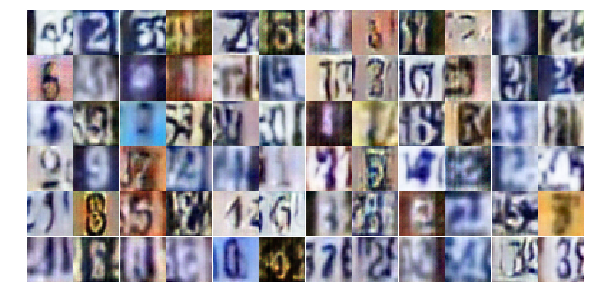

Epoch 13/25... Discriminator Loss: 0.5387... Generator Loss: 1.6545
Epoch 13/25... Discriminator Loss: 0.4545... Generator Loss: 1.6095
Epoch 13/25... Discriminator Loss: 1.6920... Generator Loss: 4.6175
Epoch 13/25... Discriminator Loss: 1.0270... Generator Loss: 0.7051
Epoch 13/25... Discriminator Loss: 0.4872... Generator Loss: 1.4602
Epoch 13/25... Discriminator Loss: 0.9581... Generator Loss: 0.6799
Epoch 13/25... Discriminator Loss: 0.6049... Generator Loss: 1.1874
Epoch 13/25... Discriminator Loss: 0.8454... Generator Loss: 0.8539
Epoch 13/25... Discriminator Loss: 0.6034... Generator Loss: 1.3166
Epoch 13/25... Discriminator Loss: 0.7863... Generator Loss: 0.8357


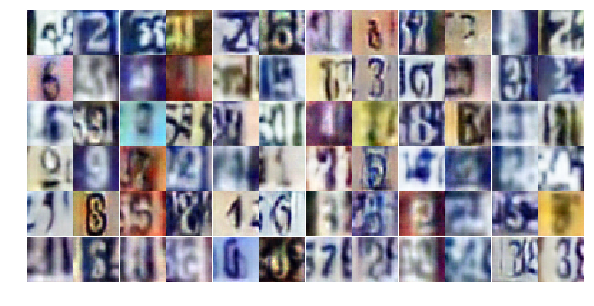

Epoch 13/25... Discriminator Loss: 0.5796... Generator Loss: 1.1534
Epoch 13/25... Discriminator Loss: 0.4271... Generator Loss: 1.8909
Epoch 13/25... Discriminator Loss: 0.6222... Generator Loss: 1.0376
Epoch 13/25... Discriminator Loss: 0.6769... Generator Loss: 0.9613
Epoch 13/25... Discriminator Loss: 0.4240... Generator Loss: 1.4432
Epoch 13/25... Discriminator Loss: 1.1269... Generator Loss: 0.5900
Epoch 13/25... Discriminator Loss: 0.8307... Generator Loss: 1.2296
Epoch 13/25... Discriminator Loss: 0.5554... Generator Loss: 1.2085
Epoch 13/25... Discriminator Loss: 0.5317... Generator Loss: 1.3137
Epoch 13/25... Discriminator Loss: 0.5784... Generator Loss: 1.2678


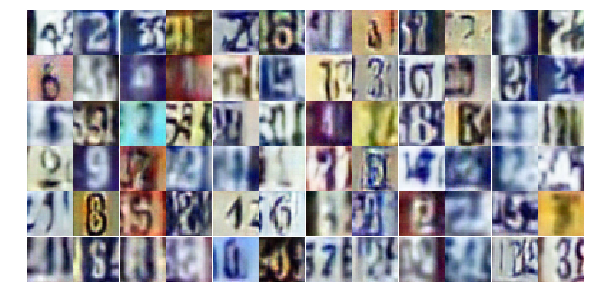

Epoch 13/25... Discriminator Loss: 0.8542... Generator Loss: 0.6992
Epoch 13/25... Discriminator Loss: 0.9212... Generator Loss: 0.7470
Epoch 13/25... Discriminator Loss: 0.6046... Generator Loss: 1.1313
Epoch 13/25... Discriminator Loss: 1.0554... Generator Loss: 0.6076
Epoch 13/25... Discriminator Loss: 0.4922... Generator Loss: 1.3080
Epoch 13/25... Discriminator Loss: 0.3338... Generator Loss: 1.9491
Epoch 13/25... Discriminator Loss: 0.4866... Generator Loss: 1.4526
Epoch 13/25... Discriminator Loss: 0.7465... Generator Loss: 0.9798
Epoch 13/25... Discriminator Loss: 0.7368... Generator Loss: 0.9198
Epoch 13/25... Discriminator Loss: 0.5545... Generator Loss: 1.5072


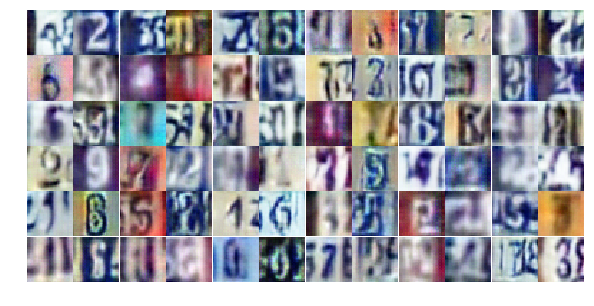

Epoch 13/25... Discriminator Loss: 0.5399... Generator Loss: 1.4587
Epoch 13/25... Discriminator Loss: 1.5111... Generator Loss: 0.9461
Epoch 13/25... Discriminator Loss: 0.6940... Generator Loss: 1.1390
Epoch 13/25... Discriminator Loss: 0.7438... Generator Loss: 0.9158
Epoch 13/25... Discriminator Loss: 1.4212... Generator Loss: 0.3913
Epoch 13/25... Discriminator Loss: 0.6504... Generator Loss: 1.0905
Epoch 13/25... Discriminator Loss: 0.6569... Generator Loss: 1.0772
Epoch 13/25... Discriminator Loss: 0.6770... Generator Loss: 0.9709
Epoch 13/25... Discriminator Loss: 0.6322... Generator Loss: 0.9934
Epoch 13/25... Discriminator Loss: 1.1997... Generator Loss: 0.4835


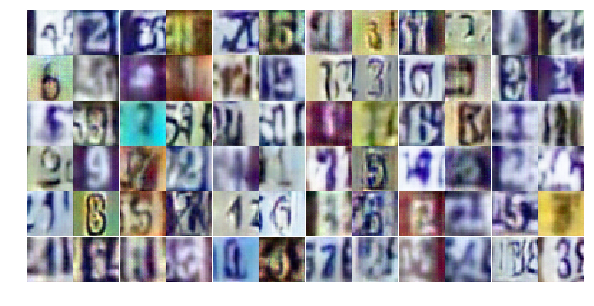

Epoch 13/25... Discriminator Loss: 0.3368... Generator Loss: 1.9720
Epoch 13/25... Discriminator Loss: 0.7635... Generator Loss: 0.9870
Epoch 13/25... Discriminator Loss: 0.7073... Generator Loss: 0.9556
Epoch 13/25... Discriminator Loss: 0.7416... Generator Loss: 0.8662
Epoch 14/25... Discriminator Loss: 1.0485... Generator Loss: 0.5382
Epoch 14/25... Discriminator Loss: 0.6562... Generator Loss: 1.1566
Epoch 14/25... Discriminator Loss: 0.6323... Generator Loss: 1.6556
Epoch 14/25... Discriminator Loss: 0.4429... Generator Loss: 1.9133
Epoch 14/25... Discriminator Loss: 0.5455... Generator Loss: 1.1856
Epoch 14/25... Discriminator Loss: 0.9852... Generator Loss: 0.7135


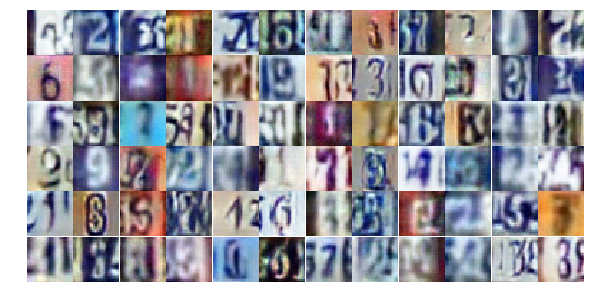

Epoch 14/25... Discriminator Loss: 0.6208... Generator Loss: 1.4781
Epoch 14/25... Discriminator Loss: 0.7477... Generator Loss: 0.8287
Epoch 14/25... Discriminator Loss: 0.5729... Generator Loss: 1.0751
Epoch 14/25... Discriminator Loss: 0.7547... Generator Loss: 1.0554
Epoch 14/25... Discriminator Loss: 1.4256... Generator Loss: 0.4287
Epoch 14/25... Discriminator Loss: 0.3277... Generator Loss: 1.7276
Epoch 14/25... Discriminator Loss: 0.3126... Generator Loss: 2.0295
Epoch 14/25... Discriminator Loss: 1.3269... Generator Loss: 0.4774
Epoch 14/25... Discriminator Loss: 0.9708... Generator Loss: 0.7229
Epoch 14/25... Discriminator Loss: 5.6755... Generator Loss: 0.0062


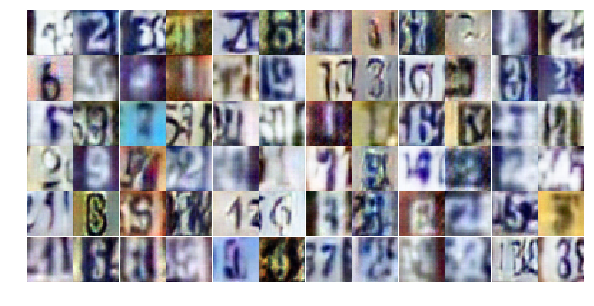

Epoch 14/25... Discriminator Loss: 0.3519... Generator Loss: 2.6434
Epoch 14/25... Discriminator Loss: 0.7157... Generator Loss: 3.1242
Epoch 14/25... Discriminator Loss: 0.9058... Generator Loss: 0.9037
Epoch 14/25... Discriminator Loss: 0.5055... Generator Loss: 1.4377
Epoch 14/25... Discriminator Loss: 0.9767... Generator Loss: 0.7600
Epoch 14/25... Discriminator Loss: 1.0210... Generator Loss: 0.6447
Epoch 14/25... Discriminator Loss: 0.6188... Generator Loss: 1.2695
Epoch 14/25... Discriminator Loss: 0.5803... Generator Loss: 1.1640
Epoch 14/25... Discriminator Loss: 0.4857... Generator Loss: 1.2788
Epoch 14/25... Discriminator Loss: 0.5550... Generator Loss: 1.1103


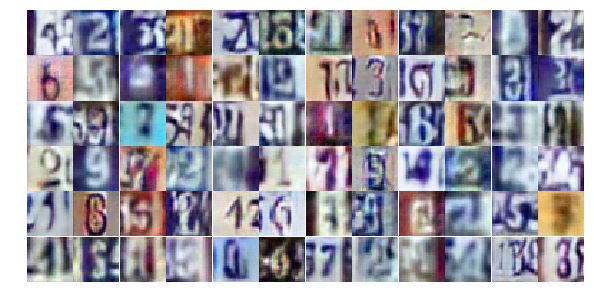

Epoch 14/25... Discriminator Loss: 1.1101... Generator Loss: 0.5795
Epoch 14/25... Discriminator Loss: 0.4500... Generator Loss: 1.3789
Epoch 14/25... Discriminator Loss: 0.6585... Generator Loss: 1.0093
Epoch 14/25... Discriminator Loss: 0.3054... Generator Loss: 1.7379
Epoch 14/25... Discriminator Loss: 0.4893... Generator Loss: 1.5893
Epoch 14/25... Discriminator Loss: 0.5278... Generator Loss: 1.2799
Epoch 14/25... Discriminator Loss: 0.6002... Generator Loss: 1.4342
Epoch 14/25... Discriminator Loss: 0.4039... Generator Loss: 1.7115
Epoch 14/25... Discriminator Loss: 0.4316... Generator Loss: 2.5147
Epoch 14/25... Discriminator Loss: 0.9167... Generator Loss: 0.7465


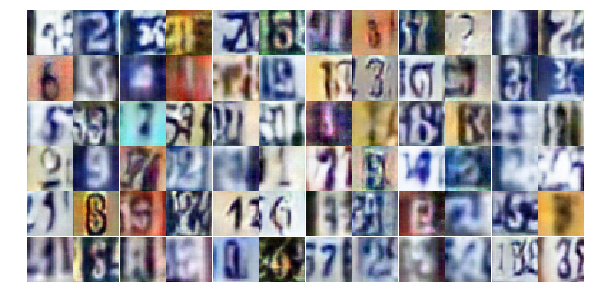

Epoch 14/25... Discriminator Loss: 0.9291... Generator Loss: 0.7065
Epoch 14/25... Discriminator Loss: 0.8157... Generator Loss: 0.8312
Epoch 14/25... Discriminator Loss: 0.9918... Generator Loss: 0.6250
Epoch 14/25... Discriminator Loss: 1.1240... Generator Loss: 0.5290
Epoch 14/25... Discriminator Loss: 0.6008... Generator Loss: 1.0909
Epoch 14/25... Discriminator Loss: 0.7279... Generator Loss: 1.2645
Epoch 14/25... Discriminator Loss: 0.8375... Generator Loss: 0.7784
Epoch 14/25... Discriminator Loss: 0.4767... Generator Loss: 1.3378
Epoch 14/25... Discriminator Loss: 1.2284... Generator Loss: 0.6042
Epoch 14/25... Discriminator Loss: 0.8148... Generator Loss: 0.9826


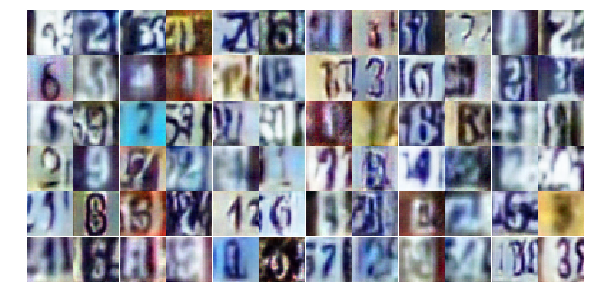

Epoch 14/25... Discriminator Loss: 0.6538... Generator Loss: 1.5685
Epoch 14/25... Discriminator Loss: 0.9553... Generator Loss: 0.6766
Epoch 14/25... Discriminator Loss: 0.5739... Generator Loss: 1.0936
Epoch 14/25... Discriminator Loss: 0.8100... Generator Loss: 0.8371
Epoch 14/25... Discriminator Loss: 0.4041... Generator Loss: 1.5019
Epoch 14/25... Discriminator Loss: 0.6224... Generator Loss: 1.1857
Epoch 14/25... Discriminator Loss: 1.1161... Generator Loss: 3.2944
Epoch 14/25... Discriminator Loss: 1.5713... Generator Loss: 2.8674
Epoch 14/25... Discriminator Loss: 1.3189... Generator Loss: 1.7036
Epoch 14/25... Discriminator Loss: 1.4982... Generator Loss: 0.3568


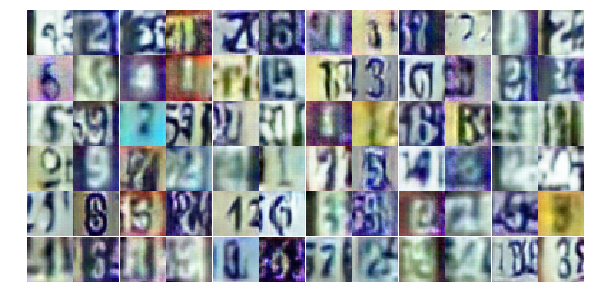

Epoch 14/25... Discriminator Loss: 1.0539... Generator Loss: 0.6373
Epoch 14/25... Discriminator Loss: 1.0646... Generator Loss: 0.5986
Epoch 15/25... Discriminator Loss: 0.6284... Generator Loss: 1.0365
Epoch 15/25... Discriminator Loss: 0.4999... Generator Loss: 1.2827
Epoch 15/25... Discriminator Loss: 0.6174... Generator Loss: 1.8147
Epoch 15/25... Discriminator Loss: 0.7861... Generator Loss: 0.9744
Epoch 15/25... Discriminator Loss: 0.6701... Generator Loss: 1.0173
Epoch 15/25... Discriminator Loss: 0.8447... Generator Loss: 0.7176
Epoch 15/25... Discriminator Loss: 1.3949... Generator Loss: 0.4000
Epoch 15/25... Discriminator Loss: 0.4424... Generator Loss: 1.4153


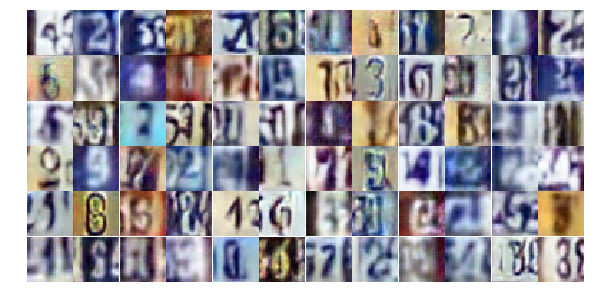

Epoch 15/25... Discriminator Loss: 0.5625... Generator Loss: 1.2471
Epoch 15/25... Discriminator Loss: 0.6687... Generator Loss: 1.6062
Epoch 15/25... Discriminator Loss: 0.7262... Generator Loss: 0.9156
Epoch 15/25... Discriminator Loss: 0.6189... Generator Loss: 1.1226
Epoch 15/25... Discriminator Loss: 0.8345... Generator Loss: 0.9000
Epoch 15/25... Discriminator Loss: 0.3875... Generator Loss: 1.7020
Epoch 15/25... Discriminator Loss: 1.4961... Generator Loss: 0.3239
Epoch 15/25... Discriminator Loss: 0.8558... Generator Loss: 1.7334
Epoch 15/25... Discriminator Loss: 0.8092... Generator Loss: 3.3385
Epoch 15/25... Discriminator Loss: 0.9266... Generator Loss: 0.7499


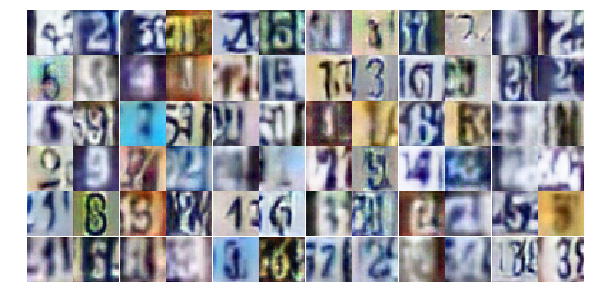

Epoch 15/25... Discriminator Loss: 0.6764... Generator Loss: 1.3273
Epoch 15/25... Discriminator Loss: 0.4756... Generator Loss: 1.6070
Epoch 15/25... Discriminator Loss: 0.4708... Generator Loss: 1.5187
Epoch 15/25... Discriminator Loss: 1.0589... Generator Loss: 0.5989
Epoch 15/25... Discriminator Loss: 0.8818... Generator Loss: 0.8333
Epoch 15/25... Discriminator Loss: 0.5229... Generator Loss: 1.3212
Epoch 15/25... Discriminator Loss: 0.7642... Generator Loss: 0.9678
Epoch 15/25... Discriminator Loss: 0.9899... Generator Loss: 0.8005
Epoch 15/25... Discriminator Loss: 0.7661... Generator Loss: 0.8722
Epoch 15/25... Discriminator Loss: 1.1226... Generator Loss: 0.5896


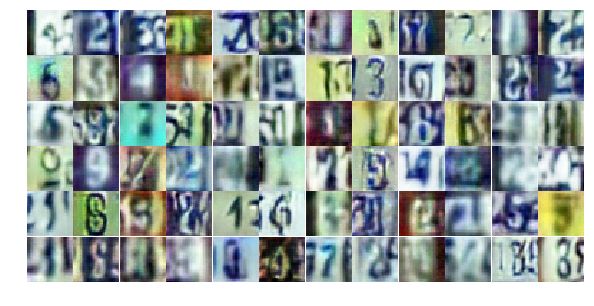

Epoch 15/25... Discriminator Loss: 0.7723... Generator Loss: 0.8697
Epoch 15/25... Discriminator Loss: 0.6265... Generator Loss: 1.4720
Epoch 15/25... Discriminator Loss: 0.5199... Generator Loss: 1.1054
Epoch 15/25... Discriminator Loss: 0.5498... Generator Loss: 1.1796
Epoch 15/25... Discriminator Loss: 0.7964... Generator Loss: 0.8396
Epoch 15/25... Discriminator Loss: 1.0313... Generator Loss: 2.8873
Epoch 15/25... Discriminator Loss: 0.5895... Generator Loss: 1.2795
Epoch 15/25... Discriminator Loss: 0.7364... Generator Loss: 0.9071
Epoch 15/25... Discriminator Loss: 0.5331... Generator Loss: 1.2376
Epoch 15/25... Discriminator Loss: 0.5470... Generator Loss: 1.3596


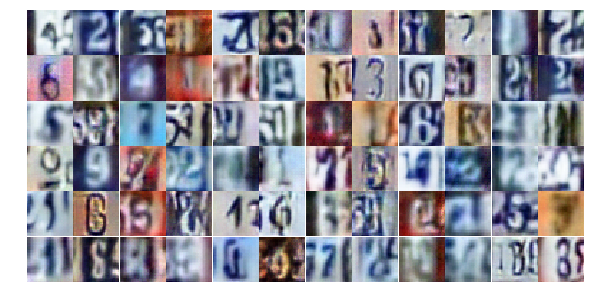

Epoch 15/25... Discriminator Loss: 0.5248... Generator Loss: 1.2398
Epoch 15/25... Discriminator Loss: 0.8766... Generator Loss: 0.7273
Epoch 15/25... Discriminator Loss: 0.5827... Generator Loss: 1.2116
Epoch 15/25... Discriminator Loss: 0.4006... Generator Loss: 1.4819
Epoch 15/25... Discriminator Loss: 0.6722... Generator Loss: 0.9226
Epoch 15/25... Discriminator Loss: 1.7945... Generator Loss: 0.2654
Epoch 15/25... Discriminator Loss: 0.6233... Generator Loss: 2.7754
Epoch 15/25... Discriminator Loss: 0.5552... Generator Loss: 1.5187
Epoch 15/25... Discriminator Loss: 0.8793... Generator Loss: 0.7247
Epoch 15/25... Discriminator Loss: 0.9409... Generator Loss: 0.7093


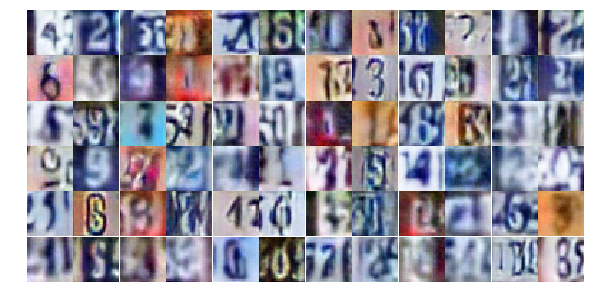

Epoch 15/25... Discriminator Loss: 1.3577... Generator Loss: 0.4070
Epoch 15/25... Discriminator Loss: 0.6701... Generator Loss: 1.1045
Epoch 15/25... Discriminator Loss: 0.4237... Generator Loss: 1.6032
Epoch 15/25... Discriminator Loss: 1.0933... Generator Loss: 0.8966
Epoch 15/25... Discriminator Loss: 1.3236... Generator Loss: 0.5212
Epoch 15/25... Discriminator Loss: 1.4801... Generator Loss: 2.2190
Epoch 15/25... Discriminator Loss: 0.9265... Generator Loss: 0.7918
Epoch 15/25... Discriminator Loss: 0.5741... Generator Loss: 1.4215
Epoch 15/25... Discriminator Loss: 1.5195... Generator Loss: 0.3654
Epoch 16/25... Discriminator Loss: 1.0405... Generator Loss: 0.6530


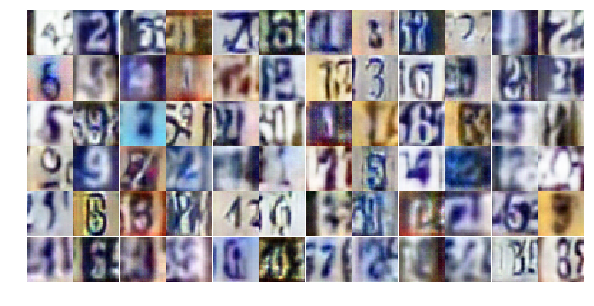

Epoch 16/25... Discriminator Loss: 0.7123... Generator Loss: 1.0648
Epoch 16/25... Discriminator Loss: 0.6107... Generator Loss: 1.1679
Epoch 16/25... Discriminator Loss: 0.8942... Generator Loss: 0.7535
Epoch 16/25... Discriminator Loss: 0.6767... Generator Loss: 1.1975
Epoch 16/25... Discriminator Loss: 0.5260... Generator Loss: 1.6829
Epoch 16/25... Discriminator Loss: 0.5907... Generator Loss: 1.6440
Epoch 16/25... Discriminator Loss: 1.6019... Generator Loss: 0.3430
Epoch 16/25... Discriminator Loss: 1.1374... Generator Loss: 0.5910
Epoch 16/25... Discriminator Loss: 0.4595... Generator Loss: 1.4589
Epoch 16/25... Discriminator Loss: 0.5551... Generator Loss: 1.1411


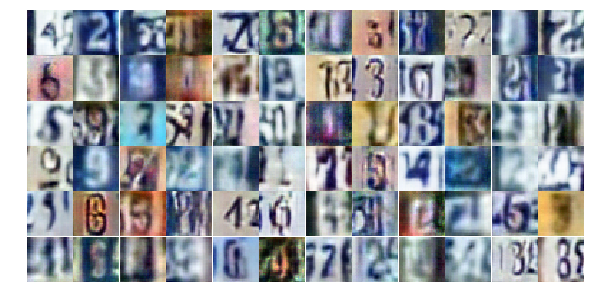

Epoch 16/25... Discriminator Loss: 1.4089... Generator Loss: 0.4183
Epoch 16/25... Discriminator Loss: 0.6488... Generator Loss: 1.9073
Epoch 16/25... Discriminator Loss: 0.7661... Generator Loss: 0.9085
Epoch 16/25... Discriminator Loss: 1.0515... Generator Loss: 0.5876
Epoch 16/25... Discriminator Loss: 0.5305... Generator Loss: 1.1342
Epoch 16/25... Discriminator Loss: 0.5417... Generator Loss: 1.2249
Epoch 16/25... Discriminator Loss: 0.9909... Generator Loss: 0.6610
Epoch 16/25... Discriminator Loss: 0.4670... Generator Loss: 1.4062
Epoch 16/25... Discriminator Loss: 0.4173... Generator Loss: 1.7165
Epoch 16/25... Discriminator Loss: 0.5081... Generator Loss: 1.4652


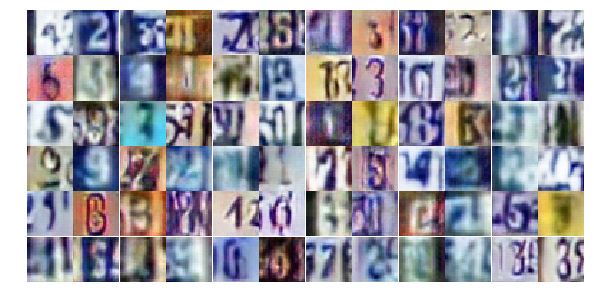

Epoch 16/25... Discriminator Loss: 0.5483... Generator Loss: 1.3163
Epoch 16/25... Discriminator Loss: 0.6265... Generator Loss: 1.1129
Epoch 16/25... Discriminator Loss: 0.6124... Generator Loss: 1.0500
Epoch 16/25... Discriminator Loss: 1.1037... Generator Loss: 0.5621
Epoch 16/25... Discriminator Loss: 1.0105... Generator Loss: 0.6425
Epoch 16/25... Discriminator Loss: 1.1205... Generator Loss: 0.5408
Epoch 16/25... Discriminator Loss: 0.5414... Generator Loss: 1.2606
Epoch 16/25... Discriminator Loss: 0.3907... Generator Loss: 1.6615
Epoch 16/25... Discriminator Loss: 0.8479... Generator Loss: 0.9097
Epoch 16/25... Discriminator Loss: 0.4870... Generator Loss: 1.3580


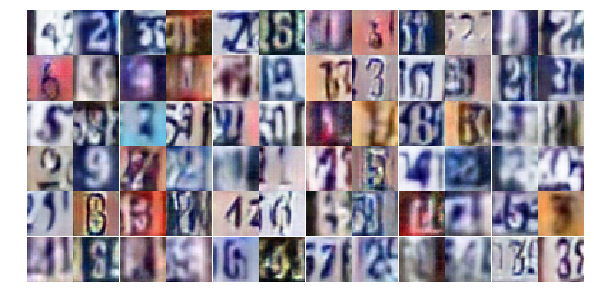

Epoch 16/25... Discriminator Loss: 0.8159... Generator Loss: 0.7675
Epoch 16/25... Discriminator Loss: 0.4707... Generator Loss: 1.3783
Epoch 16/25... Discriminator Loss: 0.4666... Generator Loss: 1.4648
Epoch 16/25... Discriminator Loss: 0.7018... Generator Loss: 1.8850
Epoch 16/25... Discriminator Loss: 1.0524... Generator Loss: 0.6279
Epoch 16/25... Discriminator Loss: 0.7777... Generator Loss: 0.8747
Epoch 16/25... Discriminator Loss: 0.8329... Generator Loss: 0.7971
Epoch 16/25... Discriminator Loss: 0.9888... Generator Loss: 0.6259
Epoch 16/25... Discriminator Loss: 1.1848... Generator Loss: 0.5232
Epoch 16/25... Discriminator Loss: 0.3860... Generator Loss: 1.8733


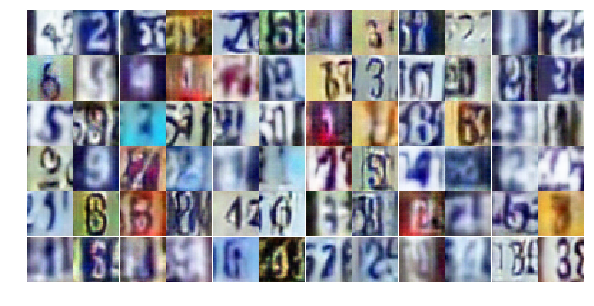

Epoch 16/25... Discriminator Loss: 0.5223... Generator Loss: 1.2371
Epoch 16/25... Discriminator Loss: 0.5612... Generator Loss: 1.2270
Epoch 16/25... Discriminator Loss: 1.6021... Generator Loss: 0.4083
Epoch 16/25... Discriminator Loss: 1.0385... Generator Loss: 0.6787
Epoch 16/25... Discriminator Loss: 0.9641... Generator Loss: 0.7361
Epoch 16/25... Discriminator Loss: 0.8070... Generator Loss: 1.0301
Epoch 16/25... Discriminator Loss: 0.4867... Generator Loss: 1.3936
Epoch 16/25... Discriminator Loss: 0.9279... Generator Loss: 0.6645
Epoch 16/25... Discriminator Loss: 0.5631... Generator Loss: 1.1322
Epoch 16/25... Discriminator Loss: 0.7635... Generator Loss: 0.8411


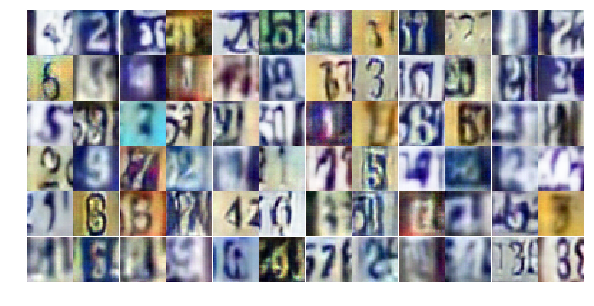

Epoch 16/25... Discriminator Loss: 1.9157... Generator Loss: 0.2228
Epoch 16/25... Discriminator Loss: 2.8917... Generator Loss: 4.3770
Epoch 16/25... Discriminator Loss: 2.0054... Generator Loss: 0.3712
Epoch 16/25... Discriminator Loss: 0.4940... Generator Loss: 1.4410
Epoch 16/25... Discriminator Loss: 0.7812... Generator Loss: 0.8939
Epoch 16/25... Discriminator Loss: 0.6136... Generator Loss: 1.1413
Epoch 17/25... Discriminator Loss: 0.6939... Generator Loss: 1.0688
Epoch 17/25... Discriminator Loss: 0.7695... Generator Loss: 0.9261
Epoch 17/25... Discriminator Loss: 0.7355... Generator Loss: 0.9654
Epoch 17/25... Discriminator Loss: 0.6708... Generator Loss: 1.1957


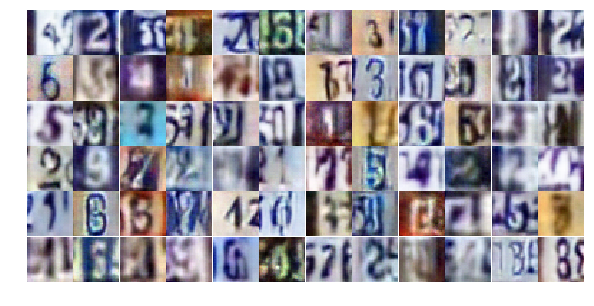

Epoch 17/25... Discriminator Loss: 0.5242... Generator Loss: 1.6186
Epoch 17/25... Discriminator Loss: 0.6331... Generator Loss: 1.1403
Epoch 17/25... Discriminator Loss: 0.6408... Generator Loss: 1.4133
Epoch 17/25... Discriminator Loss: 0.7853... Generator Loss: 0.8212
Epoch 17/25... Discriminator Loss: 0.9105... Generator Loss: 0.7668
Epoch 17/25... Discriminator Loss: 0.9930... Generator Loss: 0.6782
Epoch 17/25... Discriminator Loss: 0.7665... Generator Loss: 0.8494
Epoch 17/25... Discriminator Loss: 0.6226... Generator Loss: 1.0410
Epoch 17/25... Discriminator Loss: 0.4222... Generator Loss: 1.5769
Epoch 17/25... Discriminator Loss: 0.6062... Generator Loss: 1.2018


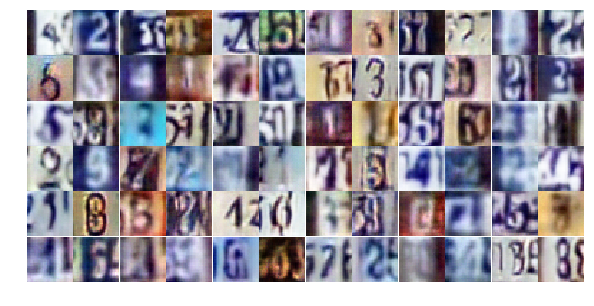

Epoch 17/25... Discriminator Loss: 0.8033... Generator Loss: 0.8955
Epoch 17/25... Discriminator Loss: 0.8630... Generator Loss: 0.7869
Epoch 17/25... Discriminator Loss: 0.6536... Generator Loss: 1.0544
Epoch 17/25... Discriminator Loss: 1.2505... Generator Loss: 0.7978
Epoch 17/25... Discriminator Loss: 0.6496... Generator Loss: 1.2860
Epoch 17/25... Discriminator Loss: 1.1103... Generator Loss: 0.5456
Epoch 17/25... Discriminator Loss: 0.4918... Generator Loss: 1.7438
Epoch 17/25... Discriminator Loss: 0.6177... Generator Loss: 1.2504
Epoch 17/25... Discriminator Loss: 0.7124... Generator Loss: 0.9950
Epoch 17/25... Discriminator Loss: 0.5408... Generator Loss: 1.1480


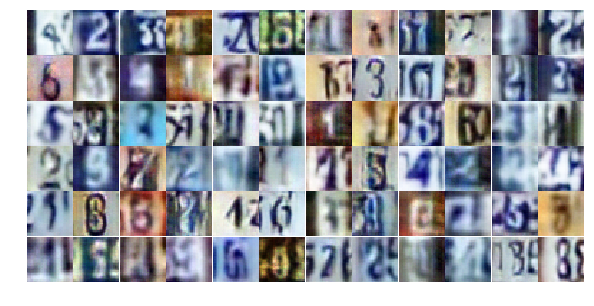

Epoch 17/25... Discriminator Loss: 1.2339... Generator Loss: 0.4707
Epoch 17/25... Discriminator Loss: 0.3823... Generator Loss: 2.0010
Epoch 17/25... Discriminator Loss: 0.3256... Generator Loss: 1.8364
Epoch 17/25... Discriminator Loss: 1.2787... Generator Loss: 0.4982
Epoch 17/25... Discriminator Loss: 0.7801... Generator Loss: 0.8826
Epoch 17/25... Discriminator Loss: 0.6358... Generator Loss: 1.0785
Epoch 17/25... Discriminator Loss: 0.7172... Generator Loss: 0.9235
Epoch 17/25... Discriminator Loss: 1.0343... Generator Loss: 0.6666
Epoch 17/25... Discriminator Loss: 1.0115... Generator Loss: 0.6506
Epoch 17/25... Discriminator Loss: 0.5565... Generator Loss: 1.2897


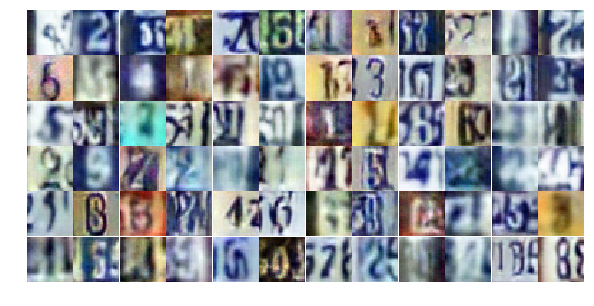

Epoch 17/25... Discriminator Loss: 0.4540... Generator Loss: 1.6555
Epoch 17/25... Discriminator Loss: 1.0036... Generator Loss: 0.7092
Epoch 17/25... Discriminator Loss: 0.5562... Generator Loss: 1.4206
Epoch 17/25... Discriminator Loss: 0.7048... Generator Loss: 1.5475
Epoch 17/25... Discriminator Loss: 0.9727... Generator Loss: 0.6763
Epoch 17/25... Discriminator Loss: 0.4593... Generator Loss: 1.4843
Epoch 17/25... Discriminator Loss: 0.8757... Generator Loss: 0.8368
Epoch 17/25... Discriminator Loss: 0.6777... Generator Loss: 0.9867
Epoch 17/25... Discriminator Loss: 0.3785... Generator Loss: 1.6373
Epoch 17/25... Discriminator Loss: 0.7164... Generator Loss: 0.8860


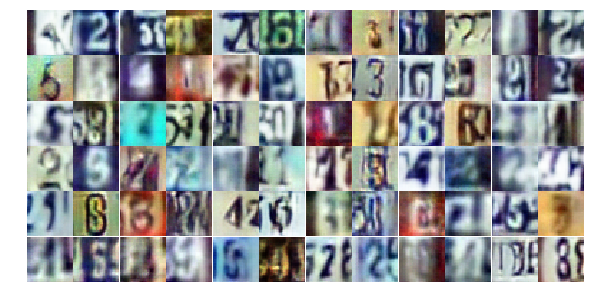

Epoch 17/25... Discriminator Loss: 1.3606... Generator Loss: 0.4724
Epoch 17/25... Discriminator Loss: 0.3022... Generator Loss: 1.7420
Epoch 17/25... Discriminator Loss: 0.7305... Generator Loss: 1.3281
Epoch 17/25... Discriminator Loss: 0.4192... Generator Loss: 2.3858
Epoch 17/25... Discriminator Loss: 1.0311... Generator Loss: 0.6951
Epoch 17/25... Discriminator Loss: 0.9805... Generator Loss: 0.6625
Epoch 17/25... Discriminator Loss: 1.0711... Generator Loss: 0.6239
Epoch 17/25... Discriminator Loss: 0.5999... Generator Loss: 1.0910
Epoch 17/25... Discriminator Loss: 1.0688... Generator Loss: 0.6971
Epoch 17/25... Discriminator Loss: 1.1012... Generator Loss: 0.6215


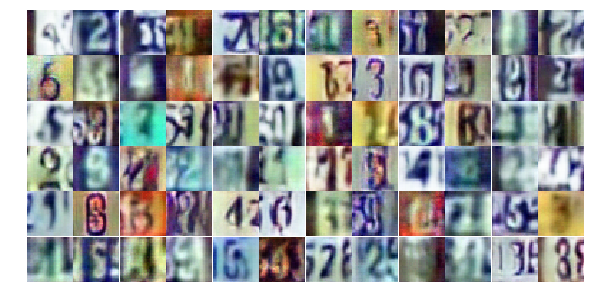

Epoch 17/25... Discriminator Loss: 0.6874... Generator Loss: 1.4136
Epoch 17/25... Discriminator Loss: 0.8800... Generator Loss: 0.7583
Epoch 17/25... Discriminator Loss: 0.3110... Generator Loss: 1.8676
Epoch 17/25... Discriminator Loss: 0.6979... Generator Loss: 0.9213
Epoch 18/25... Discriminator Loss: 1.0160... Generator Loss: 0.6782
Epoch 18/25... Discriminator Loss: 1.1134... Generator Loss: 0.5820
Epoch 18/25... Discriminator Loss: 0.6508... Generator Loss: 1.1285
Epoch 18/25... Discriminator Loss: 0.5189... Generator Loss: 1.3374
Epoch 18/25... Discriminator Loss: 1.4883... Generator Loss: 0.3819
Epoch 18/25... Discriminator Loss: 0.7706... Generator Loss: 0.9268


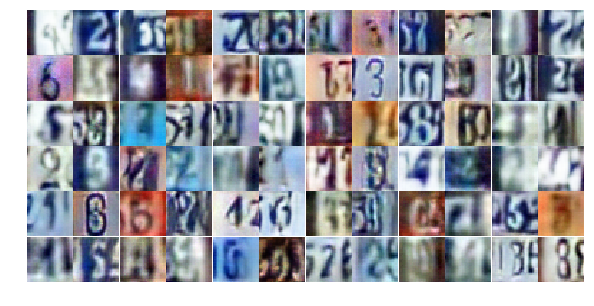

Epoch 18/25... Discriminator Loss: 0.6635... Generator Loss: 1.0789
Epoch 18/25... Discriminator Loss: 0.9650... Generator Loss: 0.6505
Epoch 18/25... Discriminator Loss: 1.0213... Generator Loss: 0.6282
Epoch 18/25... Discriminator Loss: 0.4014... Generator Loss: 1.7262
Epoch 18/25... Discriminator Loss: 0.4505... Generator Loss: 2.0611
Epoch 18/25... Discriminator Loss: 0.8285... Generator Loss: 0.8137
Epoch 18/25... Discriminator Loss: 0.4780... Generator Loss: 1.3574
Epoch 18/25... Discriminator Loss: 1.2629... Generator Loss: 0.5318
Epoch 18/25... Discriminator Loss: 0.7139... Generator Loss: 2.9030
Epoch 18/25... Discriminator Loss: 2.1409... Generator Loss: 0.2830


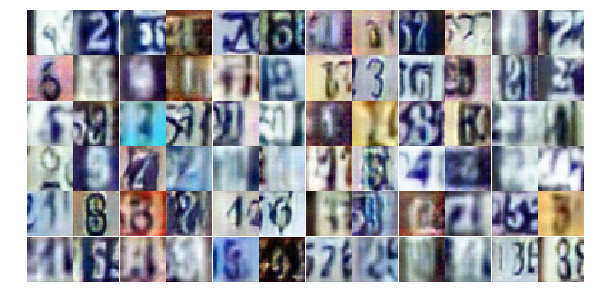

Epoch 18/25... Discriminator Loss: 1.2797... Generator Loss: 0.5841
Epoch 18/25... Discriminator Loss: 0.9511... Generator Loss: 0.7423
Epoch 18/25... Discriminator Loss: 1.0876... Generator Loss: 0.7120
Epoch 18/25... Discriminator Loss: 0.5009... Generator Loss: 1.3701
Epoch 18/25... Discriminator Loss: 0.8455... Generator Loss: 0.8181
Epoch 18/25... Discriminator Loss: 0.8408... Generator Loss: 0.7956
Epoch 18/25... Discriminator Loss: 0.9236... Generator Loss: 0.8904
Epoch 18/25... Discriminator Loss: 0.8516... Generator Loss: 0.8120
Epoch 18/25... Discriminator Loss: 0.8684... Generator Loss: 0.8229
Epoch 18/25... Discriminator Loss: 0.6701... Generator Loss: 1.0219


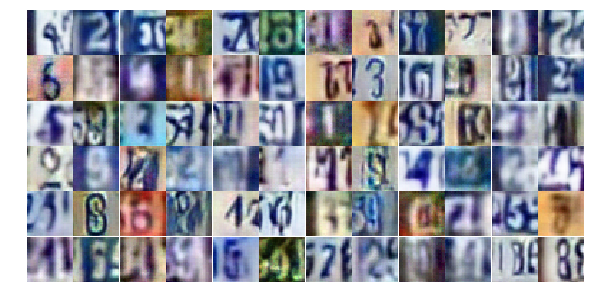

Epoch 18/25... Discriminator Loss: 0.5400... Generator Loss: 1.2274
Epoch 18/25... Discriminator Loss: 0.8335... Generator Loss: 0.9038
Epoch 18/25... Discriminator Loss: 0.6811... Generator Loss: 0.9705
Epoch 18/25... Discriminator Loss: 0.8500... Generator Loss: 0.8150
Epoch 18/25... Discriminator Loss: 0.9950... Generator Loss: 0.6796
Epoch 18/25... Discriminator Loss: 0.6585... Generator Loss: 1.0925
Epoch 18/25... Discriminator Loss: 0.7692... Generator Loss: 1.1215
Epoch 18/25... Discriminator Loss: 0.5537... Generator Loss: 1.5143
Epoch 18/25... Discriminator Loss: 0.4040... Generator Loss: 1.5280
Epoch 18/25... Discriminator Loss: 0.7001... Generator Loss: 1.0132


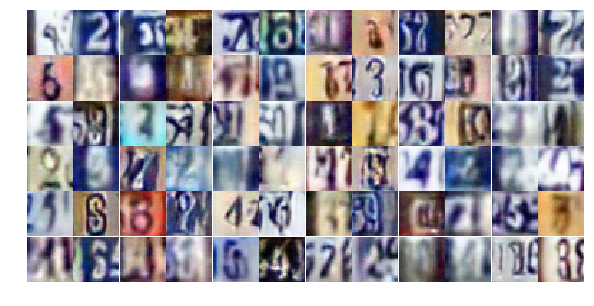

Epoch 18/25... Discriminator Loss: 0.5771... Generator Loss: 1.2838
Epoch 18/25... Discriminator Loss: 0.7626... Generator Loss: 0.8770
Epoch 18/25... Discriminator Loss: 0.6746... Generator Loss: 0.9838
Epoch 18/25... Discriminator Loss: 0.7409... Generator Loss: 0.8632
Epoch 18/25... Discriminator Loss: 0.5532... Generator Loss: 1.4837
Epoch 18/25... Discriminator Loss: 0.4981... Generator Loss: 1.2218
Epoch 18/25... Discriminator Loss: 0.7219... Generator Loss: 0.8625
Epoch 18/25... Discriminator Loss: 1.4624... Generator Loss: 3.7461
Epoch 18/25... Discriminator Loss: 1.1349... Generator Loss: 0.6606
Epoch 18/25... Discriminator Loss: 0.4219... Generator Loss: 1.4689


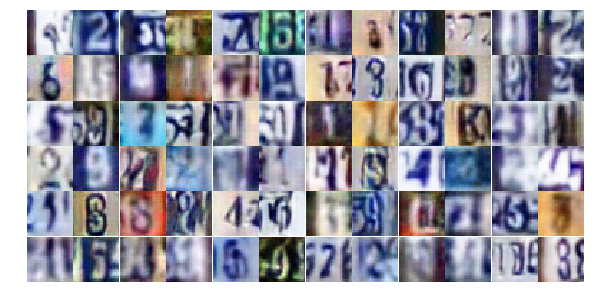

Epoch 18/25... Discriminator Loss: 0.4926... Generator Loss: 1.6090
Epoch 18/25... Discriminator Loss: 0.8988... Generator Loss: 0.7385
Epoch 18/25... Discriminator Loss: 0.7192... Generator Loss: 1.0241
Epoch 18/25... Discriminator Loss: 1.3767... Generator Loss: 0.4607
Epoch 18/25... Discriminator Loss: 0.9135... Generator Loss: 0.6817
Epoch 18/25... Discriminator Loss: 1.5239... Generator Loss: 3.8888
Epoch 18/25... Discriminator Loss: 0.6332... Generator Loss: 1.0789
Epoch 18/25... Discriminator Loss: 0.4799... Generator Loss: 1.4830
Epoch 18/25... Discriminator Loss: 0.8203... Generator Loss: 0.9367
Epoch 18/25... Discriminator Loss: 0.5287... Generator Loss: 1.6101


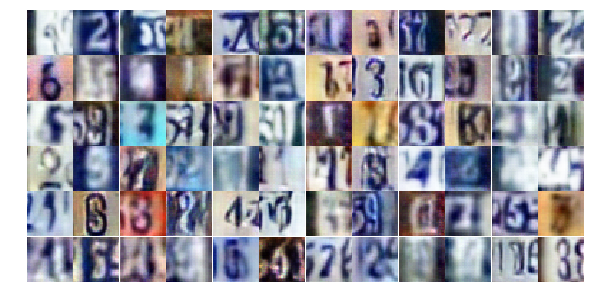

Epoch 18/25... Discriminator Loss: 0.7002... Generator Loss: 2.0097
Epoch 19/25... Discriminator Loss: 0.8912... Generator Loss: 0.8371
Epoch 19/25... Discriminator Loss: 1.2362... Generator Loss: 0.4751
Epoch 19/25... Discriminator Loss: 0.7230... Generator Loss: 0.9860
Epoch 19/25... Discriminator Loss: 0.6779... Generator Loss: 0.9763
Epoch 19/25... Discriminator Loss: 0.9261... Generator Loss: 0.7172
Epoch 19/25... Discriminator Loss: 0.6255... Generator Loss: 1.3016
Epoch 19/25... Discriminator Loss: 1.0236... Generator Loss: 0.7528
Epoch 19/25... Discriminator Loss: 0.9880... Generator Loss: 2.7539
Epoch 19/25... Discriminator Loss: 0.9632... Generator Loss: 0.8013


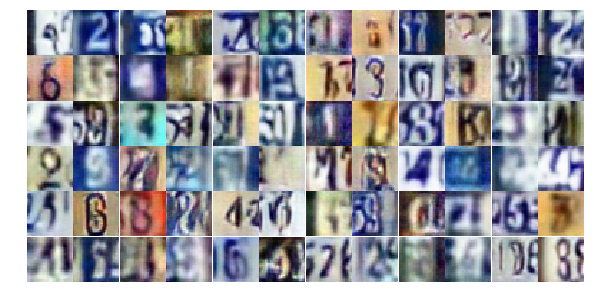

Epoch 19/25... Discriminator Loss: 0.7531... Generator Loss: 0.9549
Epoch 19/25... Discriminator Loss: 0.8437... Generator Loss: 0.8247
Epoch 19/25... Discriminator Loss: 0.8858... Generator Loss: 0.7818
Epoch 19/25... Discriminator Loss: 0.8570... Generator Loss: 0.8005
Epoch 19/25... Discriminator Loss: 0.7765... Generator Loss: 0.8675
Epoch 19/25... Discriminator Loss: 0.8873... Generator Loss: 0.7615
Epoch 19/25... Discriminator Loss: 0.5406... Generator Loss: 1.2668
Epoch 19/25... Discriminator Loss: 0.8063... Generator Loss: 0.8396
Epoch 19/25... Discriminator Loss: 1.0490... Generator Loss: 3.1588
Epoch 19/25... Discriminator Loss: 1.9337... Generator Loss: 0.2295


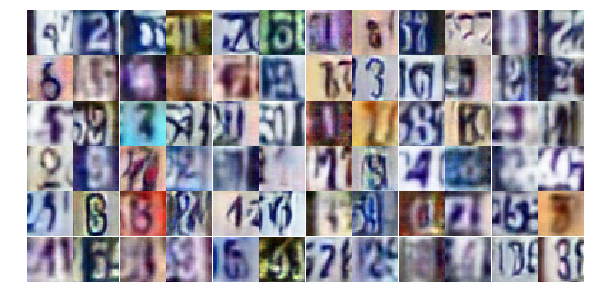

Epoch 19/25... Discriminator Loss: 0.6235... Generator Loss: 1.0858
Epoch 19/25... Discriminator Loss: 1.2281... Generator Loss: 0.5433
Epoch 19/25... Discriminator Loss: 1.3396... Generator Loss: 0.4365
Epoch 19/25... Discriminator Loss: 0.6692... Generator Loss: 1.1249
Epoch 19/25... Discriminator Loss: 0.7909... Generator Loss: 0.9461
Epoch 19/25... Discriminator Loss: 0.7027... Generator Loss: 1.1890
Epoch 19/25... Discriminator Loss: 0.9981... Generator Loss: 0.6988
Epoch 19/25... Discriminator Loss: 0.4860... Generator Loss: 1.4313
Epoch 19/25... Discriminator Loss: 0.6347... Generator Loss: 1.0029
Epoch 19/25... Discriminator Loss: 1.2187... Generator Loss: 0.5453


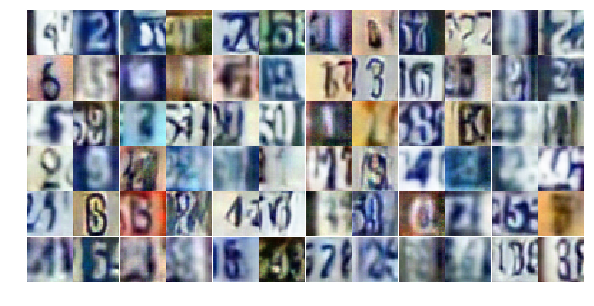

Epoch 19/25... Discriminator Loss: 0.7177... Generator Loss: 1.0168
Epoch 19/25... Discriminator Loss: 0.5005... Generator Loss: 1.2932
Epoch 19/25... Discriminator Loss: 0.8326... Generator Loss: 0.8124
Epoch 19/25... Discriminator Loss: 0.5603... Generator Loss: 1.2935
Epoch 19/25... Discriminator Loss: 1.2116... Generator Loss: 0.5370
Epoch 19/25... Discriminator Loss: 0.8563... Generator Loss: 0.7874
Epoch 19/25... Discriminator Loss: 0.7063... Generator Loss: 1.5093
Epoch 19/25... Discriminator Loss: 0.4461... Generator Loss: 1.4224
Epoch 19/25... Discriminator Loss: 0.8186... Generator Loss: 0.8821
Epoch 19/25... Discriminator Loss: 0.6717... Generator Loss: 0.9587


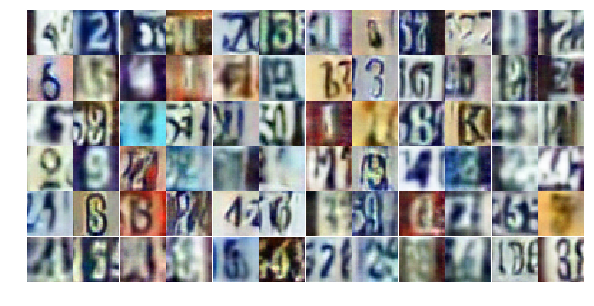

Epoch 19/25... Discriminator Loss: 0.7553... Generator Loss: 0.9530
Epoch 19/25... Discriminator Loss: 1.1084... Generator Loss: 0.5848
Epoch 19/25... Discriminator Loss: 0.9134... Generator Loss: 0.7560
Epoch 19/25... Discriminator Loss: 0.7683... Generator Loss: 0.8515
Epoch 19/25... Discriminator Loss: 0.7560... Generator Loss: 0.9704
Epoch 19/25... Discriminator Loss: 1.9820... Generator Loss: 0.2384
Epoch 19/25... Discriminator Loss: 0.6282... Generator Loss: 1.3773
Epoch 19/25... Discriminator Loss: 0.4207... Generator Loss: 1.6979
Epoch 19/25... Discriminator Loss: 0.4807... Generator Loss: 1.4980
Epoch 19/25... Discriminator Loss: 0.8563... Generator Loss: 0.9018


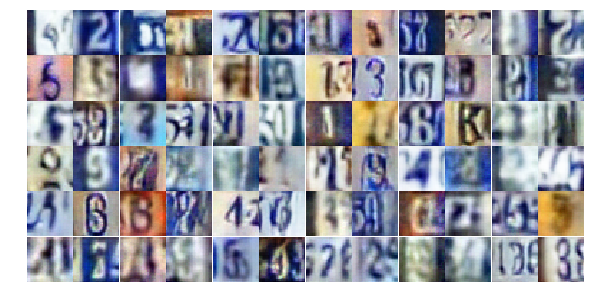

Epoch 19/25... Discriminator Loss: 0.6505... Generator Loss: 1.0116
Epoch 19/25... Discriminator Loss: 0.8320... Generator Loss: 1.7832
Epoch 19/25... Discriminator Loss: 0.5253... Generator Loss: 2.1324
Epoch 19/25... Discriminator Loss: 0.7902... Generator Loss: 0.9695
Epoch 19/25... Discriminator Loss: 0.7267... Generator Loss: 1.1696
Epoch 19/25... Discriminator Loss: 0.8506... Generator Loss: 1.1047
Epoch 19/25... Discriminator Loss: 1.8837... Generator Loss: 0.3326
Epoch 19/25... Discriminator Loss: 0.4033... Generator Loss: 1.5057
Epoch 20/25... Discriminator Loss: 0.5629... Generator Loss: 1.3280
Epoch 20/25... Discriminator Loss: 0.8149... Generator Loss: 0.8494


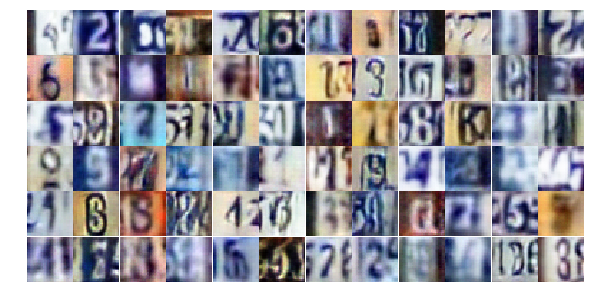

Epoch 20/25... Discriminator Loss: 0.6441... Generator Loss: 1.0263
Epoch 20/25... Discriminator Loss: 0.7468... Generator Loss: 0.9987
Epoch 20/25... Discriminator Loss: 1.5356... Generator Loss: 0.4196
Epoch 20/25... Discriminator Loss: 1.2624... Generator Loss: 0.5077
Epoch 20/25... Discriminator Loss: 0.3759... Generator Loss: 1.5349
Epoch 20/25... Discriminator Loss: 1.2401... Generator Loss: 0.4791
Epoch 20/25... Discriminator Loss: 0.7019... Generator Loss: 2.2581
Epoch 20/25... Discriminator Loss: 0.6580... Generator Loss: 1.0683
Epoch 20/25... Discriminator Loss: 0.9490... Generator Loss: 0.8447
Epoch 20/25... Discriminator Loss: 0.9889... Generator Loss: 0.6383


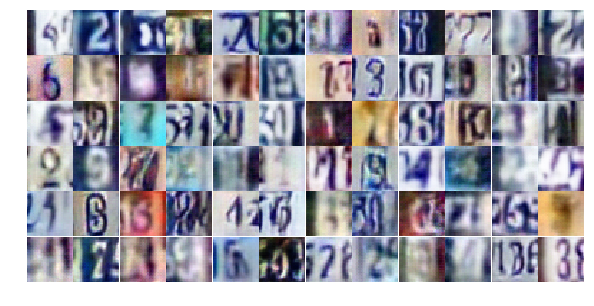

Epoch 20/25... Discriminator Loss: 1.7276... Generator Loss: 0.3203
Epoch 20/25... Discriminator Loss: 1.1380... Generator Loss: 0.6211
Epoch 20/25... Discriminator Loss: 0.6286... Generator Loss: 1.1699
Epoch 20/25... Discriminator Loss: 0.5730... Generator Loss: 1.3292
Epoch 20/25... Discriminator Loss: 1.2256... Generator Loss: 0.5167
Epoch 20/25... Discriminator Loss: 0.9402... Generator Loss: 2.3972
Epoch 20/25... Discriminator Loss: 1.3484... Generator Loss: 0.4975
Epoch 20/25... Discriminator Loss: 0.6387... Generator Loss: 1.0777
Epoch 20/25... Discriminator Loss: 0.6836... Generator Loss: 1.1758
Epoch 20/25... Discriminator Loss: 1.5273... Generator Loss: 0.3622


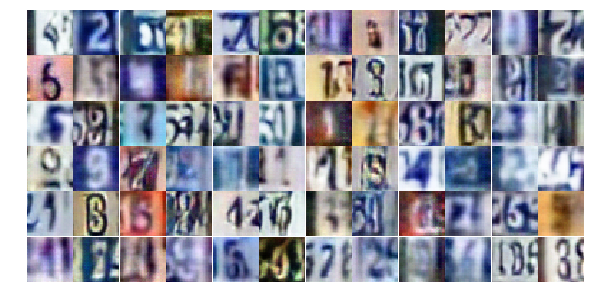

Epoch 20/25... Discriminator Loss: 0.5408... Generator Loss: 1.2623
Epoch 20/25... Discriminator Loss: 0.8180... Generator Loss: 0.9371
Epoch 20/25... Discriminator Loss: 0.3002... Generator Loss: 1.9488
Epoch 20/25... Discriminator Loss: 1.3571... Generator Loss: 0.4716
Epoch 20/25... Discriminator Loss: 0.6428... Generator Loss: 1.1780
Epoch 20/25... Discriminator Loss: 0.4315... Generator Loss: 1.5093
Epoch 20/25... Discriminator Loss: 0.7334... Generator Loss: 0.9155
Epoch 20/25... Discriminator Loss: 1.7607... Generator Loss: 0.3428
Epoch 20/25... Discriminator Loss: 1.0993... Generator Loss: 0.5997
Epoch 20/25... Discriminator Loss: 0.3584... Generator Loss: 1.6960


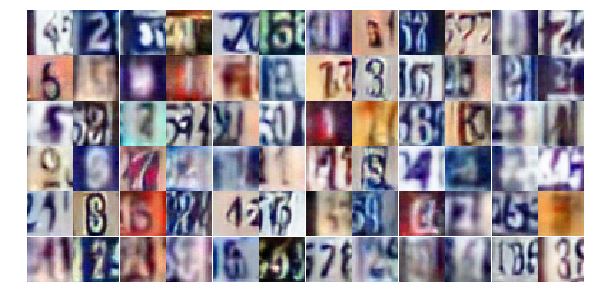

Epoch 20/25... Discriminator Loss: 0.7105... Generator Loss: 0.9826
Epoch 20/25... Discriminator Loss: 0.6162... Generator Loss: 1.1048
Epoch 20/25... Discriminator Loss: 1.5109... Generator Loss: 0.4121
Epoch 20/25... Discriminator Loss: 1.7586... Generator Loss: 1.5731
Epoch 20/25... Discriminator Loss: 1.5757... Generator Loss: 0.3910
Epoch 20/25... Discriminator Loss: 0.6442... Generator Loss: 1.2315
Epoch 20/25... Discriminator Loss: 0.7020... Generator Loss: 1.1721
Epoch 20/25... Discriminator Loss: 0.8425... Generator Loss: 0.8458
Epoch 20/25... Discriminator Loss: 0.8645... Generator Loss: 0.9669
Epoch 20/25... Discriminator Loss: 0.6505... Generator Loss: 1.0022


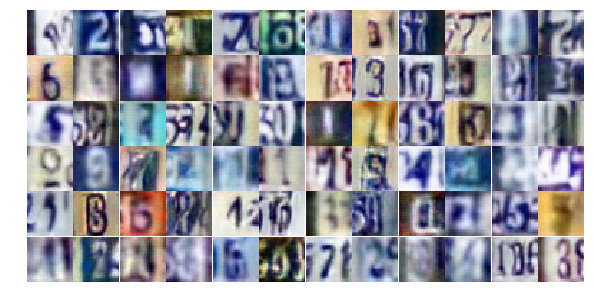

Epoch 20/25... Discriminator Loss: 0.8378... Generator Loss: 0.8731
Epoch 20/25... Discriminator Loss: 0.9833... Generator Loss: 0.6643
Epoch 20/25... Discriminator Loss: 0.7806... Generator Loss: 1.1431
Epoch 20/25... Discriminator Loss: 0.7774... Generator Loss: 1.0578
Epoch 20/25... Discriminator Loss: 0.8185... Generator Loss: 0.8670
Epoch 20/25... Discriminator Loss: 0.7537... Generator Loss: 1.0402
Epoch 20/25... Discriminator Loss: 1.0029... Generator Loss: 0.6797
Epoch 20/25... Discriminator Loss: 0.4899... Generator Loss: 1.5595
Epoch 20/25... Discriminator Loss: 0.9225... Generator Loss: 2.1373
Epoch 20/25... Discriminator Loss: 0.7476... Generator Loss: 0.9077


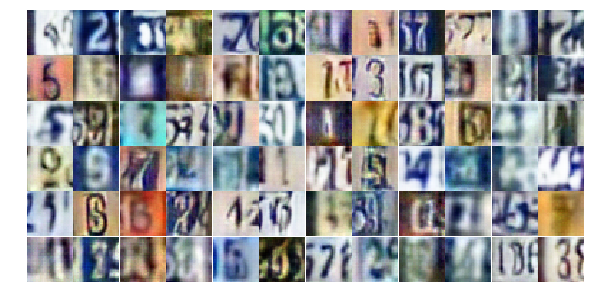

Epoch 20/25... Discriminator Loss: 0.5440... Generator Loss: 1.2776
Epoch 20/25... Discriminator Loss: 0.7233... Generator Loss: 1.0189
Epoch 20/25... Discriminator Loss: 0.4102... Generator Loss: 1.6913
Epoch 20/25... Discriminator Loss: 0.8838... Generator Loss: 0.9988
Epoch 20/25... Discriminator Loss: 0.5633... Generator Loss: 1.3248
Epoch 20/25... Discriminator Loss: 0.4039... Generator Loss: 1.7030
Epoch 21/25... Discriminator Loss: 1.1310... Generator Loss: 0.6152
Epoch 21/25... Discriminator Loss: 0.8563... Generator Loss: 0.7381
Epoch 21/25... Discriminator Loss: 1.1105... Generator Loss: 0.6322
Epoch 21/25... Discriminator Loss: 1.5393... Generator Loss: 0.4194


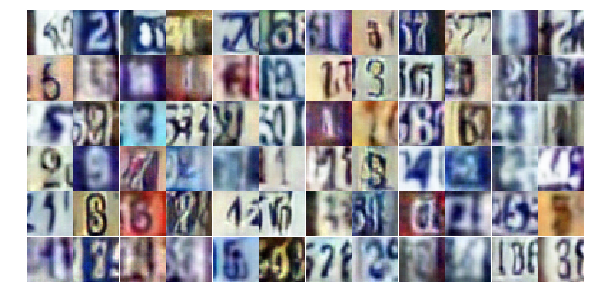

Epoch 21/25... Discriminator Loss: 1.0847... Generator Loss: 0.5931
Epoch 21/25... Discriminator Loss: 1.7503... Generator Loss: 0.2922
Epoch 21/25... Discriminator Loss: 0.3428... Generator Loss: 1.7553
Epoch 21/25... Discriminator Loss: 0.3989... Generator Loss: 1.5202
Epoch 21/25... Discriminator Loss: 1.1071... Generator Loss: 0.5969
Epoch 21/25... Discriminator Loss: 0.6531... Generator Loss: 1.0202
Epoch 21/25... Discriminator Loss: 0.6548... Generator Loss: 1.0771
Epoch 21/25... Discriminator Loss: 0.9071... Generator Loss: 0.7826
Epoch 21/25... Discriminator Loss: 0.6613... Generator Loss: 0.9957
Epoch 21/25... Discriminator Loss: 1.0407... Generator Loss: 0.6266


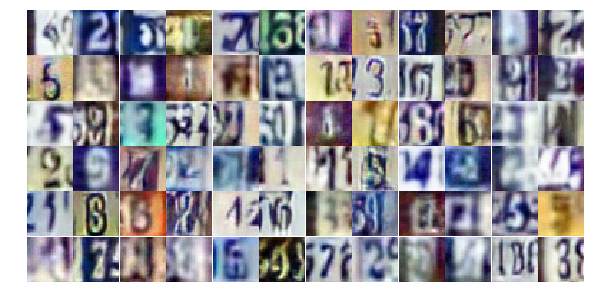

Epoch 21/25... Discriminator Loss: 0.4122... Generator Loss: 1.4430
Epoch 21/25... Discriminator Loss: 1.2070... Generator Loss: 0.5085
Epoch 21/25... Discriminator Loss: 1.9552... Generator Loss: 0.2514
Epoch 21/25... Discriminator Loss: 1.2732... Generator Loss: 0.6255
Epoch 21/25... Discriminator Loss: 0.5947... Generator Loss: 1.4158
Epoch 21/25... Discriminator Loss: 1.5742... Generator Loss: 0.3706
Epoch 21/25... Discriminator Loss: 0.7780... Generator Loss: 0.8917
Epoch 21/25... Discriminator Loss: 0.4454... Generator Loss: 1.5107
Epoch 21/25... Discriminator Loss: 0.4649... Generator Loss: 1.4603
Epoch 21/25... Discriminator Loss: 0.5830... Generator Loss: 1.2435


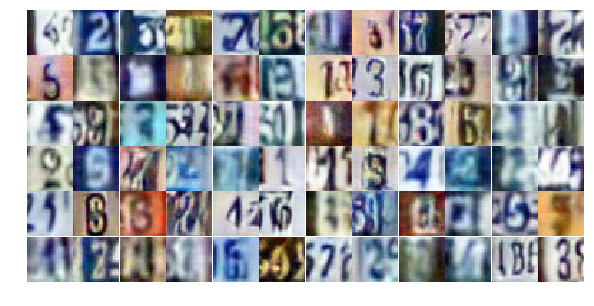

Epoch 21/25... Discriminator Loss: 1.1251... Generator Loss: 0.6503
Epoch 21/25... Discriminator Loss: 0.4115... Generator Loss: 1.5441
Epoch 21/25... Discriminator Loss: 1.4900... Generator Loss: 0.4159
Epoch 21/25... Discriminator Loss: 0.8634... Generator Loss: 0.8044
Epoch 21/25... Discriminator Loss: 0.9870... Generator Loss: 0.6911
Epoch 21/25... Discriminator Loss: 0.8660... Generator Loss: 0.8703
Epoch 21/25... Discriminator Loss: 0.4002... Generator Loss: 1.9977
Epoch 21/25... Discriminator Loss: 0.8148... Generator Loss: 0.9691
Epoch 21/25... Discriminator Loss: 0.9155... Generator Loss: 0.7639
Epoch 21/25... Discriminator Loss: 1.3615... Generator Loss: 0.4738


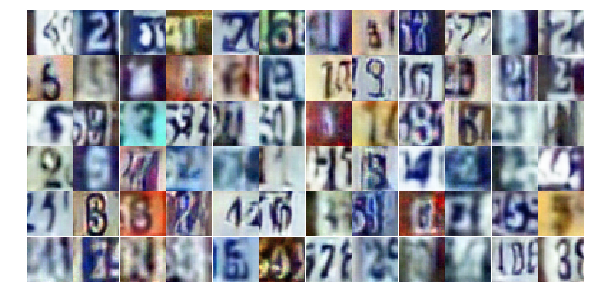

Epoch 21/25... Discriminator Loss: 1.1648... Generator Loss: 0.5431
Epoch 21/25... Discriminator Loss: 0.6946... Generator Loss: 0.9466
Epoch 21/25... Discriminator Loss: 1.0710... Generator Loss: 0.6317
Epoch 21/25... Discriminator Loss: 0.4934... Generator Loss: 1.2776
Epoch 21/25... Discriminator Loss: 0.4489... Generator Loss: 1.6460
Epoch 21/25... Discriminator Loss: 0.6685... Generator Loss: 1.2719
Epoch 21/25... Discriminator Loss: 0.7442... Generator Loss: 1.2069
Epoch 21/25... Discriminator Loss: 1.4916... Generator Loss: 0.4203
Epoch 21/25... Discriminator Loss: 0.6977... Generator Loss: 0.9973
Epoch 21/25... Discriminator Loss: 0.4837... Generator Loss: 1.7041


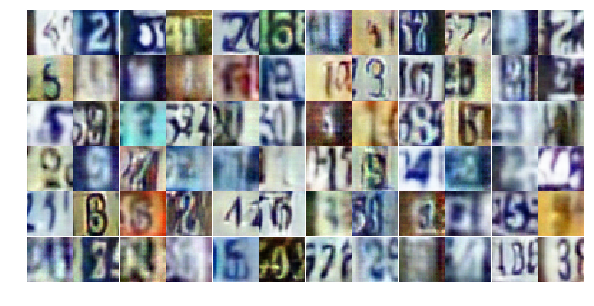

Epoch 21/25... Discriminator Loss: 3.7019... Generator Loss: 0.0788
Epoch 21/25... Discriminator Loss: 1.9149... Generator Loss: 0.3049
Epoch 21/25... Discriminator Loss: 0.6149... Generator Loss: 1.3841
Epoch 21/25... Discriminator Loss: 0.8709... Generator Loss: 0.8262
Epoch 21/25... Discriminator Loss: 0.4459... Generator Loss: 1.4691
Epoch 21/25... Discriminator Loss: 0.7067... Generator Loss: 1.0993
Epoch 21/25... Discriminator Loss: 0.9370... Generator Loss: 0.7924
Epoch 21/25... Discriminator Loss: 0.7673... Generator Loss: 0.9317
Epoch 21/25... Discriminator Loss: 1.0530... Generator Loss: 0.6115
Epoch 21/25... Discriminator Loss: 1.0977... Generator Loss: 0.5628


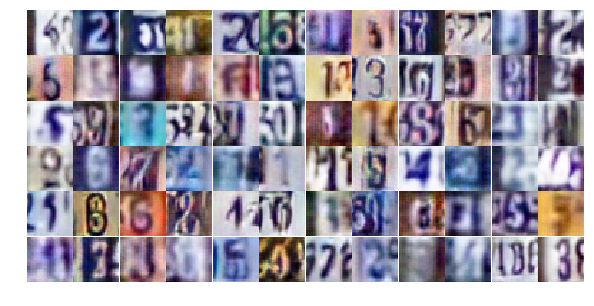

Epoch 21/25... Discriminator Loss: 0.5039... Generator Loss: 1.5040
Epoch 21/25... Discriminator Loss: 0.7333... Generator Loss: 1.3584
Epoch 21/25... Discriminator Loss: 1.0187... Generator Loss: 0.7908
Epoch 22/25... Discriminator Loss: 0.7466... Generator Loss: 0.9983
Epoch 22/25... Discriminator Loss: 0.9221... Generator Loss: 0.7323
Epoch 22/25... Discriminator Loss: 1.0944... Generator Loss: 0.6488
Epoch 22/25... Discriminator Loss: 0.5179... Generator Loss: 1.2986
Epoch 22/25... Discriminator Loss: 0.5973... Generator Loss: 1.1963
Epoch 22/25... Discriminator Loss: 1.0051... Generator Loss: 0.6834
Epoch 22/25... Discriminator Loss: 0.7747... Generator Loss: 1.2280


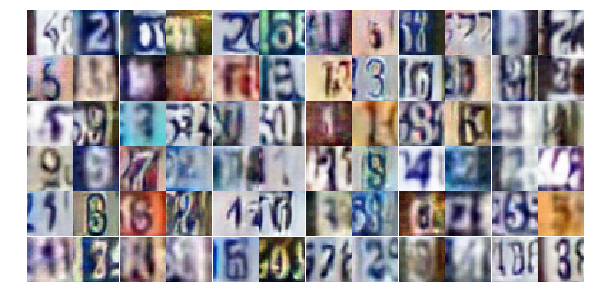

Epoch 22/25... Discriminator Loss: 0.5401... Generator Loss: 1.5553
Epoch 22/25... Discriminator Loss: 0.7192... Generator Loss: 1.0017
Epoch 22/25... Discriminator Loss: 1.2448... Generator Loss: 0.4626
Epoch 22/25... Discriminator Loss: 0.5050... Generator Loss: 1.3547
Epoch 22/25... Discriminator Loss: 0.9755... Generator Loss: 0.7929
Epoch 22/25... Discriminator Loss: 0.6475... Generator Loss: 0.9754
Epoch 22/25... Discriminator Loss: 0.7168... Generator Loss: 1.0052
Epoch 22/25... Discriminator Loss: 0.3796... Generator Loss: 1.7189
Epoch 22/25... Discriminator Loss: 0.8398... Generator Loss: 0.9519
Epoch 22/25... Discriminator Loss: 1.8178... Generator Loss: 0.2668


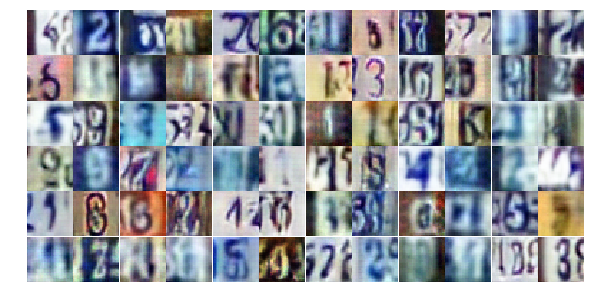

Epoch 22/25... Discriminator Loss: 1.1006... Generator Loss: 0.6842
Epoch 22/25... Discriminator Loss: 0.5427... Generator Loss: 1.3244
Epoch 22/25... Discriminator Loss: 0.7312... Generator Loss: 0.9355
Epoch 22/25... Discriminator Loss: 0.4409... Generator Loss: 1.8008
Epoch 22/25... Discriminator Loss: 0.6454... Generator Loss: 1.0301
Epoch 22/25... Discriminator Loss: 0.9567... Generator Loss: 0.6737
Epoch 22/25... Discriminator Loss: 0.3937... Generator Loss: 2.1966
Epoch 22/25... Discriminator Loss: 0.3313... Generator Loss: 1.9824
Epoch 22/25... Discriminator Loss: 0.5912... Generator Loss: 1.4710
Epoch 22/25... Discriminator Loss: 1.1736... Generator Loss: 0.5021


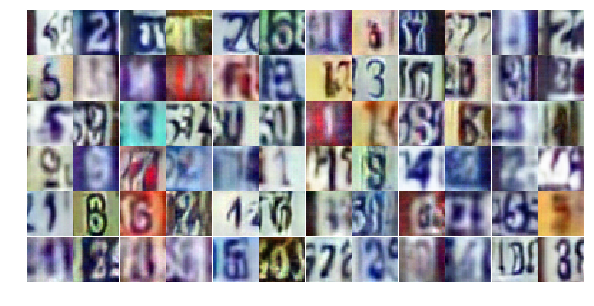

Epoch 22/25... Discriminator Loss: 0.5390... Generator Loss: 1.2890
Epoch 22/25... Discriminator Loss: 0.7408... Generator Loss: 0.9725
Epoch 22/25... Discriminator Loss: 0.7988... Generator Loss: 0.9217
Epoch 22/25... Discriminator Loss: 0.8969... Generator Loss: 0.7784
Epoch 22/25... Discriminator Loss: 0.6003... Generator Loss: 1.4263
Epoch 22/25... Discriminator Loss: 1.2328... Generator Loss: 0.5050
Epoch 22/25... Discriminator Loss: 1.7423... Generator Loss: 0.3327
Epoch 22/25... Discriminator Loss: 0.4901... Generator Loss: 1.6626
Epoch 22/25... Discriminator Loss: 0.9649... Generator Loss: 0.7366
Epoch 22/25... Discriminator Loss: 0.7949... Generator Loss: 0.9240


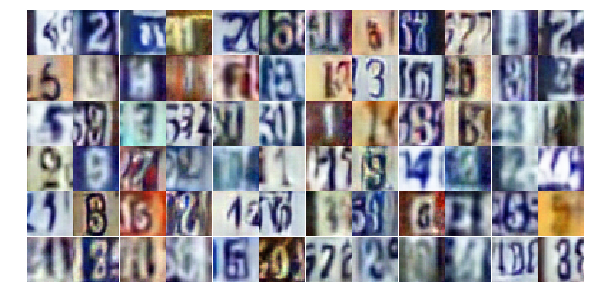

Epoch 22/25... Discriminator Loss: 1.2113... Generator Loss: 0.5211
Epoch 22/25... Discriminator Loss: 0.4437... Generator Loss: 1.5561
Epoch 22/25... Discriminator Loss: 0.3639... Generator Loss: 1.7574
Epoch 22/25... Discriminator Loss: 0.7271... Generator Loss: 0.9079
Epoch 22/25... Discriminator Loss: 0.3848... Generator Loss: 1.5334
Epoch 22/25... Discriminator Loss: 0.4269... Generator Loss: 1.4903
Epoch 22/25... Discriminator Loss: 0.5788... Generator Loss: 1.2560
Epoch 22/25... Discriminator Loss: 1.5466... Generator Loss: 0.3732
Epoch 22/25... Discriminator Loss: 1.4085... Generator Loss: 0.7301
Epoch 22/25... Discriminator Loss: 0.6192... Generator Loss: 1.3857


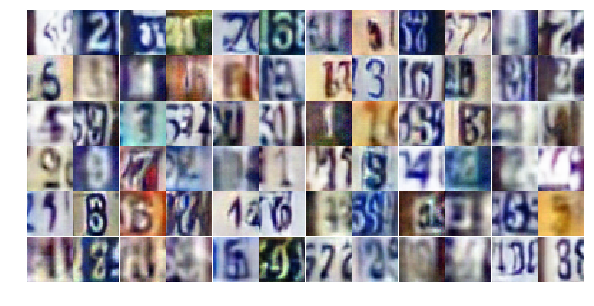

Epoch 22/25... Discriminator Loss: 1.0875... Generator Loss: 0.5819
Epoch 22/25... Discriminator Loss: 0.6359... Generator Loss: 1.0391
Epoch 22/25... Discriminator Loss: 0.7161... Generator Loss: 0.9504
Epoch 22/25... Discriminator Loss: 0.5962... Generator Loss: 1.3265
Epoch 22/25... Discriminator Loss: 0.7600... Generator Loss: 0.8883
Epoch 22/25... Discriminator Loss: 0.6384... Generator Loss: 1.5821
Epoch 22/25... Discriminator Loss: 0.7166... Generator Loss: 0.9702
Epoch 22/25... Discriminator Loss: 0.8659... Generator Loss: 0.7481
Epoch 22/25... Discriminator Loss: 2.5627... Generator Loss: 0.4621
Epoch 22/25... Discriminator Loss: 1.4684... Generator Loss: 0.4613


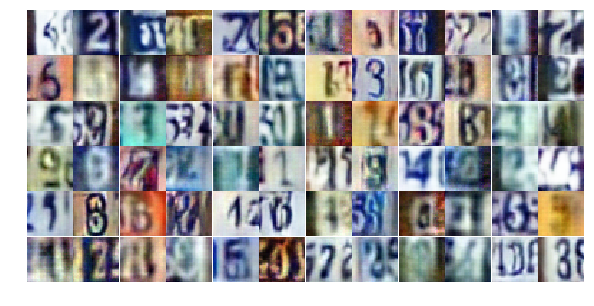

Epoch 23/25... Discriminator Loss: 0.6517... Generator Loss: 1.0935
Epoch 23/25... Discriminator Loss: 0.5549... Generator Loss: 1.2023
Epoch 23/25... Discriminator Loss: 1.3080... Generator Loss: 0.5073
Epoch 23/25... Discriminator Loss: 0.6915... Generator Loss: 0.9753
Epoch 23/25... Discriminator Loss: 0.7278... Generator Loss: 0.8677
Epoch 23/25... Discriminator Loss: 1.3422... Generator Loss: 0.4588
Epoch 23/25... Discriminator Loss: 0.9849... Generator Loss: 0.7283
Epoch 23/25... Discriminator Loss: 0.7957... Generator Loss: 0.8474
Epoch 23/25... Discriminator Loss: 0.5674... Generator Loss: 1.3227
Epoch 23/25... Discriminator Loss: 0.5250... Generator Loss: 1.2928


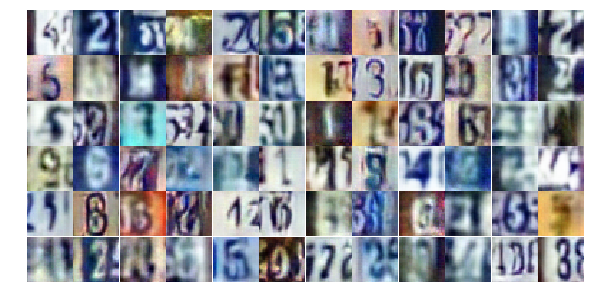

Epoch 23/25... Discriminator Loss: 0.8395... Generator Loss: 0.8097
Epoch 23/25... Discriminator Loss: 0.5073... Generator Loss: 1.3198
Epoch 23/25... Discriminator Loss: 1.2951... Generator Loss: 0.4603
Epoch 23/25... Discriminator Loss: 0.6399... Generator Loss: 1.1086
Epoch 23/25... Discriminator Loss: 0.5396... Generator Loss: 1.2457
Epoch 23/25... Discriminator Loss: 1.2243... Generator Loss: 0.5664
Epoch 23/25... Discriminator Loss: 0.9792... Generator Loss: 0.6925
Epoch 23/25... Discriminator Loss: 0.7606... Generator Loss: 0.9289
Epoch 23/25... Discriminator Loss: 0.6494... Generator Loss: 1.1020
Epoch 23/25... Discriminator Loss: 0.8751... Generator Loss: 0.7748


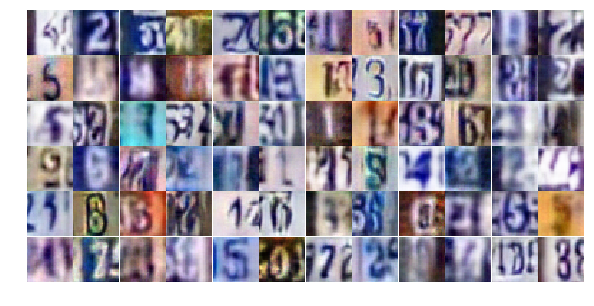

Epoch 23/25... Discriminator Loss: 1.0856... Generator Loss: 0.6145
Epoch 23/25... Discriminator Loss: 0.7171... Generator Loss: 0.9409
Epoch 23/25... Discriminator Loss: 0.7670... Generator Loss: 0.9666
Epoch 23/25... Discriminator Loss: 0.6704... Generator Loss: 0.9814
Epoch 23/25... Discriminator Loss: 0.3856... Generator Loss: 1.9904
Epoch 23/25... Discriminator Loss: 0.8219... Generator Loss: 2.1936
Epoch 23/25... Discriminator Loss: 0.5060... Generator Loss: 1.6461
Epoch 23/25... Discriminator Loss: 0.9891... Generator Loss: 0.7816
Epoch 23/25... Discriminator Loss: 0.7401... Generator Loss: 0.9635
Epoch 23/25... Discriminator Loss: 0.9437... Generator Loss: 1.0806


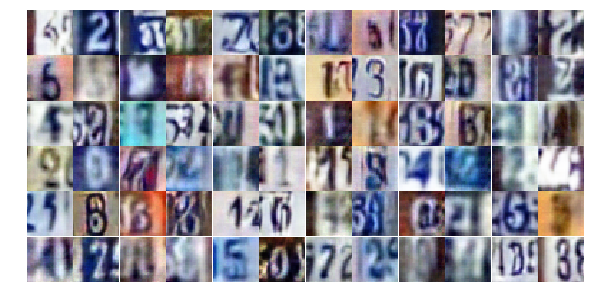

Epoch 23/25... Discriminator Loss: 0.5688... Generator Loss: 1.1790
Epoch 23/25... Discriminator Loss: 0.4626... Generator Loss: 1.5721
Epoch 23/25... Discriminator Loss: 0.6364... Generator Loss: 1.1164
Epoch 23/25... Discriminator Loss: 1.0039... Generator Loss: 0.6519
Epoch 23/25... Discriminator Loss: 0.8846... Generator Loss: 2.5260
Epoch 23/25... Discriminator Loss: 1.5799... Generator Loss: 0.3721
Epoch 23/25... Discriminator Loss: 1.3963... Generator Loss: 0.4154
Epoch 23/25... Discriminator Loss: 0.6863... Generator Loss: 1.0380
Epoch 23/25... Discriminator Loss: 0.4066... Generator Loss: 1.5591
Epoch 23/25... Discriminator Loss: 0.2575... Generator Loss: 2.4272


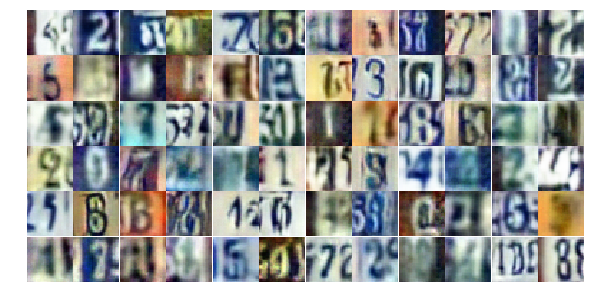

Epoch 23/25... Discriminator Loss: 1.3654... Generator Loss: 0.7106
Epoch 23/25... Discriminator Loss: 0.6703... Generator Loss: 1.2016
Epoch 23/25... Discriminator Loss: 1.2773... Generator Loss: 0.5220
Epoch 23/25... Discriminator Loss: 0.8330... Generator Loss: 0.8153
Epoch 23/25... Discriminator Loss: 0.9628... Generator Loss: 0.7853
Epoch 23/25... Discriminator Loss: 1.0592... Generator Loss: 0.7013
Epoch 23/25... Discriminator Loss: 0.9266... Generator Loss: 0.7680
Epoch 23/25... Discriminator Loss: 0.9898... Generator Loss: 0.7147
Epoch 23/25... Discriminator Loss: 0.5427... Generator Loss: 1.6972
Epoch 23/25... Discriminator Loss: 0.8978... Generator Loss: 0.8683


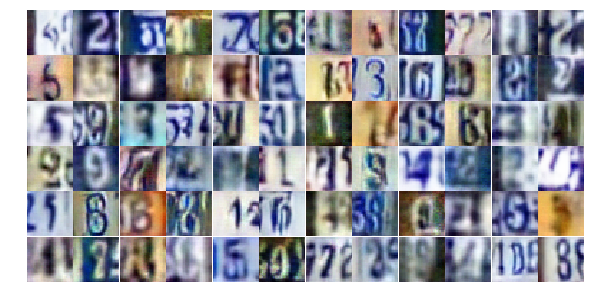

Epoch 23/25... Discriminator Loss: 0.5776... Generator Loss: 1.5955
Epoch 23/25... Discriminator Loss: 1.1345... Generator Loss: 0.5989
Epoch 23/25... Discriminator Loss: 1.6291... Generator Loss: 0.3291
Epoch 23/25... Discriminator Loss: 0.5353... Generator Loss: 1.6886
Epoch 23/25... Discriminator Loss: 1.0158... Generator Loss: 0.7060
Epoch 23/25... Discriminator Loss: 0.4611... Generator Loss: 1.5940
Epoch 23/25... Discriminator Loss: 0.6430... Generator Loss: 1.0689
Epoch 24/25... Discriminator Loss: 0.7389... Generator Loss: 1.0331
Epoch 24/25... Discriminator Loss: 0.8672... Generator Loss: 0.8726
Epoch 24/25... Discriminator Loss: 1.3428... Generator Loss: 0.4599


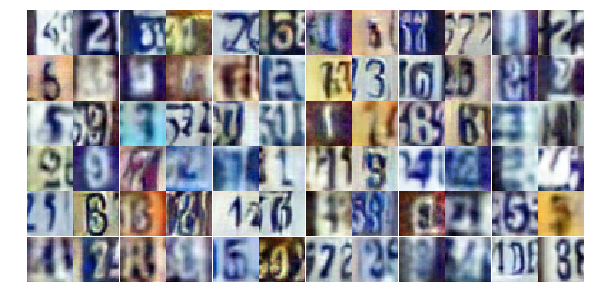

Epoch 24/25... Discriminator Loss: 0.6938... Generator Loss: 0.9540
Epoch 24/25... Discriminator Loss: 0.5809... Generator Loss: 1.1680
Epoch 24/25... Discriminator Loss: 0.5571... Generator Loss: 1.2923
Epoch 24/25... Discriminator Loss: 0.7262... Generator Loss: 1.9487
Epoch 24/25... Discriminator Loss: 0.8227... Generator Loss: 0.8000
Epoch 24/25... Discriminator Loss: 0.6024... Generator Loss: 1.2741
Epoch 24/25... Discriminator Loss: 0.6819... Generator Loss: 1.0085
Epoch 24/25... Discriminator Loss: 1.4832... Generator Loss: 0.3807
Epoch 24/25... Discriminator Loss: 0.5245... Generator Loss: 1.2359
Epoch 24/25... Discriminator Loss: 0.4233... Generator Loss: 1.6832


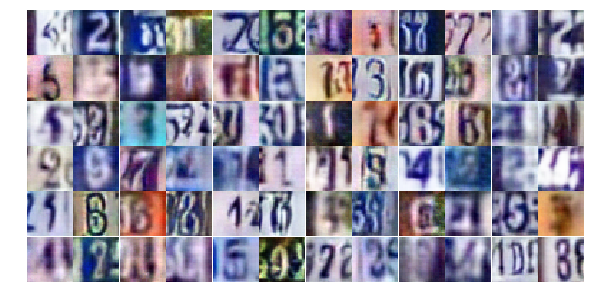

Epoch 24/25... Discriminator Loss: 1.1360... Generator Loss: 0.5895
Epoch 24/25... Discriminator Loss: 0.8246... Generator Loss: 1.0779
Epoch 24/25... Discriminator Loss: 0.7619... Generator Loss: 0.9207
Epoch 24/25... Discriminator Loss: 0.9990... Generator Loss: 0.6375
Epoch 24/25... Discriminator Loss: 0.4247... Generator Loss: 1.6162
Epoch 24/25... Discriminator Loss: 0.8796... Generator Loss: 0.8085
Epoch 24/25... Discriminator Loss: 0.4475... Generator Loss: 1.4194
Epoch 24/25... Discriminator Loss: 1.0987... Generator Loss: 0.6672
Epoch 24/25... Discriminator Loss: 0.5809... Generator Loss: 1.3384
Epoch 24/25... Discriminator Loss: 0.6491... Generator Loss: 1.2003


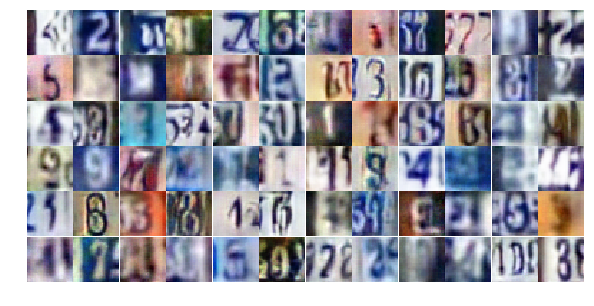

Epoch 24/25... Discriminator Loss: 0.6603... Generator Loss: 1.0180
Epoch 24/25... Discriminator Loss: 0.7674... Generator Loss: 0.9076
Epoch 24/25... Discriminator Loss: 0.5548... Generator Loss: 1.2488
Epoch 24/25... Discriminator Loss: 0.8165... Generator Loss: 0.8836
Epoch 24/25... Discriminator Loss: 0.5927... Generator Loss: 1.0943
Epoch 24/25... Discriminator Loss: 0.4429... Generator Loss: 1.2925
Epoch 24/25... Discriminator Loss: 0.6144... Generator Loss: 1.1555
Epoch 24/25... Discriminator Loss: 0.5312... Generator Loss: 1.2382
Epoch 24/25... Discriminator Loss: 0.4552... Generator Loss: 1.4305
Epoch 24/25... Discriminator Loss: 0.8126... Generator Loss: 0.8767


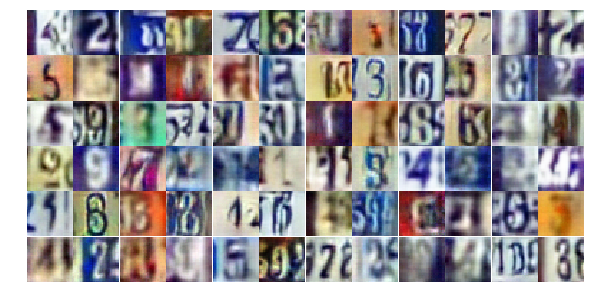

Epoch 24/25... Discriminator Loss: 0.4831... Generator Loss: 1.4383
Epoch 24/25... Discriminator Loss: 0.5368... Generator Loss: 1.2121
Epoch 24/25... Discriminator Loss: 1.5115... Generator Loss: 0.7626
Epoch 24/25... Discriminator Loss: 1.9726... Generator Loss: 0.2384
Epoch 24/25... Discriminator Loss: 1.6990... Generator Loss: 0.3148
Epoch 24/25... Discriminator Loss: 0.6674... Generator Loss: 1.0692
Epoch 24/25... Discriminator Loss: 0.7049... Generator Loss: 1.1029
Epoch 24/25... Discriminator Loss: 0.9953... Generator Loss: 0.6734
Epoch 24/25... Discriminator Loss: 0.7840... Generator Loss: 0.9232
Epoch 24/25... Discriminator Loss: 0.6318... Generator Loss: 1.3802


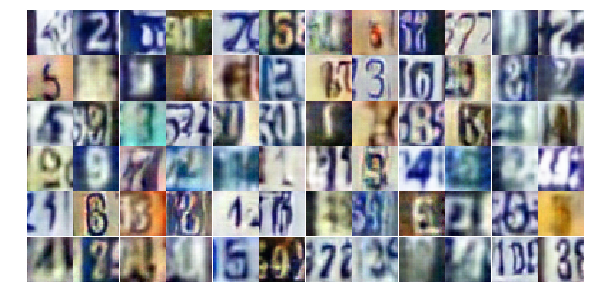

Epoch 24/25... Discriminator Loss: 0.9540... Generator Loss: 0.7231
Epoch 24/25... Discriminator Loss: 2.4137... Generator Loss: 0.1736
Epoch 24/25... Discriminator Loss: 2.6586... Generator Loss: 0.1441
Epoch 24/25... Discriminator Loss: 1.4555... Generator Loss: 0.3919
Epoch 24/25... Discriminator Loss: 1.0716... Generator Loss: 0.5731
Epoch 24/25... Discriminator Loss: 0.9277... Generator Loss: 0.7426
Epoch 24/25... Discriminator Loss: 1.1104... Generator Loss: 0.6476
Epoch 24/25... Discriminator Loss: 0.7612... Generator Loss: 0.8764
Epoch 24/25... Discriminator Loss: 0.9456... Generator Loss: 0.7250
Epoch 24/25... Discriminator Loss: 1.0105... Generator Loss: 0.8356


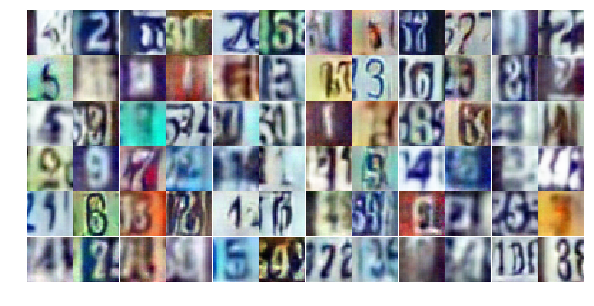

Epoch 24/25... Discriminator Loss: 1.1658... Generator Loss: 0.5496
Epoch 24/25... Discriminator Loss: 1.2562... Generator Loss: 0.5159
Epoch 24/25... Discriminator Loss: 1.0172... Generator Loss: 0.6308
Epoch 24/25... Discriminator Loss: 0.6864... Generator Loss: 1.2323
Epoch 24/25... Discriminator Loss: 1.0006... Generator Loss: 0.6934
Epoch 25/25... Discriminator Loss: 0.5200... Generator Loss: 1.3806
Epoch 25/25... Discriminator Loss: 0.5395... Generator Loss: 1.3814
Epoch 25/25... Discriminator Loss: 0.7719... Generator Loss: 0.9337
Epoch 25/25... Discriminator Loss: 0.9429... Generator Loss: 0.7606
Epoch 25/25... Discriminator Loss: 0.8042... Generator Loss: 0.8405


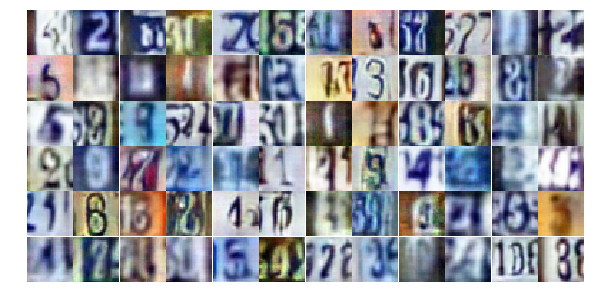

Epoch 25/25... Discriminator Loss: 1.0098... Generator Loss: 0.6441
Epoch 25/25... Discriminator Loss: 0.7823... Generator Loss: 1.2930
Epoch 25/25... Discriminator Loss: 0.6236... Generator Loss: 1.0758
Epoch 25/25... Discriminator Loss: 0.5543... Generator Loss: 1.3302
Epoch 25/25... Discriminator Loss: 0.7205... Generator Loss: 2.0106
Epoch 25/25... Discriminator Loss: 1.0794... Generator Loss: 0.7324
Epoch 25/25... Discriminator Loss: 0.6431... Generator Loss: 1.0094
Epoch 25/25... Discriminator Loss: 0.7247... Generator Loss: 0.9601
Epoch 25/25... Discriminator Loss: 0.5332... Generator Loss: 1.1867
Epoch 25/25... Discriminator Loss: 1.6806... Generator Loss: 0.3292


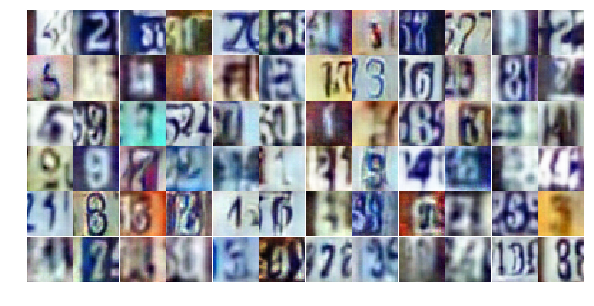

Epoch 25/25... Discriminator Loss: 1.6150... Generator Loss: 0.3461
Epoch 25/25... Discriminator Loss: 0.7478... Generator Loss: 2.8231
Epoch 25/25... Discriminator Loss: 1.6899... Generator Loss: 0.3308
Epoch 25/25... Discriminator Loss: 1.1539... Generator Loss: 0.5828
Epoch 25/25... Discriminator Loss: 0.6560... Generator Loss: 1.0365
Epoch 25/25... Discriminator Loss: 0.5710... Generator Loss: 1.2542
Epoch 25/25... Discriminator Loss: 0.8203... Generator Loss: 0.8777
Epoch 25/25... Discriminator Loss: 1.0117... Generator Loss: 0.6954
Epoch 25/25... Discriminator Loss: 0.4926... Generator Loss: 1.4182
Epoch 25/25... Discriminator Loss: 0.6623... Generator Loss: 1.0828


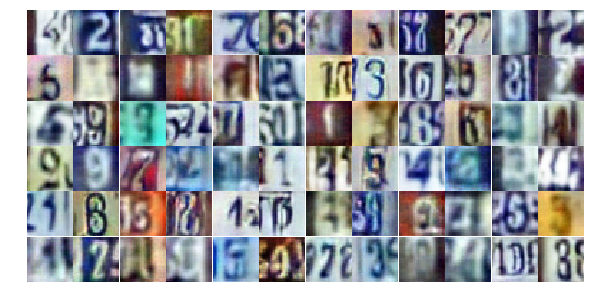

Epoch 25/25... Discriminator Loss: 0.8258... Generator Loss: 0.9255
Epoch 25/25... Discriminator Loss: 0.6840... Generator Loss: 0.9848
Epoch 25/25... Discriminator Loss: 1.5002... Generator Loss: 0.4167
Epoch 25/25... Discriminator Loss: 0.7188... Generator Loss: 0.9511
Epoch 25/25... Discriminator Loss: 0.9310... Generator Loss: 0.8410
Epoch 25/25... Discriminator Loss: 0.5034... Generator Loss: 1.2656
Epoch 25/25... Discriminator Loss: 0.5074... Generator Loss: 1.3997
Epoch 25/25... Discriminator Loss: 0.7630... Generator Loss: 0.9396
Epoch 25/25... Discriminator Loss: 0.7986... Generator Loss: 1.6622
Epoch 25/25... Discriminator Loss: 1.1121... Generator Loss: 1.4174


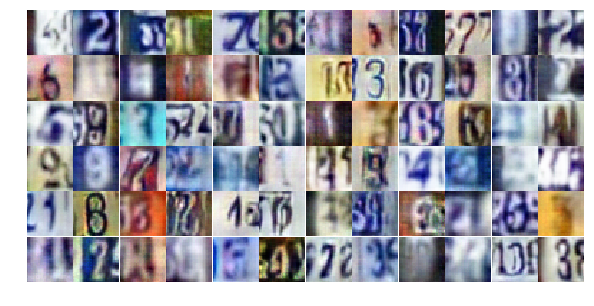

Epoch 25/25... Discriminator Loss: 0.8397... Generator Loss: 1.6857
Epoch 25/25... Discriminator Loss: 0.6915... Generator Loss: 0.9533
Epoch 25/25... Discriminator Loss: 0.5931... Generator Loss: 1.5057
Epoch 25/25... Discriminator Loss: 0.4938... Generator Loss: 1.4157
Epoch 25/25... Discriminator Loss: 1.0207... Generator Loss: 0.6336
Epoch 25/25... Discriminator Loss: 0.6012... Generator Loss: 1.1602
Epoch 25/25... Discriminator Loss: 0.4318... Generator Loss: 1.8030
Epoch 25/25... Discriminator Loss: 0.5272... Generator Loss: 1.3003
Epoch 25/25... Discriminator Loss: 1.8836... Generator Loss: 0.3972
Epoch 25/25... Discriminator Loss: 0.8758... Generator Loss: 0.8292


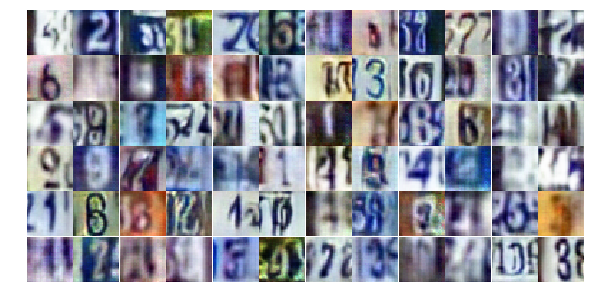

Epoch 25/25... Discriminator Loss: 0.7134... Generator Loss: 1.8031
Epoch 25/25... Discriminator Loss: 1.5749... Generator Loss: 0.4143
Epoch 25/25... Discriminator Loss: 0.9340... Generator Loss: 0.7655
Epoch 25/25... Discriminator Loss: 1.0469... Generator Loss: 0.6126
Epoch 25/25... Discriminator Loss: 1.1153... Generator Loss: 0.6138
Epoch 25/25... Discriminator Loss: 0.3982... Generator Loss: 1.8464
Epoch 25/25... Discriminator Loss: 1.1650... Generator Loss: 3.2982
Epoch 25/25... Discriminator Loss: 0.5416... Generator Loss: 1.2190
Epoch 25/25... Discriminator Loss: 0.7898... Generator Loss: 0.8859
Epoch 25/25... Discriminator Loss: 1.2896... Generator Loss: 0.5112


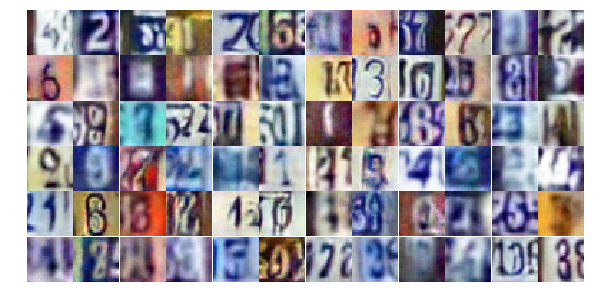

Epoch 25/25... Discriminator Loss: 0.7093... Generator Loss: 1.1612
Epoch 25/25... Discriminator Loss: 1.7809... Generator Loss: 0.3387


In [17]:
dataset = Dataset(trainset, testset)

losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

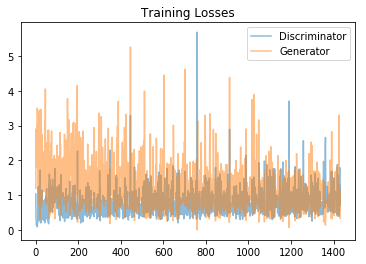

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

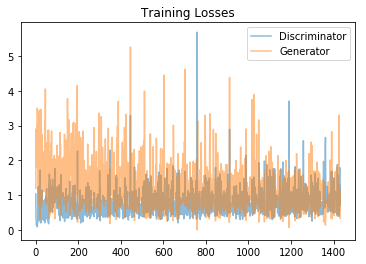

In [19]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

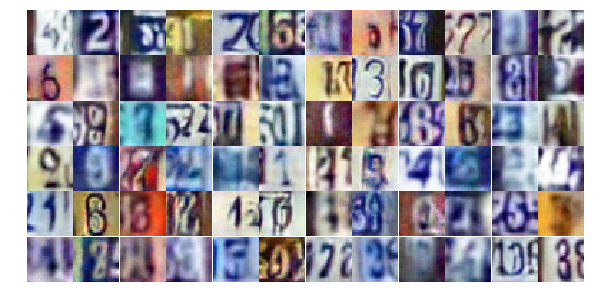

In [20]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

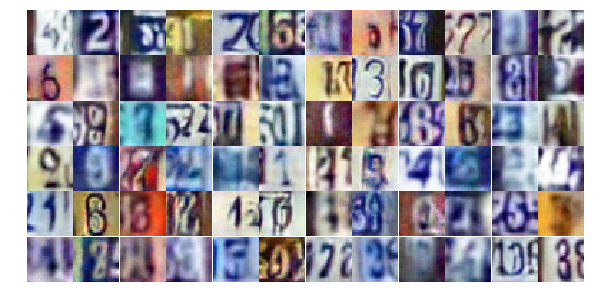

In [21]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))